In [1]:
volume = 198
arquivo = './band_structure/bandstructure_198.xml'.format(volume)

with open(arquivo,'r') as f:
    lines = f.readlines()

efermi = 0.0

In [1]:
import numpy as np
import matplotlib.pyplot as plt

In [3]:
bands = []
acquiring_curve = False
labels_points = []
labels_coords = []

for n, line in enumerate(lines):
    #get symmetry points labels and x coords
    if ('<vertex' in line):
        labels_coords.append(float(line.split('"')[1]))
        string = line.split('"')[7]
        if string == 'GAMMA':
            string = '$\Gamma$'
        labels_points.append(string)
    
    #get curves
    if '<band>' in lines[n-1]:
        acquiring_curve = True
        curve = []
        
    if '</band>'in line:
        acquiring_curve = False
        bands.append(curve)
        
    if acquiring_curve:
        x = line.split('"')[1]
        y = line.split('"')[3]
        curve.append([float(x), float(y)])

npbands = np.array(bands) 

NameError: name 'lines' is not defined

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


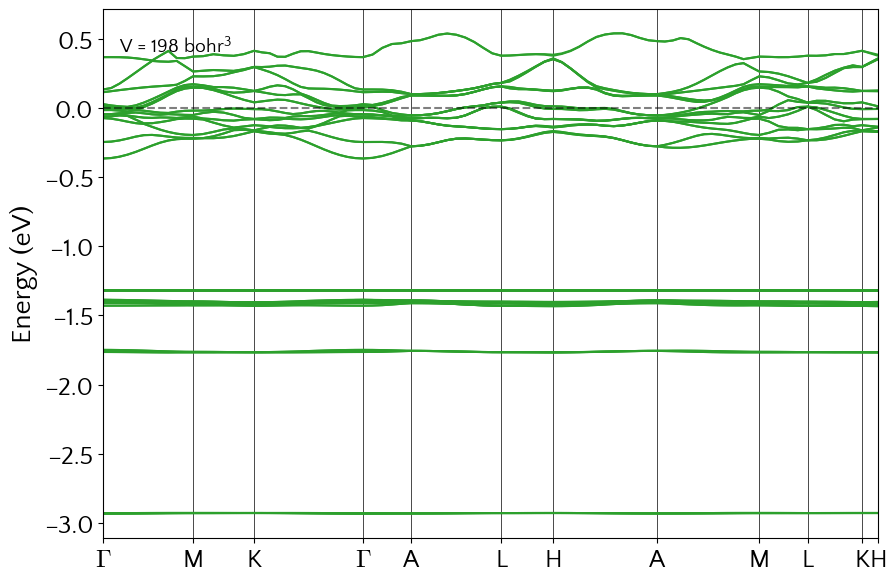

In [11]:
plt.rc('font', family='QuattroCento Sans')
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)
plt.rc('axes', labelsize=20)
plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )

fig = plt.figure(figsize=(10,7), dpi=100)
ax1 = fig.add_subplot()

#get x limits from data
xmin,xmax = npbands[0,0,0],npbands[0,-1,0]

#draw curves
for i in range(np.shape(npbands)[0]):
    ax1.plot(npbands[i,:,0], npbands[i,:,1], color='C2')

#get y limits for later
ymin,ymax = plt.ylim()
#ymin, ymax = -0.5, 0.9

#draw fermi level
ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
#ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
ax1.annotate('V = {0} bohr$^3$\n'.format(volume), 
             xycoords = 'axes fraction', xy=(0.02, 0.95),
             fontsize=14,
             horizontalalignment='left',
             verticalalignment='top')

#draw high symmetry lines
ax1.vlines(labels_coords, ymin, ymax, color='k', linewidth = 0.5)

#adjust limits
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
ax1.set_ylabel('Energy (eV)')

#set positions and labels of x axis
plt.xticks(labels_coords, labels = labels_points)

plt.savefig('bandstructure_{0}.pdf'.format(volume))
plt.show()

# Grafico composto

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


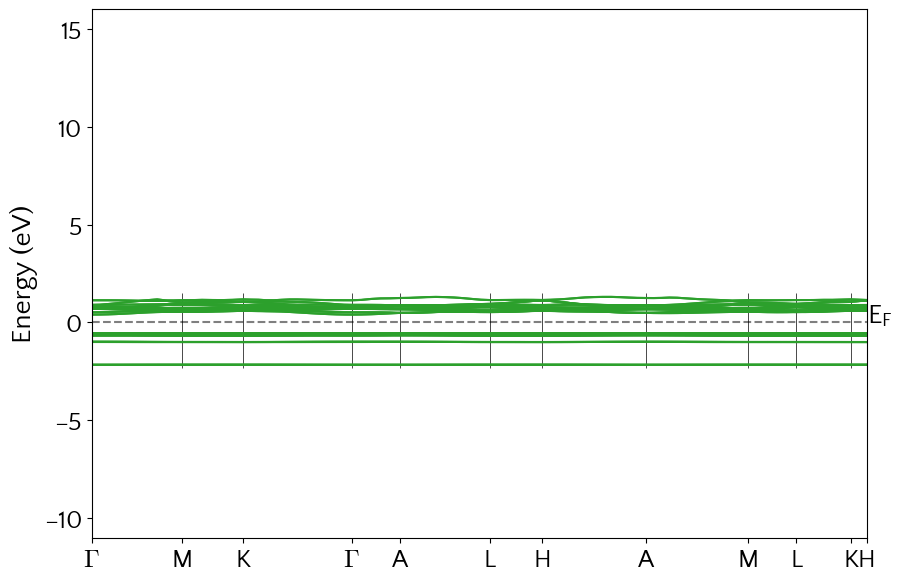

In [39]:
plt.rc('font', family='QuattroCento Sans')
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)
plt.rc('axes', labelsize=20)
plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )

fig = plt.figure(figsize=(10,7), dpi=100)
ax1 = fig.add_subplot()

#get x limits from data
xmin,xmax = npbands[0,0,0],npbands[0,-1,0]

#draw curves
for i in range(np.shape(npbands)[0]):
    ax1.plot(npbands[i,:,0], npbands[i,:,1], color='C2')

#get y limits for later
ymin,ymax = plt.ylim()

#draw fermi level
ax1.plot([xmin,xmax], [0,0], color='k', alpha = 0.5, linestyle = '--')
ax1.annotate('E$_\mathrm{F}$', xy = (xmax,0), fontsize=20)

#draw high symmetry lines
ax1.vlines(labels_coords, ymin, ymax, color='k', linewidth = 0.5)

#adjust limits
ax1.set_xlim(xmin, xmax)
#orbital f
ymin, ymax = -11,16
ax1.set_ylim(ymin, ymax)
ax1.set_ylabel('Energy (eV)')

#set positions and labels of x axis
plt.xticks(labels_coords, labels = labels_points)

plt.savefig(arquivo.split('.')[0]+'orbital_f.pdf')
plt.show()

# utilizando xml

In [1]:
import xml.etree.ElementTree as ET
def read_bands_Ldiff(volume):
    
    tree = ET.parse('./band_structure/bandstructure_{0}.xml'.format(volume))
    bandstrucutre = tree.getroot()
    bands = bandstrucutre.getchildren()[1].getchildren()[0].getchildren() #todas as bandas do 1o atomo
    
    #lista de dicionarios. Cada dicionario e uma banda
    lista_bandas = []
    for band in bands:
        distance = np.array([float(i.get('distance')) for i in band.getchildren()])
        energy = np.array([float(i.get('eval')) for i in band.getchildren()])
        suml = np.array([float(i.get('sum')) for i in band.getchildren()])
        inters = np.array([1-float(i.get('sum')) for i in band.getchildren()])
        s = np.array([float(i.getchildren()[0].get('character')) for i in band.getchildren()])
        p = np.array([float(i.getchildren()[1].get('character')) for i in band.getchildren()])
        d = np.array([float(i.getchildren()[2].get('character')) for i in band.getchildren()])
        f = np.array([float(i.getchildren()[3].get('character')) for i in band.getchildren()])
        banda = {'distance': np.array(distance),
                 'energy'  : np.array(energy),
                 'sum'     : np.array(suml),
                 'inters'  : np.array(inters),
                 's'       : np.array(s),
                 'p'       : np.array(p),
                 'd'       : np.array(d),
                 'f'       : np.array(f)}
        lista_bandas.append(banda)
    
        
    vertice_labels = []
    vertice_coords = []
    for vertice in bandstrucutre.findall('vertex'):
        vertice_coords.append(float(vertice.get('distance')))
        label = vertice.get('label')
        if label == 'GAMMA':
            label = '$\Gamma$'
        vertice_labels.append(label)
    return lista_bandas, vertice_coords, vertice_labels

No handles with labels found to put in legend.
findfont: Font family ['cursive'] not found. Falling back to DejaVu Sans.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


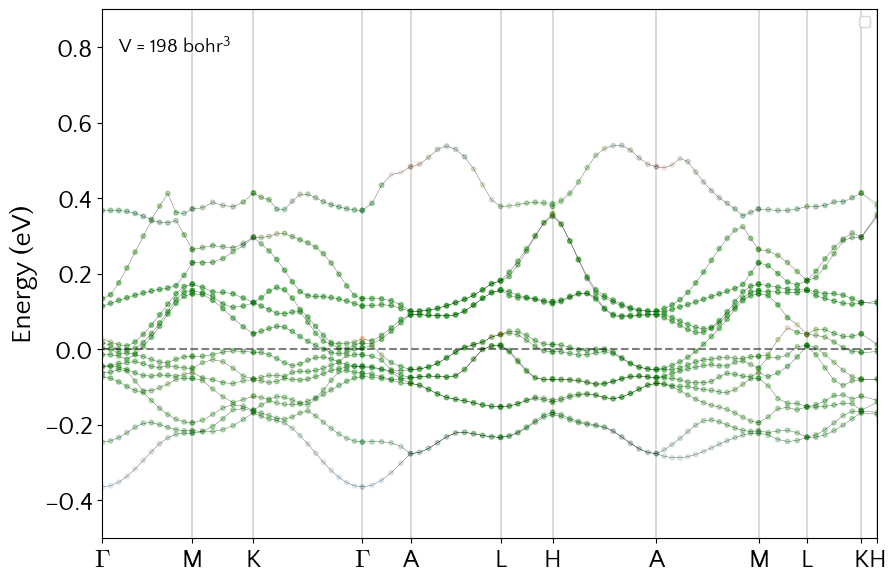

In [6]:
from matplotlib.colors import to_rgba_array, to_rgb
plt.rc('font', family='QuattroCento Sans')
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)
plt.rc('axes', labelsize=20)
plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )

efermi = 0.0
volume = 198

lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(volume)

fig = plt.figure(figsize=(10,7), dpi=100)
ax1 = fig.add_subplot()

#get x limits from data
xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]

#draw curves
for banda in lista_bandas:
    alpha_geral = 1.0
    tamanho_marcador = 10
    ax1.plot(banda['distance'], banda['energy'], color='k', lw=0.1)
    #orbital s
    r, g, b = to_rgb('C0')
    colors = [tuple([r,g,b,a]) for a in alpha_geral*banda['s']] #gera lista de tuplas com a cor e transparencia de cada ponto
    ax1.scatter(banda['distance'], banda['energy'], color=colors,s=tamanho_marcador)
    #orbital p
    r, g, b = to_rgb('C1')
    colors = [tuple([r,g,b,a]) for a in alpha_geral*banda['p']] #gera lista de tuplas com a cor e transparencia de cada ponto
    ax1.scatter(banda['distance'], banda['energy'], color=colors,s=tamanho_marcador)
    #orbital d
    r, g, b = to_rgb('C2')
    colors = [tuple([r,g,b,a]) for a in alpha_geral*banda['d']] #gera lista de tuplas com a cor e transparencia de cada ponto
    ax1.scatter(banda['distance'], banda['energy'], color=colors,s=tamanho_marcador)
    #orbital f
    r, g, b = to_rgb('C3')
    colors = [tuple([r,g,b,a]) for a in alpha_geral*banda['f']] #gera lista de tuplas com a cor e transparencia de cada ponto
    ax1.scatter(banda['distance'], banda['energy'], color=colors,s=tamanho_marcador)
    
    #intersticial
    #r, g, b = to_rgb('C4')
    #colors = [tuple([r,g,b,a]) for a in alpha_geral*banda['inters']] #gera lista de tuplas com a cor e transparencia de cada ponto
    #ax1.scatter(banda['distance'], banda['energy'], color=colors,s=tamanho_marcador)
ax1.legend()
#get y limits for later
ymin,ymax = plt.ylim()
ymin, ymax = -0.5, 0.9

#draw fermi level
ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
#ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
ax1.annotate('V = {0} bohr$^3$\n'.format(volume), 
             xycoords = 'axes fraction', xy=(0.02, 0.95),
             fontsize=14,
             horizontalalignment='left',
             verticalalignment='top')

#draw high symmetry lines
ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)

#adjust limits
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
ax1.set_ylabel('Energy (eV)')

#set positions and labels of x axis
plt.xticks(vertice_coords, labels = vertice_labels)

plt.show()

## Varying line thickness

In [6]:
from matplotlib.colors import to_rgba_array, to_rgb
import matplotlib.pyplot as plt
import numpy as np

def plot_bandstructure(volume, l_resolved = True):
    
    lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(volume)
    
    
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    efermi = 0.0
    
    fig = plt.figure(figsize=(10,7), dpi=100)
    
    ax1 = fig.add_subplot()
    
    #get x limits from data
    xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]
    
    ##### Diferenciando L
    #draw curves
    if l_resolved:
        for banda in lista_bandas:
            alpha_geral = 0.1
            multiplier = 0.08
            ax1.plot(banda['distance'], banda['energy'], color='k', lw=0.1, alpha=0.5)
            orbitals = ['s', 'p', 'd', 'f']
            colors = ['C0', 'C1', 'C3', 'C2', 'C4']
            for i in range(len(orbitals)):
                l = ax1.fill_between(banda['distance'],
                                      banda['energy']+multiplier*banda[orbitals[i]],
                                      banda['energy']-multiplier*banda[orbitals[i]],
                                      color=colors[i], alpha = alpha_geral, lw=0.0)
        
        for i in range(len(orbitals)):
                l = ax1.fill_between([-1], [1],[0], color=colors[i], alpha = 0.5, label=orbitals[i])
        ax1.legend(loc=0, ncol=2)
        
    else: #SEM DIFERENCA ENTRE L
        for banda in lista_bandas:
            ax1.plot(banda['distance'], banda['energy'], color='C2', lw=1.5, alpha=0.3)
            
    ################################
    #get y limits for later
    ymin,ymax = plt.ylim()
    #ymin, ymax = -0.38, 0.2
    
    
    #draw fermi level
    ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    ax1.annotate('V = {0} bohr$^3$\n'.format(volume), 
                 xycoords = 'axes fraction', xy=(0.02, 0.95),
                 fontsize=14,
                 horizontalalignment='left',
                 verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (eV)')
    
    #set positions and labels of x axis
    plt.xticks(vertice_coords, labels = vertice_labels)
    #plt.savefig('bandstructure_{0}.pdf'.format(volume), transparent=True)
    
    plt.show()

findfont: Font family ['cursive'] not found. Falling back to DejaVu Sans.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


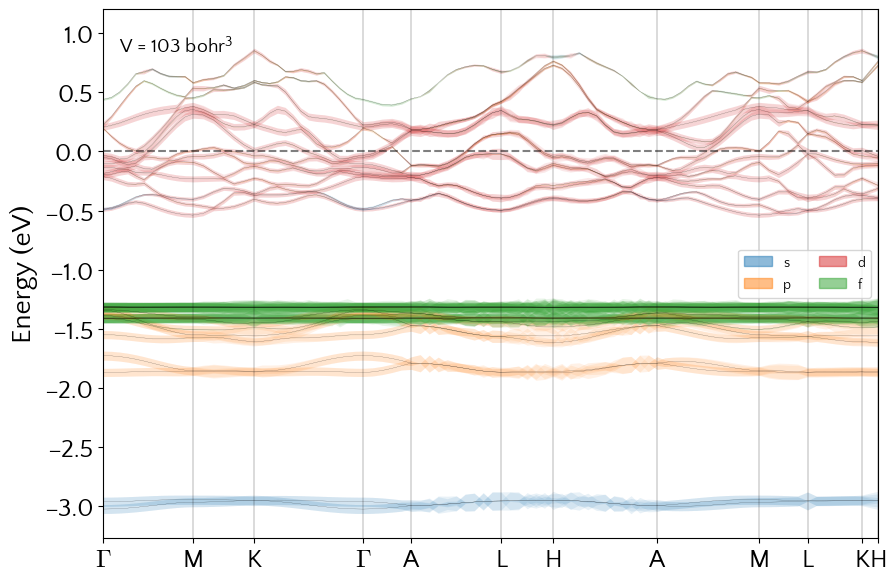

In [7]:
plot_bandstructure(103)

In [3]:
from matplotlib.colors import to_rgba_array, to_rgb

def plot_bandstructure_several_volumes(volumes, l_resolved = True):
    
    
    
    
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    efermi = 0.0
    N = len(volumes)
    
    fig = plt.figure(figsize=(10,4*N), dpi=100)
    
    #PLOT FIRST VOLUME
    ax0 = fig.add_subplot(N,1,N)
    
    lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(volumes[0])
    
    #get x limits from data
    xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]
    
    ##### Diferenciando L
    #draw curves
    if l_resolved:
        for banda in lista_bandas:
            alpha_geral = 0.35
            multiplier = 0.12
            ax0.plot(banda['distance'], banda['energy'], color='grey', lw=0.1, alpha=0.3)
            orbitals = ['s', 'p', 'd', 'f']
            colors = ['C0', 'C3', 'lightgrey', 'C2', 'C4']
            for i in range(len(orbitals)):
                l = ax0.fill_between(banda['distance'],
                                      banda['energy']+multiplier*banda[orbitals[i]],
                                      banda['energy']-multiplier*banda[orbitals[i]],
                                      color=colors[i], alpha = alpha_geral, lw=0.0)
        
        for i in range(len(orbitals)):
                l = ax0.fill_between([-1], [1],[0], color=colors[i], alpha = alpha_geral, label=orbitals[i])
        ax0.legend(loc=1, ncol=4, fontsize=14)
        
    else: #SEM DIFERENCA ENTRE L
        for banda in lista_bandas:
            ax0.plot(banda['distance'], banda['energy'], color='C2', lw=1.5, alpha=0.3)    
    ################################
    #get y limits for later
    ymin,ymax = plt.ylim()
    ymin, ymax = -0.8, 1.4
    #draw fermi level
    ax0.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    ax0.annotate('V = {0} Bohr$^3$\n'.format(volumes[0]), 
                 xycoords = 'axes fraction', xy=(0.02, 0.95),
                 fontsize=16,
                 horizontalalignment='left',
                 verticalalignment='top')
    #draw high symmetry lines
    ax0.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
    #adjust limits
    ax0.set_xlim(xmin, xmax)
    ax0.set_ylim(ymin, ymax)
    #set positions and labels of x axis
    plt.xticks(vertice_coords, labels = vertice_labels)

    
    #LOOP THROUGH THE REST OF VOLUMES, IF AVAILABLE
    if N > 1:
        for n in range(1,N):
            volume = volumes[n]
            lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(volume)
            ax1 = fig.add_subplot(N,1,N-n)
            #get x limits from data
            xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]
            
            ##### Diferenciando L
            #draw curves
            if l_resolved:
                for banda in lista_bandas:
                    ax1.plot(banda['distance'], banda['energy'], color='grey', lw=0.1, alpha=0.3)
                    for i in range(len(orbitals)):
                        l = ax1.fill_between(banda['distance'],
                                              banda['energy']+multiplier*banda[orbitals[i]],
                                              banda['energy']-multiplier*banda[orbitals[i]],
                                              color=colors[i], alpha = alpha_geral, lw=0.0)
                
                for i in range(len(orbitals)):
                        l = ax1.fill_between([-1], [1],[0], color=colors[i], alpha = alpha_geral, label=orbitals[i])
                ax1.legend(loc=1, ncol=4, fontsize=14)
                
            else: #SEM DIFERENCA ENTRE L
                for banda in lista_bandas:
                    ax1.plot(banda['distance'], banda['energy'], color='C2', lw=1.5, alpha=0.3)    
            ################################
            #get y limits for later
            #ymin,ymax = plt.ylim()
            ymin, ymax = -0.8, 1.4
            #draw fermi level
            ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
            #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
            ax1.annotate('V = {0} Bohr$^3$\n'.format(volume), 
                         xycoords = 'axes fraction', xy=(0.02, 0.95),
                         fontsize=16,
                         horizontalalignment='left',
                         verticalalignment='top')
            #draw high symmetry lines
            ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
            #adjust limits
            ax1.set_xlim(xmin, xmax)
            ax1.set_ylim(ymin, ymax)
            #ax1.set_ylabel('Energy (eV)')
            ax1.set_xticks([])
            #plt.setp(ax1.get_xticklabels(), visible=False)
    fig.text(0.02, 0.5, 'Energy (Ha)', va='center', rotation='vertical', fontsize = 20)
    plt.subplots_adjust(hspace=.02)
    #plt.tight_layout()
    plt.savefig('bandstructure_panels_'+'_'.join([str(v) for v in volumes])+'.pdf', bbox_inches='tight')
    plt.show()

findfont: Font family ['cursive'] not found. Falling back to DejaVu Sans.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


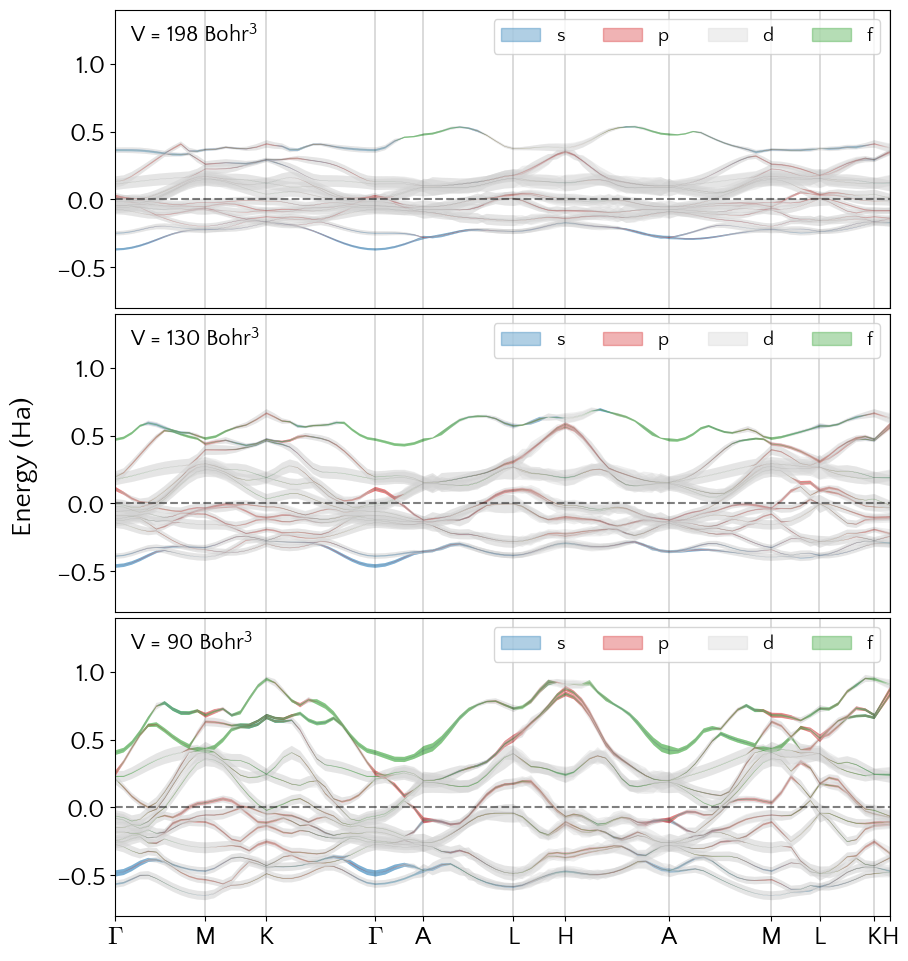

In [4]:
plot_bandstructure_several_volumes([90, 130, 198])

# GIF resolvido em $\ell$

In [7]:
from matplotlib.colors import to_rgba_array, to_rgb

def plot_bandstructure_gif(volume, l_resolved = True):
    
    lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(volume)
    
    
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    efermi = 0.0
    ymin = -3.2
    ymax = 1.4
    
    fig = plt.figure(figsize=(10,7), dpi=200)
    ax1 = fig.add_subplot()
    
    #get x limits from data
    xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]
    
    ##### Diferenciando L
    #draw curves
    if l_resolved:
        for banda in lista_bandas:
            alpha_geral = 0.2
            multiplier = 0.08
            ax1.plot(banda['distance'], banda['energy'], color='k', lw=0.1, alpha=0.5)
            orbitals = ['s', 'p', 'd', 'f']
            colors = ['C0', 'C1', 'C3', 'C2', 'C4']
            for i in range(len(orbitals)):
                l = ax1.fill_between(banda['distance'],
                                      banda['energy']+multiplier*banda[orbitals[i]],
                                      banda['energy']-multiplier*banda[orbitals[i]],
                                      color=colors[i], alpha = alpha_geral, lw=0.0)
        
        for i in range(len(orbitals)):
                l = ax1.fill_between([-1], [1],[0], color=colors[i], alpha = 0.5, label=orbitals[i])
        ax1.legend(loc='upper right', ncol=2)
        
    else: #SEM DIFERENCA ENTRE L
        for banda in lista_bandas:
            ax1.plot(banda['distance'], banda['energy'], color='k', lw=1.0, alpha=0.6)
            
    ################################
    #get y limits for later
    #ymin,ymax = plt.ylim()
    #ymin, ymax = -0.5, 0.9
    
    
    #draw fermi level
    ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    ax1.annotate('V = {0} bohr$^3$\n'.format(volume), 
                 xycoords = 'axes fraction', xy=(0.02, 0.95),
                 fontsize=14,
                 horizontalalignment='left',
                 verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (Ha)')
    
    #set positions and labels of x axis
    plt.xticks(vertice_coords, labels = vertice_labels)
    plt.savefig('bandstructure_{0}.pdf'.format(volume))
    
    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    return image

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a 

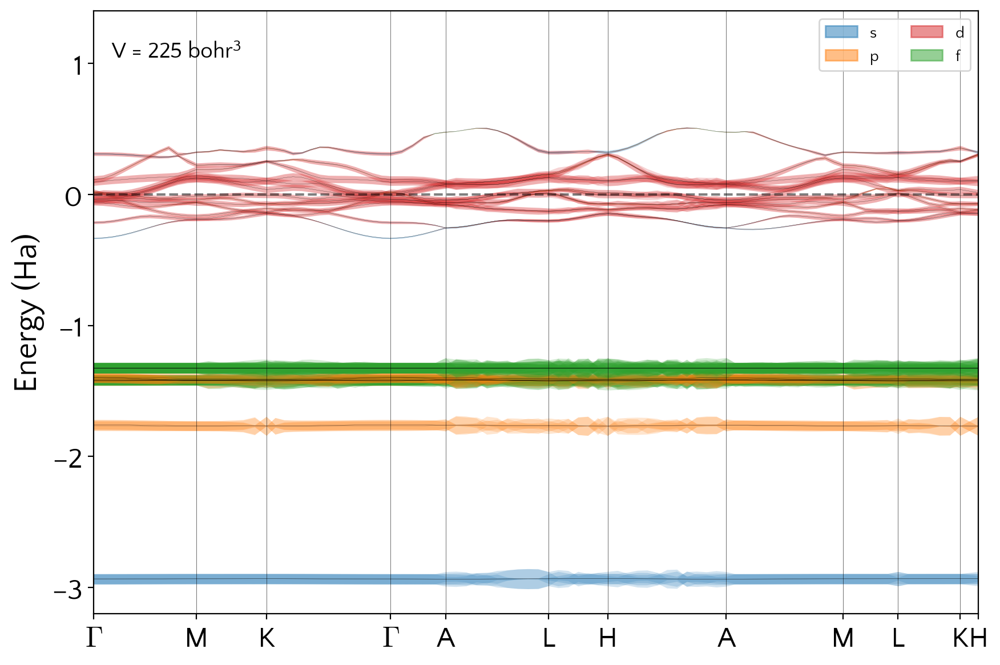

Substituting with a symbol from Computer Modern.


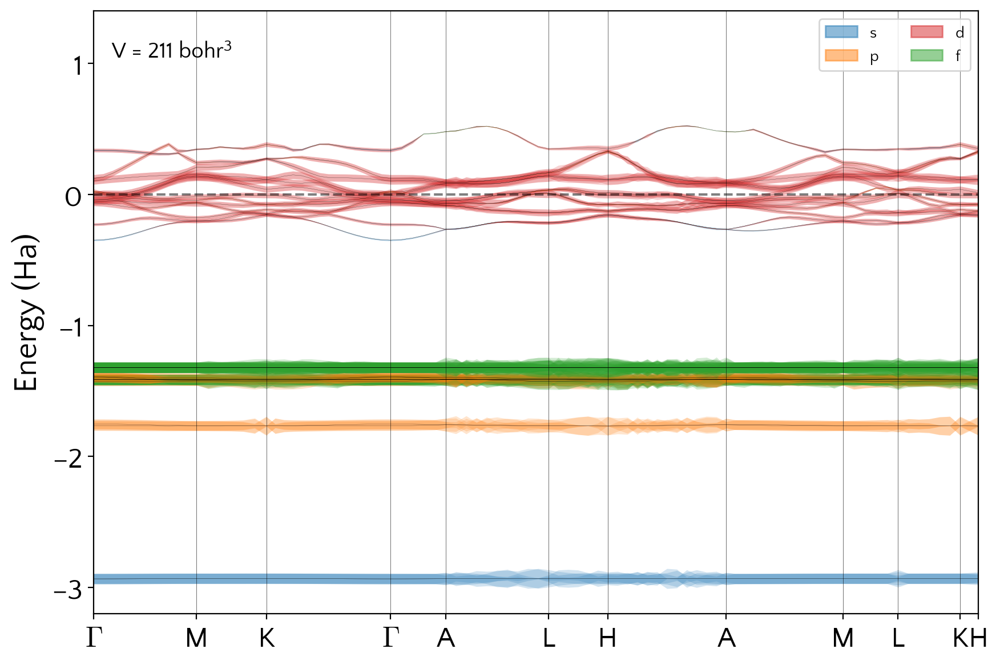

Substituting with a symbol from Computer Modern.


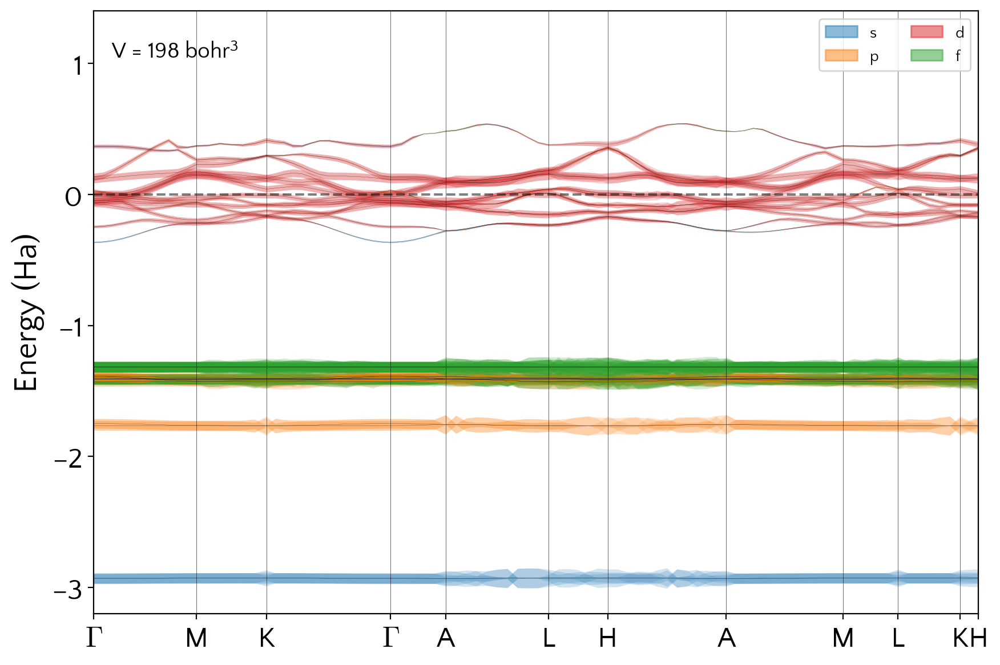

Substituting with a symbol from Computer Modern.


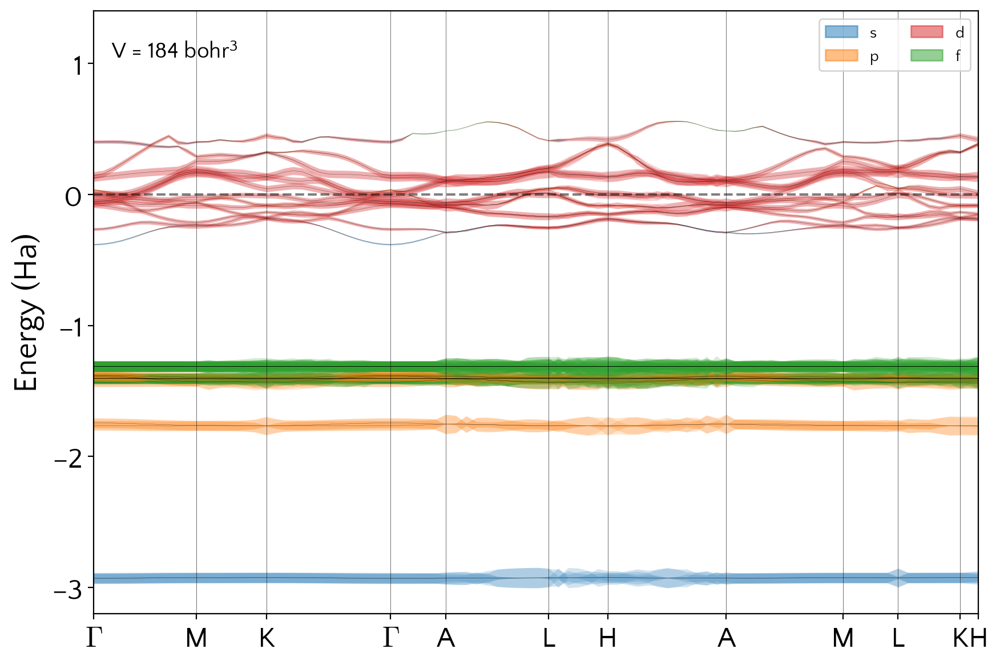

Substituting with a symbol from Computer Modern.


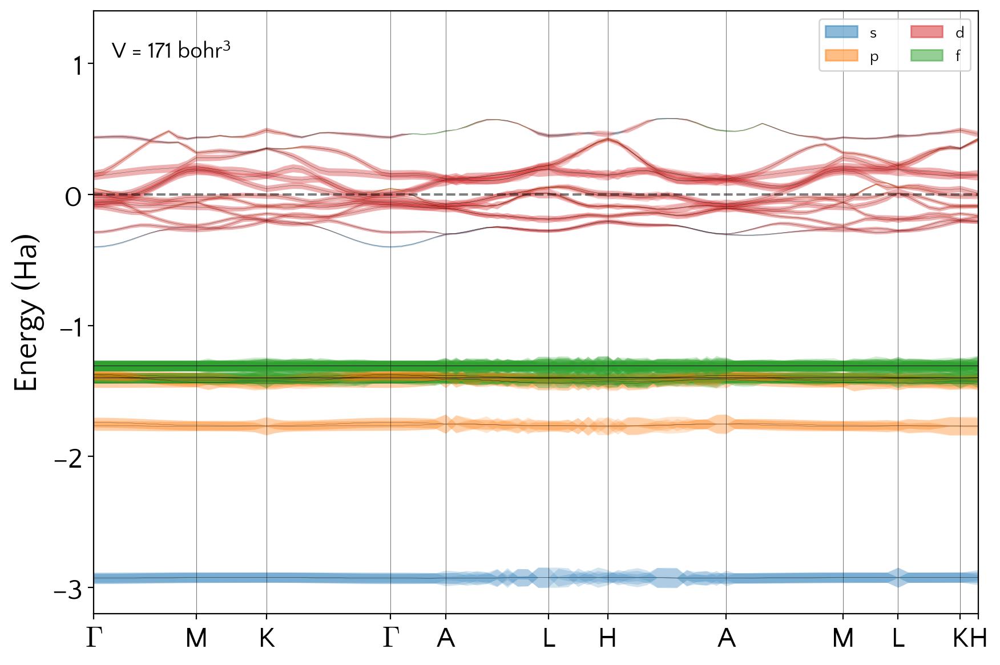

Substituting with a symbol from Computer Modern.


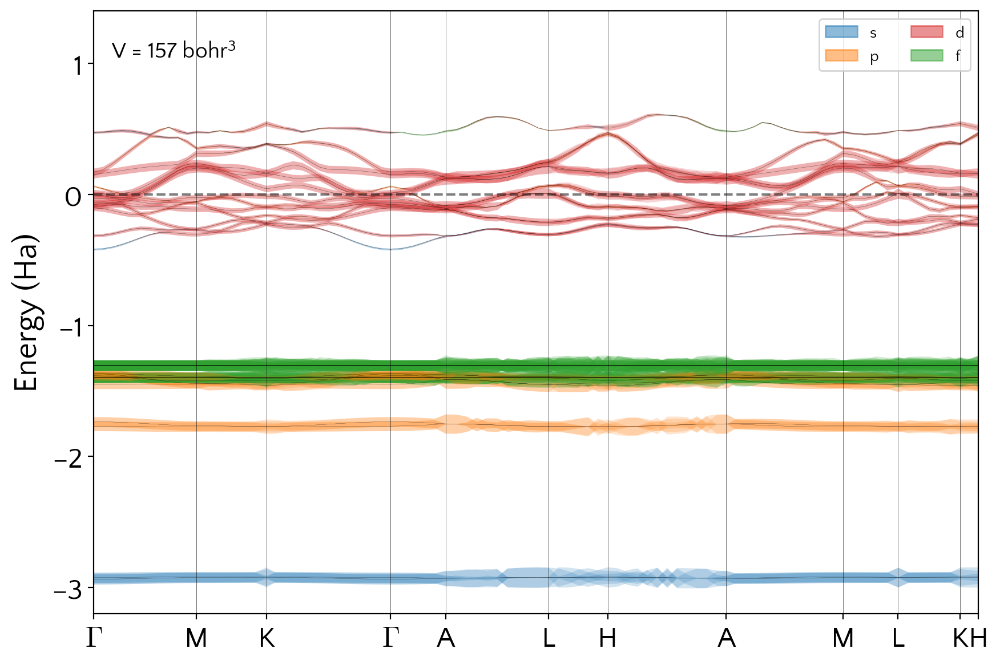

Substituting with a symbol from Computer Modern.


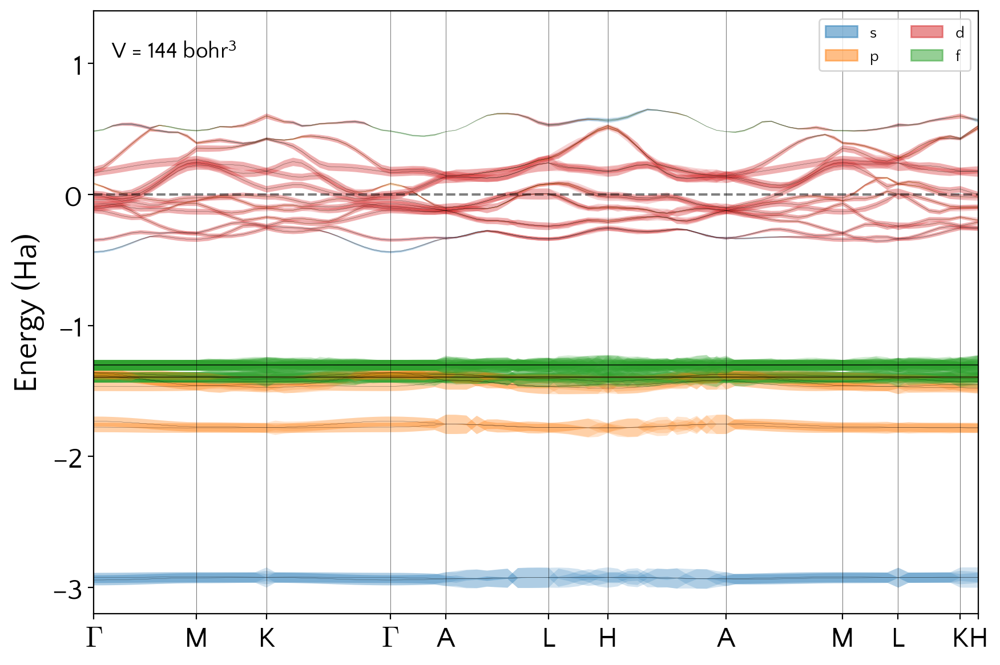

Substituting with a symbol from Computer Modern.


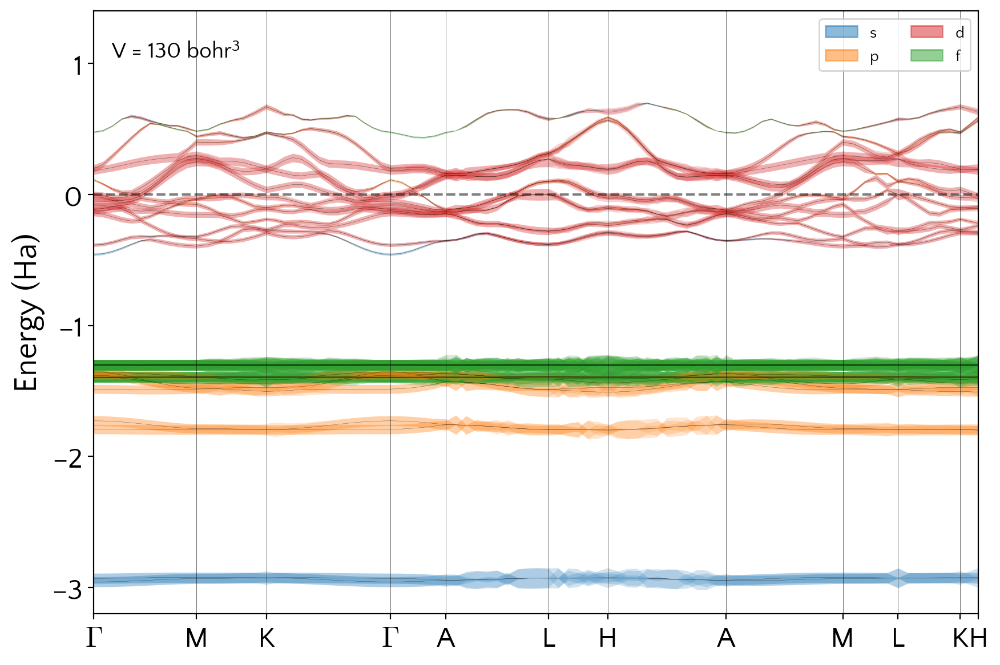

Substituting with a symbol from Computer Modern.


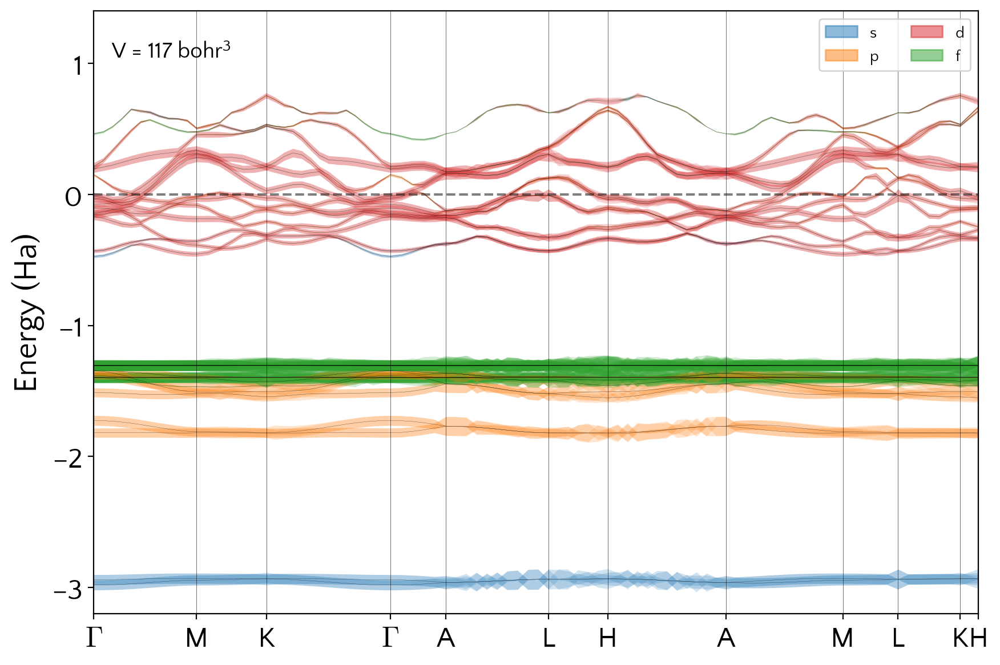

Substituting with a symbol from Computer Modern.


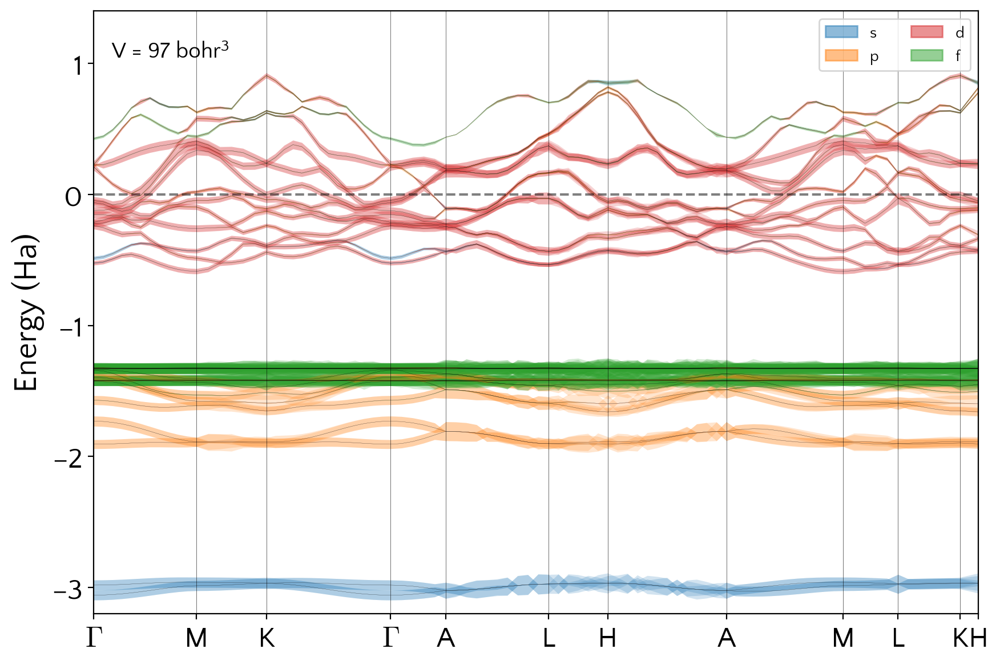

Substituting with a symbol from Computer Modern.


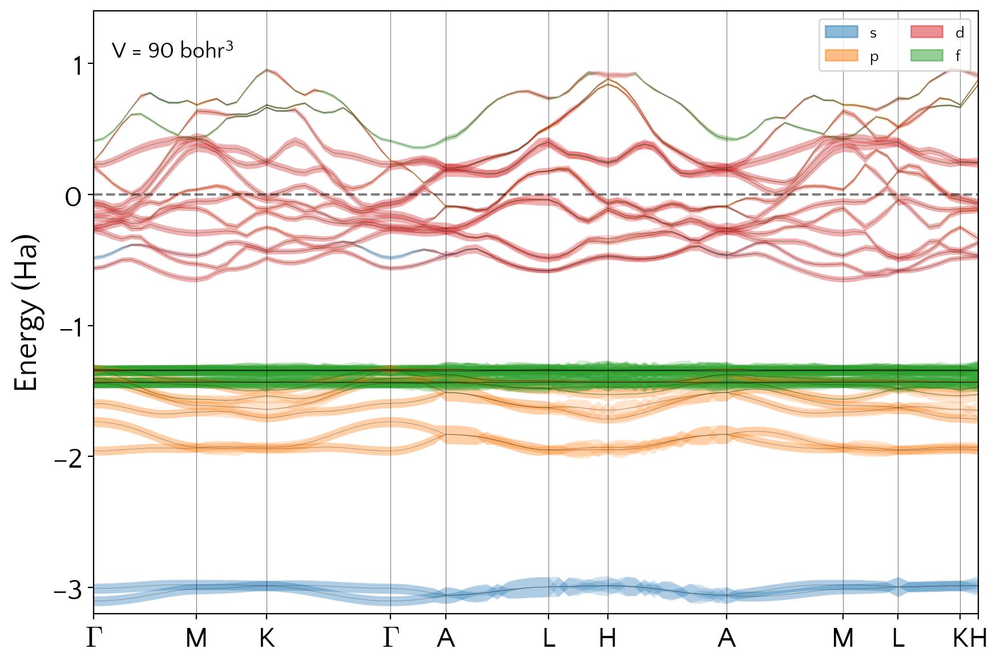

In [8]:
import imageio
Volumes = [225, 211, 198, 184, 171, 157, 144, 130, 117, 97, 90]
imageio.mimsave('./bands_ellresolved.gif', [plot_bandstructure_gif(i) for i in Volumes], fps=0.75)

In [22]:
from matplotlib.colors import to_rgba_array, to_rgb

def plot_bandstructure_gif2(volume, l_resolved = True):
    
    lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(volume)
    
    
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    efermi = 0.0
    ymin = -3.2
    ymax = 1.4
    
    fig = plt.figure(figsize=(10,7), dpi=200)
    ax1 = fig.add_subplot()
    
    #get x limits from data
    xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]
    
    ##### Diferenciando L
    #draw curves
    if l_resolved:
        for banda in lista_bandas:
            alpha_geral = 0.2
            multiplier = 0.08
            ax1.plot(banda['distance'], banda['energy'], color='k', lw=0.1, alpha=0.5)
            plt.errorbar(x=banda['distance'], y=banda['energy'], yerr=multiplier*banda['inters'],color='grey',
                         lw=0.1, alpha=0.1, elinewidth=2.0, fmt='none')
            orbitals = ['s', 'p', 'd', 'f']
            colors = ['C0', 'C1', 'C3', 'C2', 'C4']
            for i in range(len(orbitals)):
                l = ax1.fill_between(banda['distance'],
                                      banda['energy']+multiplier*banda[orbitals[i]],
                                      banda['energy']-multiplier*banda[orbitals[i]],
                                      color=colors[i], alpha = alpha_geral, lw=0.0)

        for i in range(len(orbitals)):
                l = ax1.fill_between([-1], [1],[0], color=colors[i], alpha = 0.5, label=orbitals[i])
        ax1.legend(loc='upper right', ncol=2)
        
    else: #SEM DIFERENCA ENTRE L
        for banda in lista_bandas:
            ax1.plot(banda['distance'], banda['energy'], color='k', lw=1.0, alpha=0.6)
            
    ################################
    #get y limits for later
    #ymin,ymax = plt.ylim()
    #ymin, ymax = -0.5, 0.9
    
    
    #draw fermi level
    ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    ax1.annotate('V = {0} bohr$^3$\n'.format(volume), 
                 xycoords = 'axes fraction', xy=(0.02, 0.95),
                 fontsize=14,
                 horizontalalignment='left',
                 verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (Ha)')
    
    #set positions and labels of x axis
    plt.xticks(vertice_coords, labels = vertice_labels)
    #plt.savefig('bandstructure_{0}.pdf'.format(volume))
    #plt.show()
    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    return image
    
#plot_bandstructure_gif2(198)

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


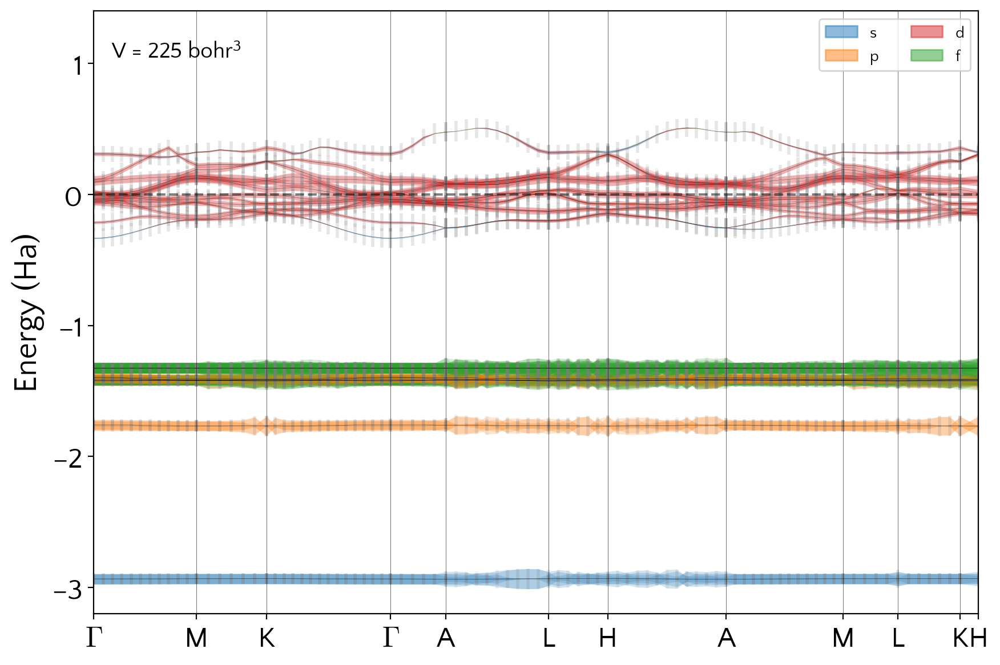

Substituting with a symbol from Computer Modern.


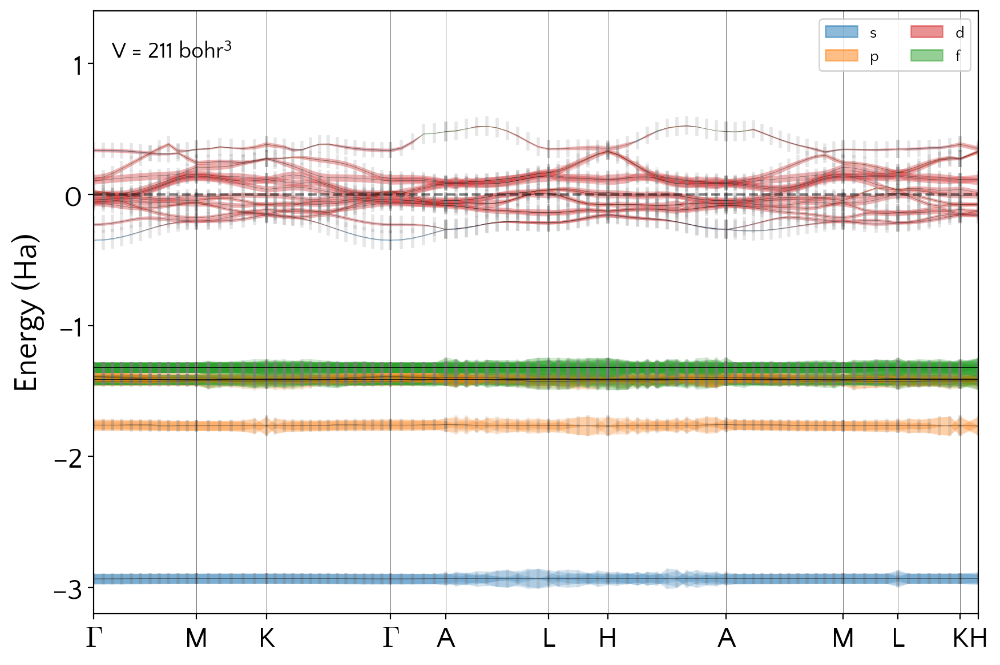

Substituting with a symbol from Computer Modern.


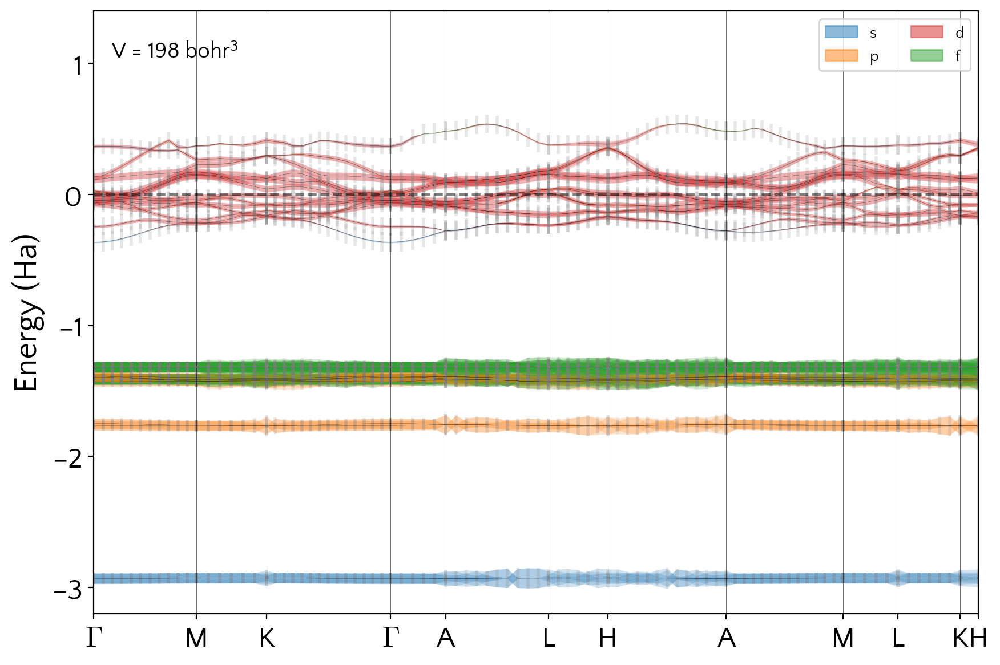

Substituting with a symbol from Computer Modern.


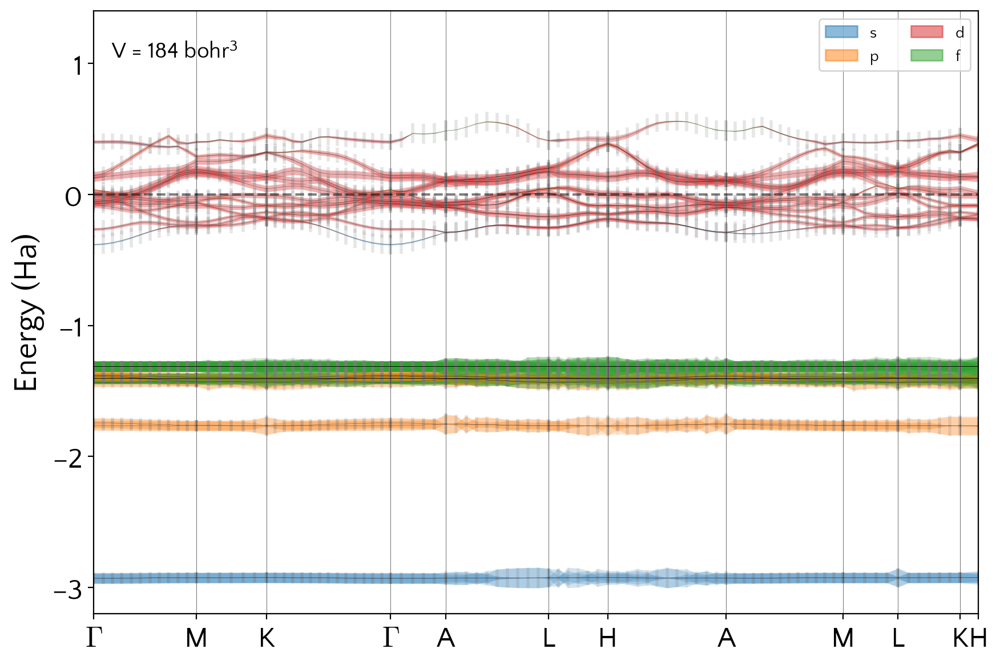

Substituting with a symbol from Computer Modern.


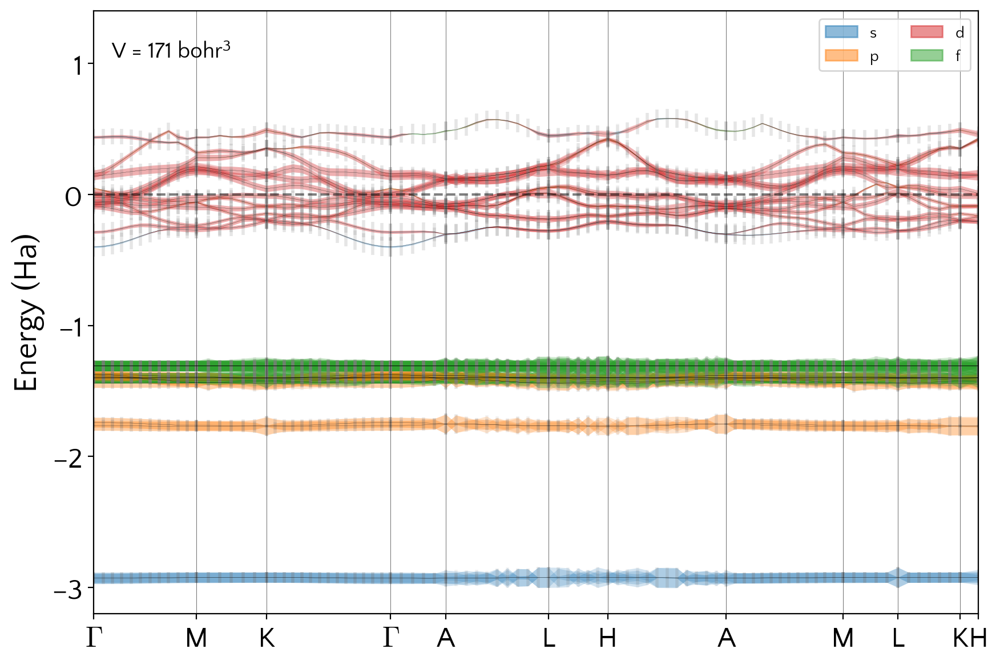

Substituting with a symbol from Computer Modern.


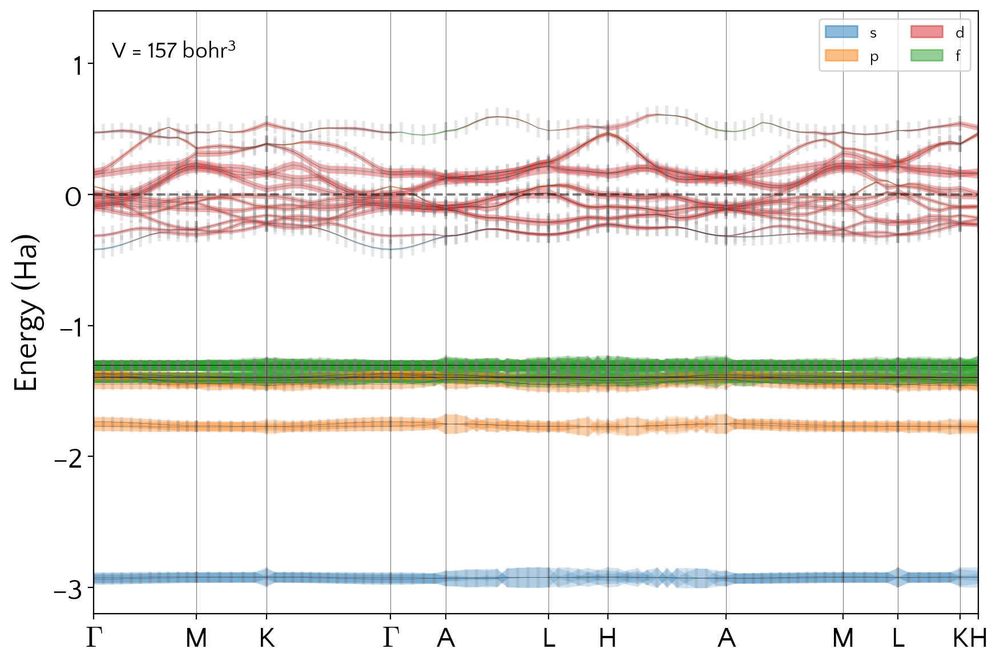

Substituting with a symbol from Computer Modern.


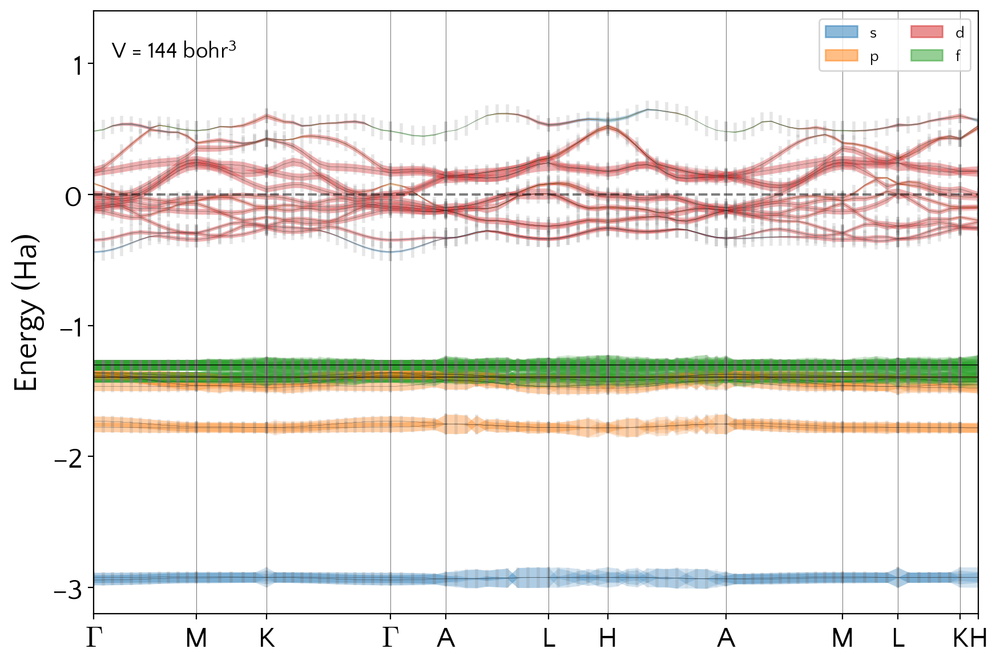

Substituting with a symbol from Computer Modern.


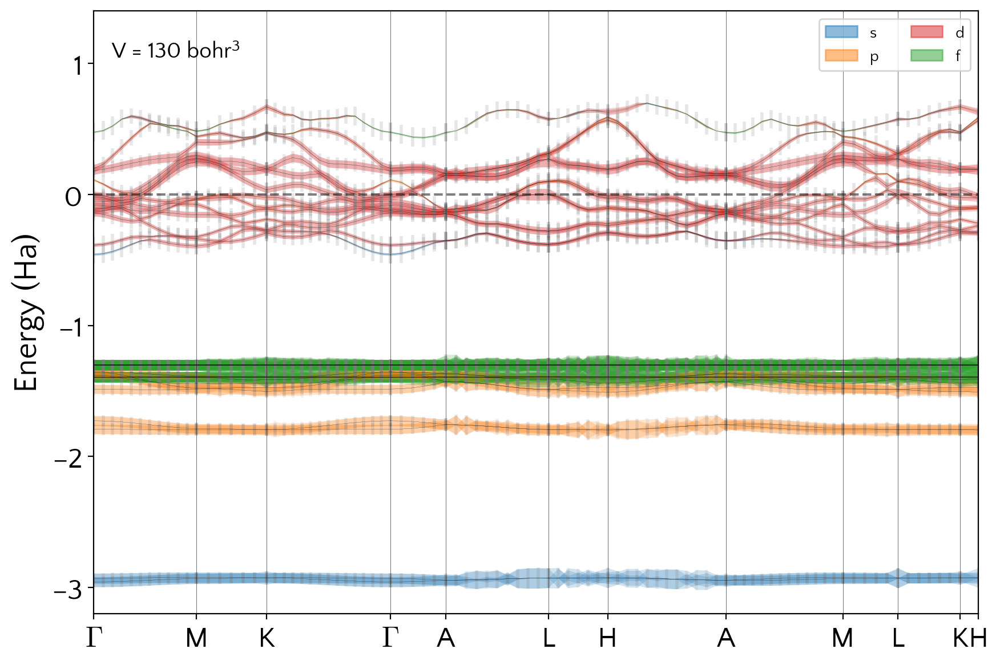

Substituting with a symbol from Computer Modern.


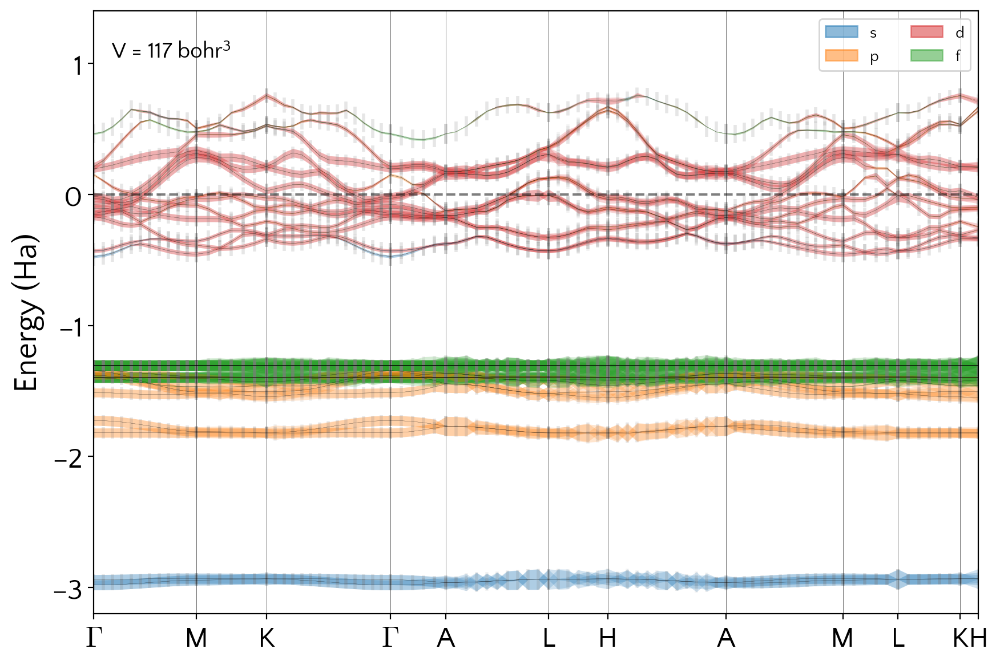

Substituting with a symbol from Computer Modern.


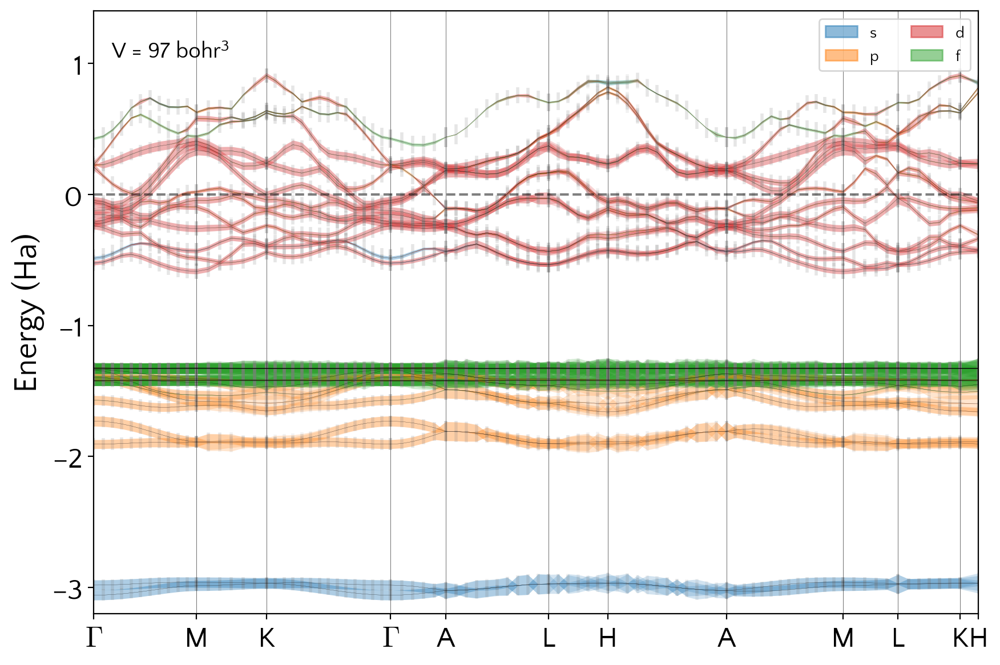

Substituting with a symbol from Computer Modern.


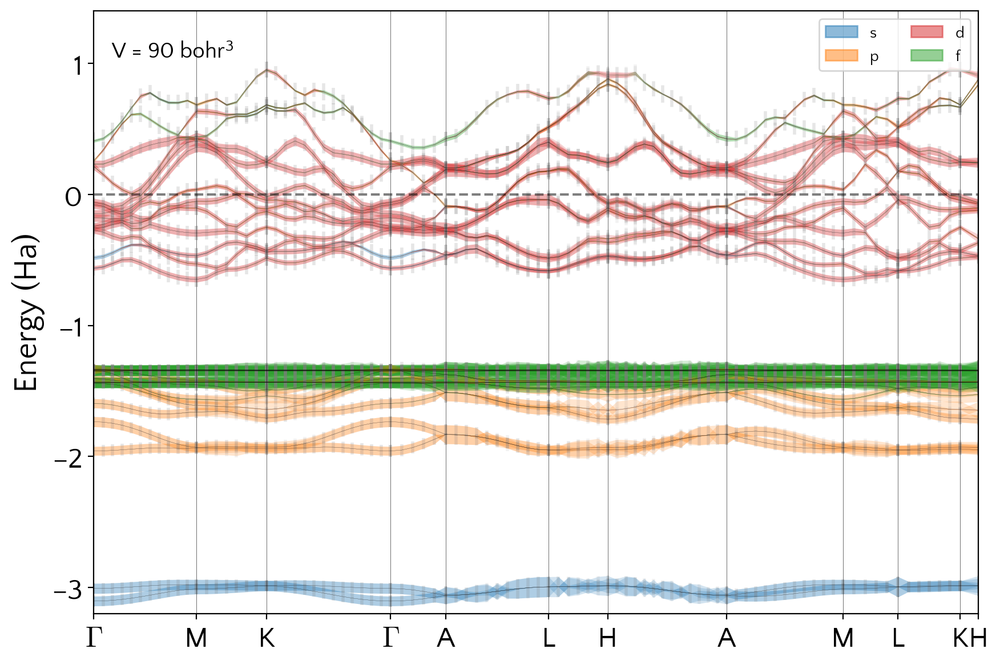

In [23]:
import imageio
Volumes = [225, 211, 198, 184, 171, 157, 144, 130, 117, 97, 90]
imageio.mimsave('./bands_ellresolved_inters.gif', [plot_bandstructure_gif2(i) for i in Volumes], fps=0.75)

# Comparação de bandas em torno do minimo de c/a

In [13]:
from matplotlib.colors import to_rgba_array, to_rgb

def plot_bandstructure_volumes(volumes):
    
    
    
    
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    efermi = 0.0
    
    fig = plt.figure(figsize=(10,7), dpi=100)
    ax1 = fig.add_subplot()
    
    #All the curves have to use the same x vector for us to be able to compare them.
    #The increase in pressure expands the 1rst brillouin and alters the location points, which are 
    #given in reciprocal lenght units. Using the same x vector for all the curves is equivalent to
    #use inverse cristallographic coordinates, which would be iinvariant under the change in volume of 
    #the 1BZ
    colors = ['C0','C3', 'C2', 'C2', 'C4']
    
    lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(volumes[0])
    common_x_vector = lista_bandas[0]['distance']
    #get x limits from data
    xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]
    
    
    for n,volume in enumerate(volumes):
        lista_bandas, vertice_coords_dump, vertice_labels_dump = read_bands_Ldiff(volume) #we dont need to store the vertices coordinates
        
        
        ##### Diferenciando L
        #draw curves
        for banda in lista_bandas:
            l = ax1.plot(common_x_vector, banda['energy'], color = colors[n], lw=1.5, alpha=0.4)
        l[0].set_label('{0} Bohr$^3$'.format(volume))
                
    ################################
    #get y limits for later
    ymin,ymax = plt.ylim()
    ymin, ymax = -0.7, 0.9
    
    
    #draw fermi level
    ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    #ax1.annotate('V = {0} bohr$^3$\n'.format(volume), 
    #             xycoords = 'axes fraction', xy=(0.02, 0.95),
    #             fontsize=14,
    #             horizontalalignment='left',
    #             verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (Ha)')
    ax1.legend()
    
    #set positions and labels of x axis
    plt.xticks(vertice_coords, labels = vertice_labels)
    plt.savefig('bandstructure_90_198.pdf'.format(volume))
    plt.show()

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


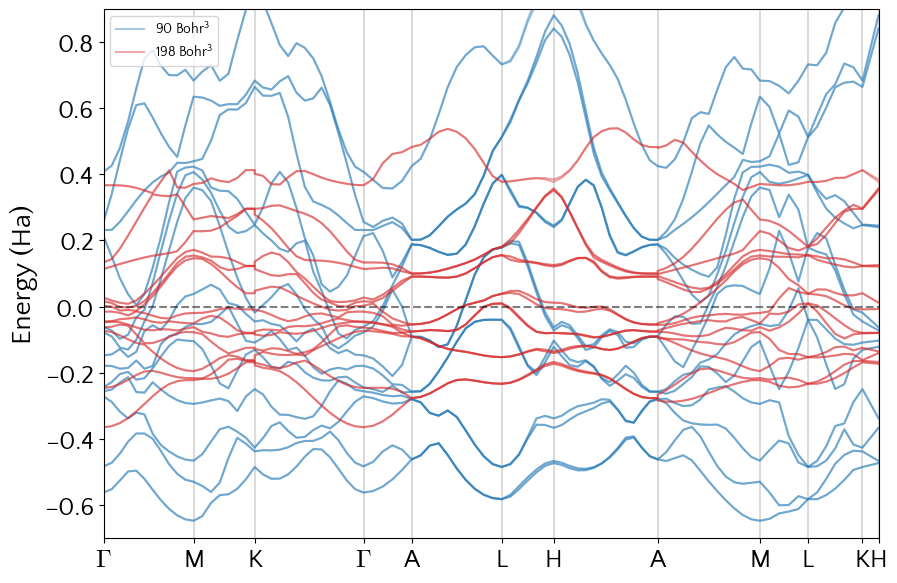

In [14]:
plot_bandstructure_volumes([90,198])

# Cada banda, individualmente, para os 3 volumes


Claudio A. Perottoni
9:54 AM (3 hours ago)
to me

Está difícil de acompanhar as bandas individualmente. Podes fazer gráficos separados, um para cada banda, nos três volumes? Assim podemos ver se há cruzamento de bandas em algum ponto.
Cláudio

In [63]:
import matplotlib.colors as colors
import matplotlib.cm as cmx

def plot_bandstructure_volumes_individuais(volumes):
    
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    efermi = 0.0
    
    #All the curves have to use the same x vector for us to be able to compare them.
    #The increase in pressure expands the 1rst brillouin and alters the location points, which are 
    #given in reciprocal lenght units. Using the same x vector for all the curves is equivalent to
    #use inverse cristallographic coordinates, which would be iinvariant under the change in volume of 
    #the 1BZ
    cores = ['C0','C0','C3', 'C2', 'C2', 'C4']
    
    #USAR MAPA DE COR PARA OS VOLUMES
    jet = plt.get_cmap('viridis') 
    cNorm  = colors.Normalize(vmin=min(volumes), vmax=max(volumes))
    scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
    print(scalarMap.get_clim()) 
    ####################################
    
    
    lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(volumes[0])
    common_x_vector = lista_bandas[0]['distance']
    #get x limits from data
    xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]
    
    lista_volumes_bands = []
    for volume in volumes:
        lista_bandas, vertice_coords_dump, vertice_labels_dump = read_bands_Ldiff(volume)
        lista_volumes_bands.append(lista_bandas)
    
    #draw curves
    for n in range(len(lista_bandas)):
        fig = plt.figure(figsize=(10,7))
        ax1 = fig.add_subplot()
        for i,volume in enumerate(volumes):
            colorVal = scalarMap.to_rgba(volume)
            ax1.plot(common_x_vector, lista_volumes_bands[i][n]['energy'],
                    color = colorVal, lw=2.0, label ='{0} Bohr$^3$'.format(volume), alpha=0.8)
            
        ymin,ymax = plt.ylim()
        ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')        
        #draw high symmetry lines
        ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
    
        #adjust limits
        ax1.set_xlim(xmin, xmax)
        ax1.set_ylim(ymin, ymax)
        ax1.set_ylabel('Energy (eV)')
        ax1.legend(fontsize=12)
    
        #set positions and labels of x axis
        plt.xticks(vertice_coords, labels = vertice_labels)
        plt.title('Band #{0}'.format(n))
        plt.tight_layout()
        plt.savefig('./individual_bands2/bandstructure_157_225_{0}.png'.format(n), dpi=120)
        plt.show()

(117.0, 225.0)


Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


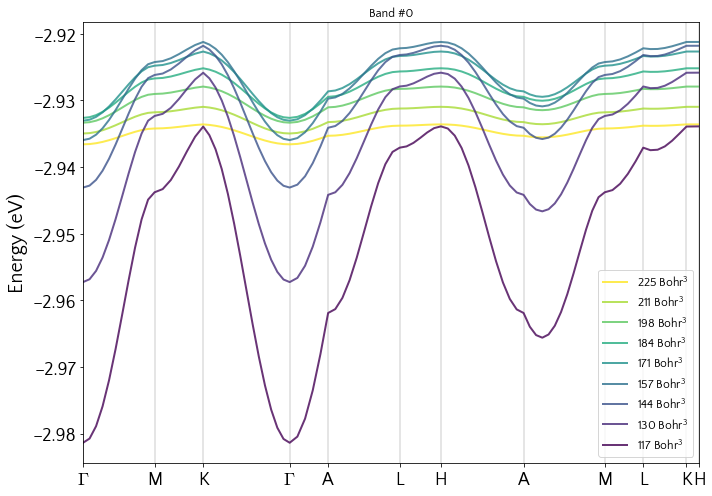

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


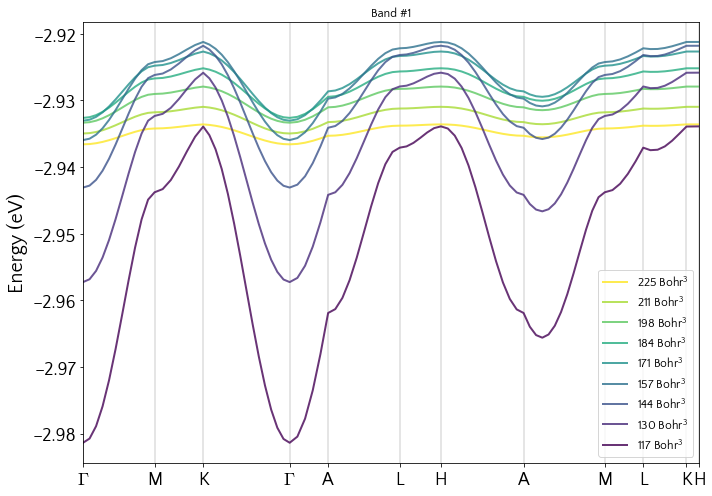

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


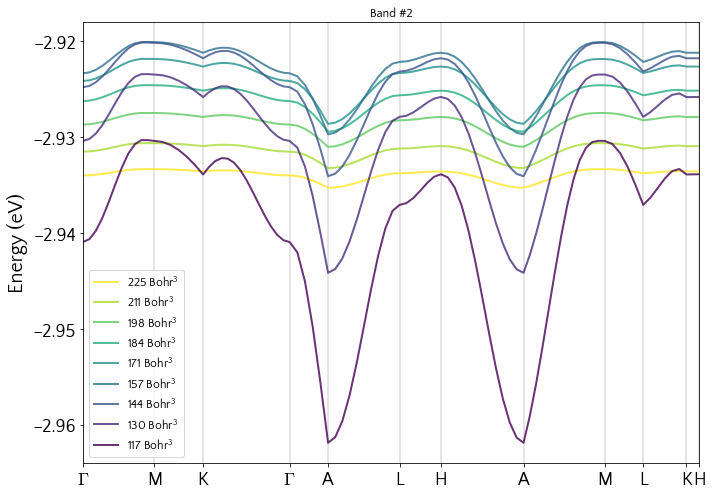

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


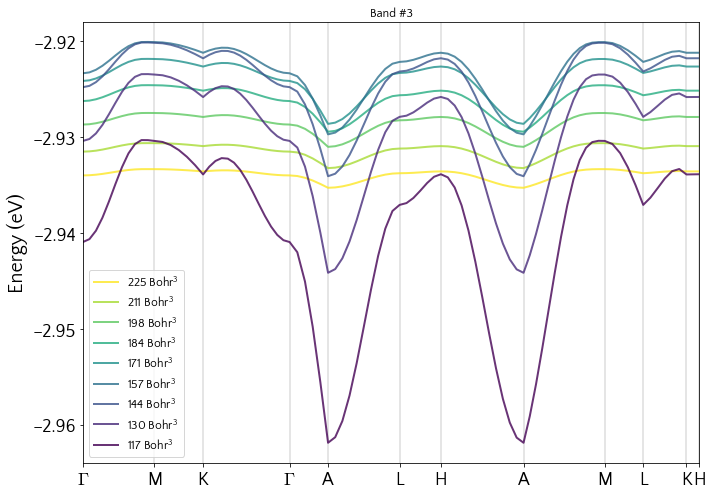

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


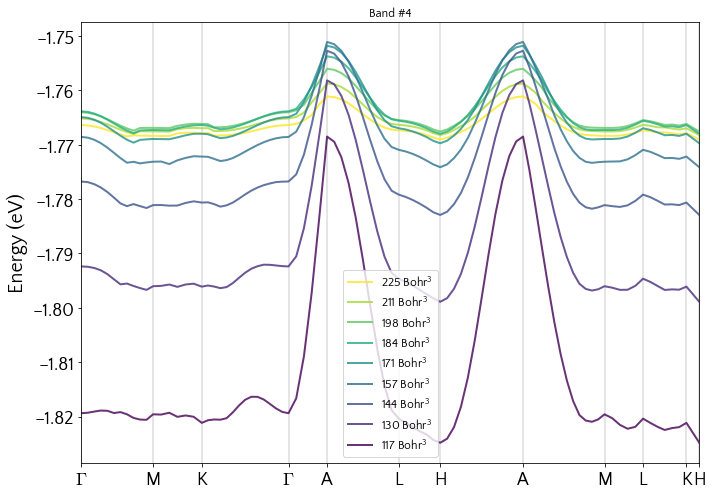

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


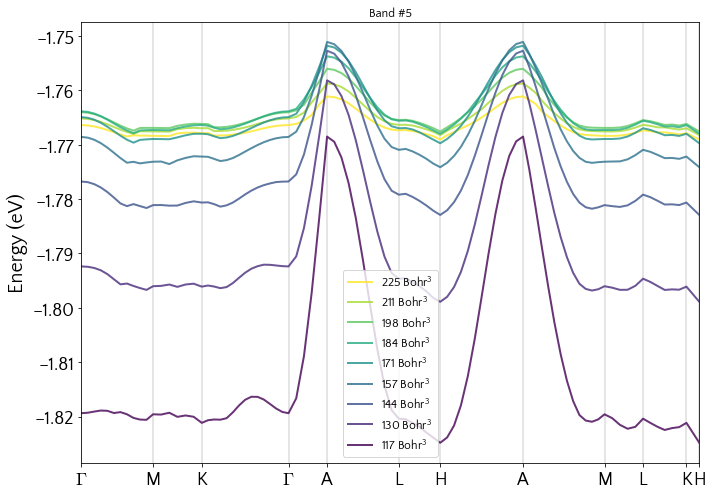

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


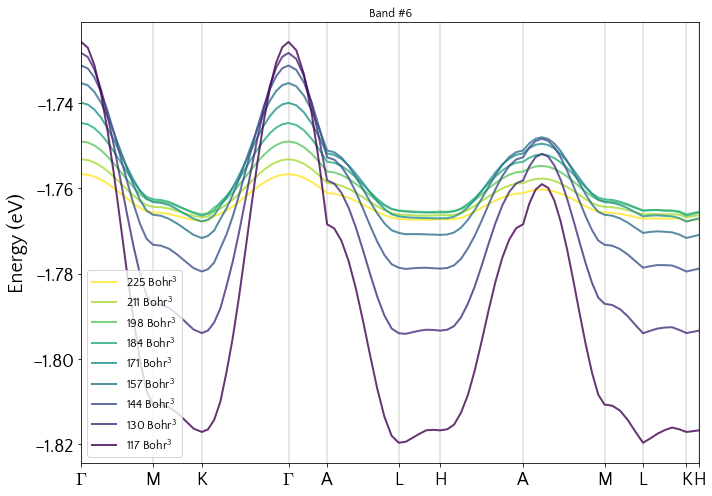

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


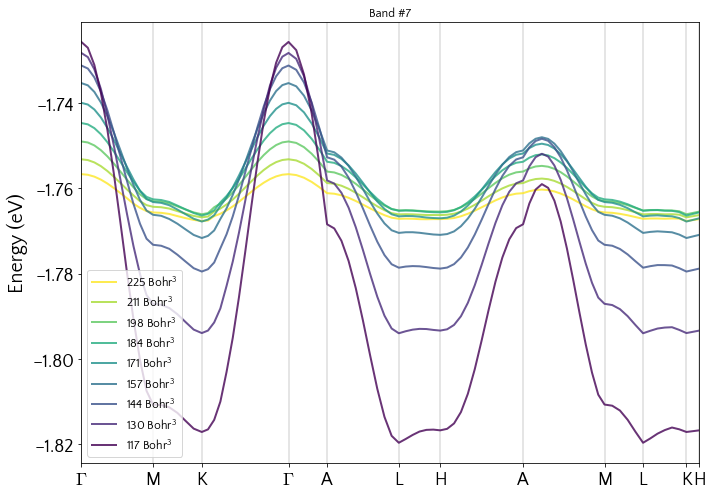

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


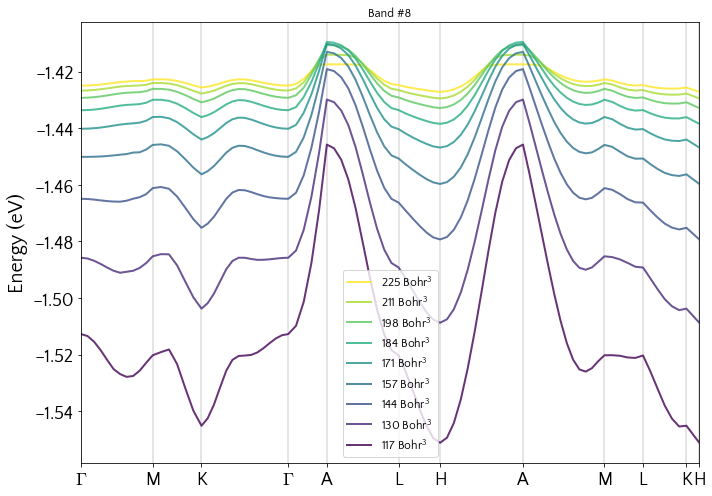

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


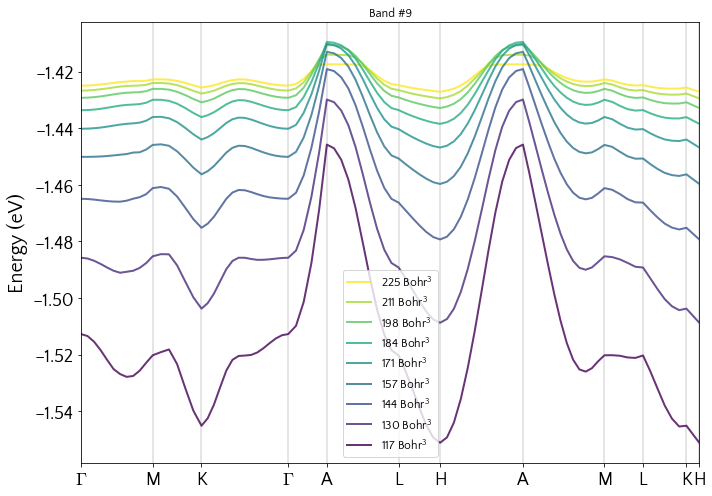

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


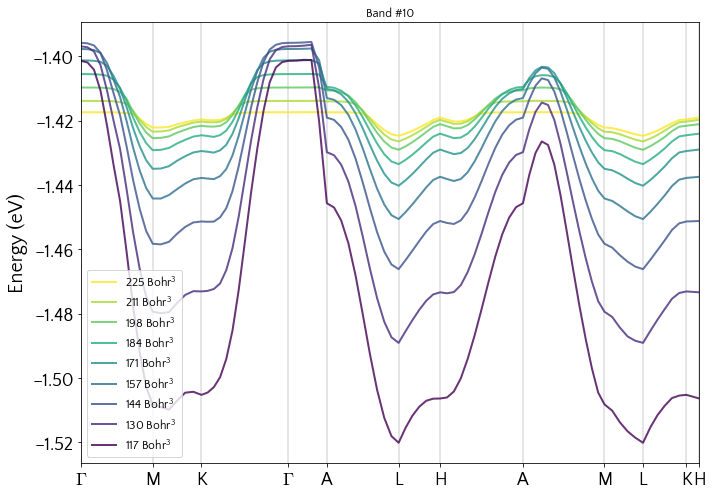

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


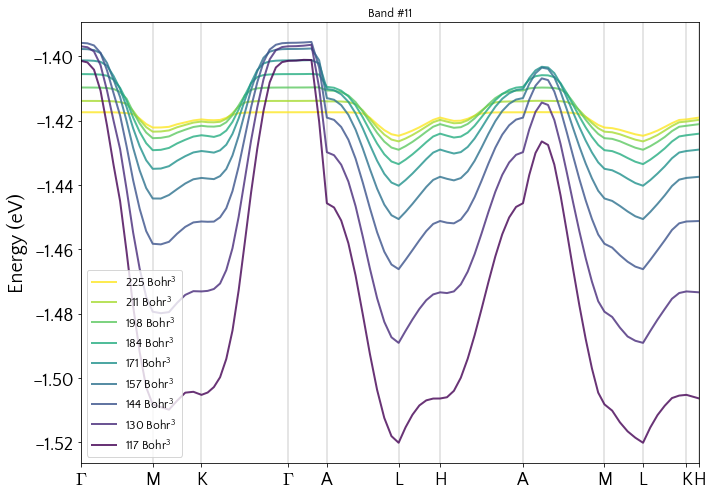

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


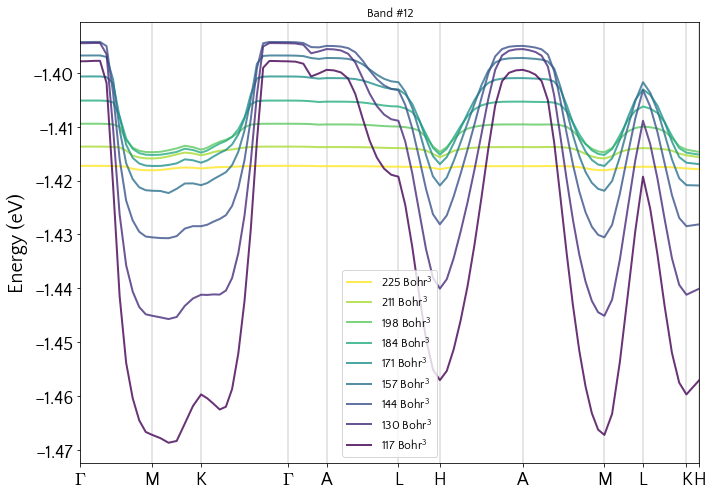

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


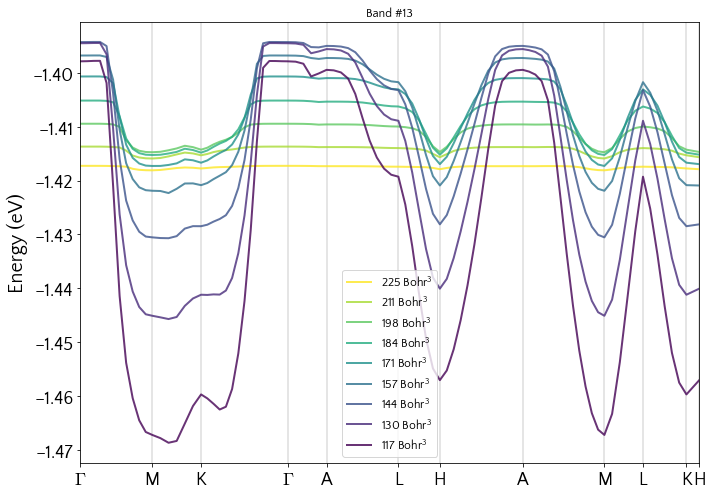

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


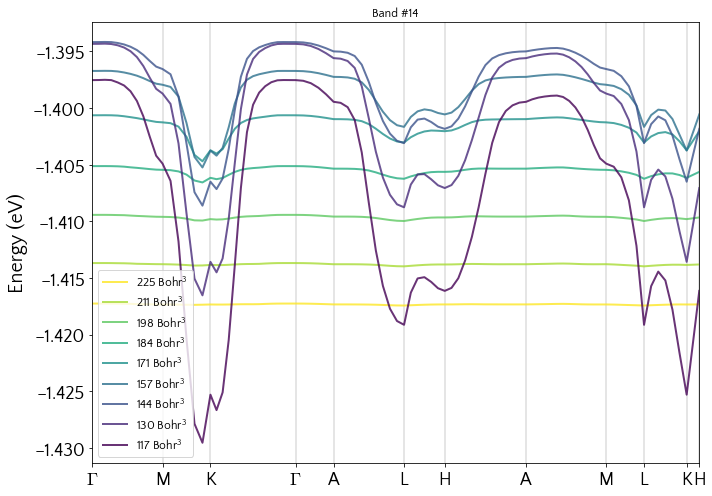

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


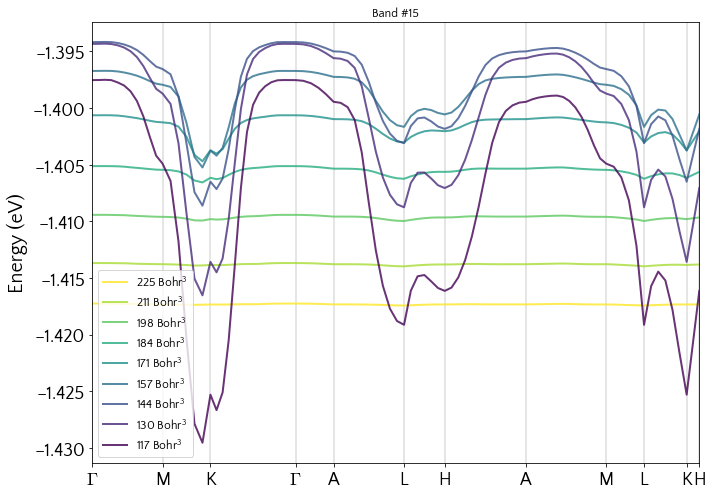

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


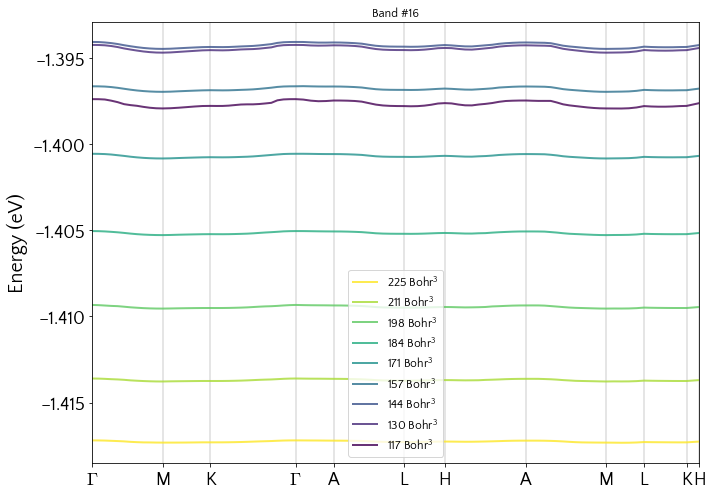

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


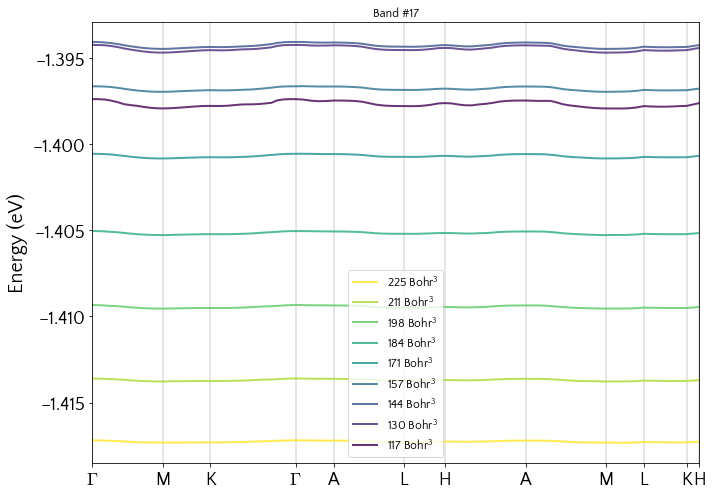

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


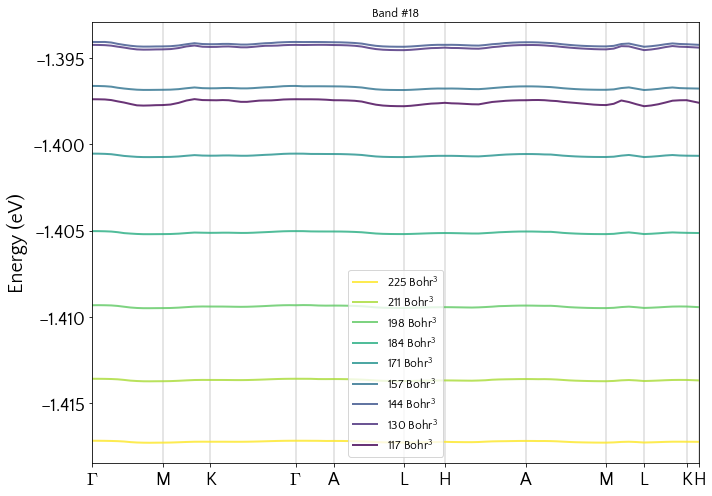

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


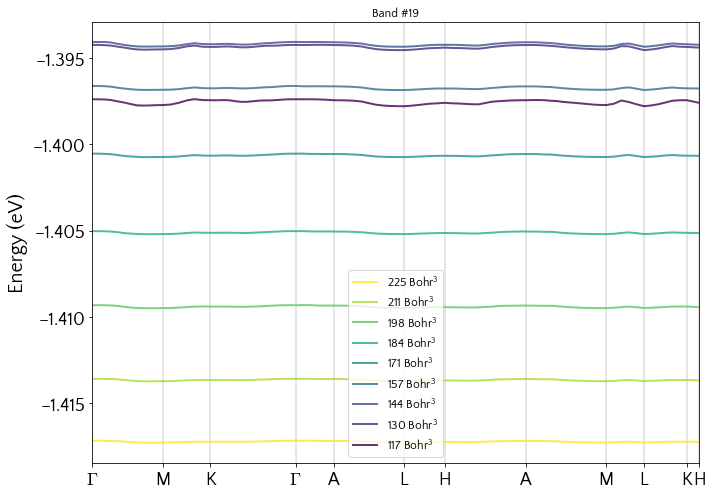

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


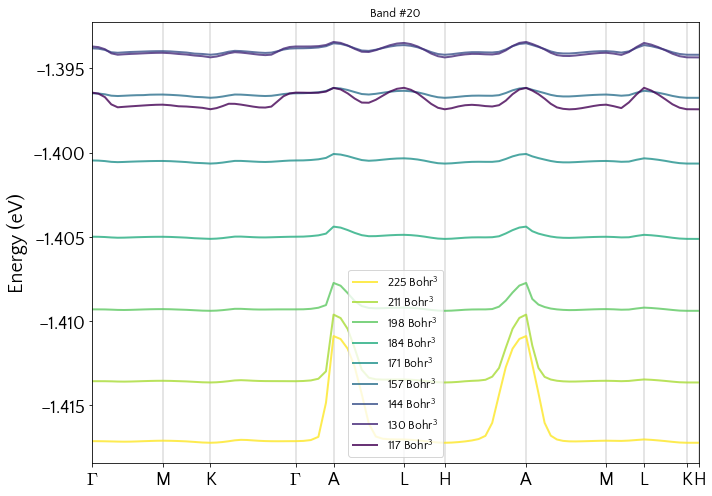

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


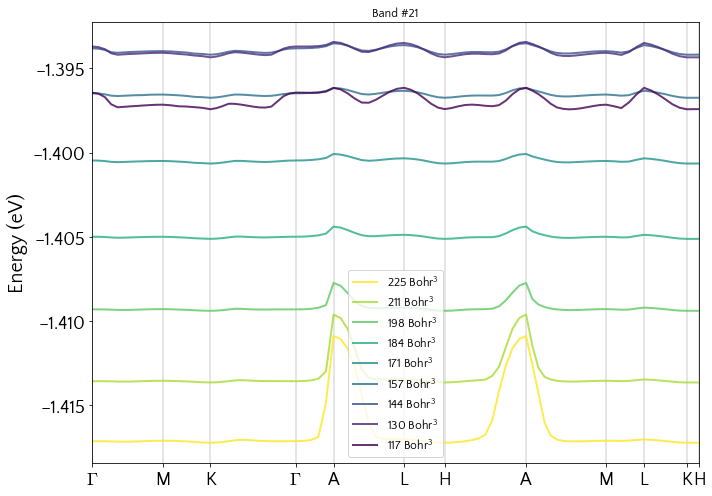

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


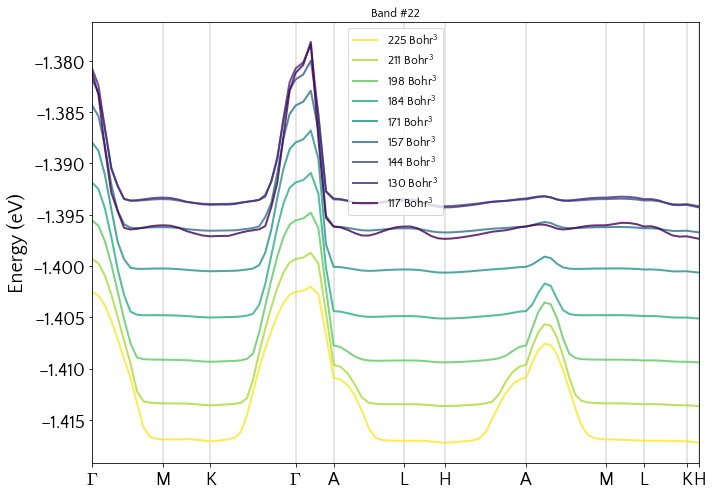

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


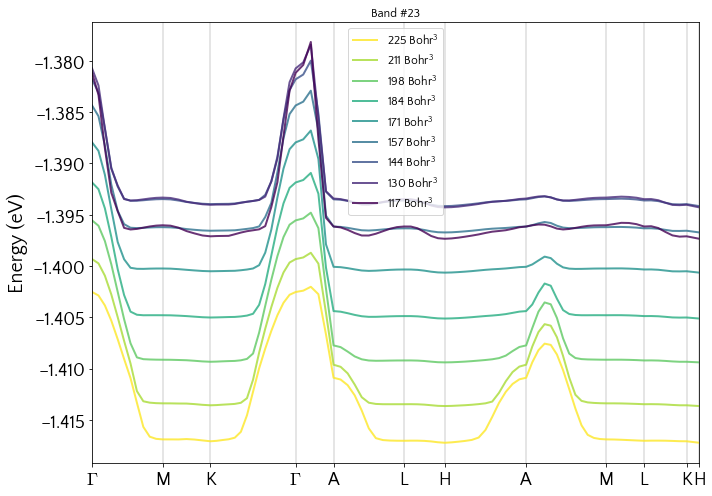

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


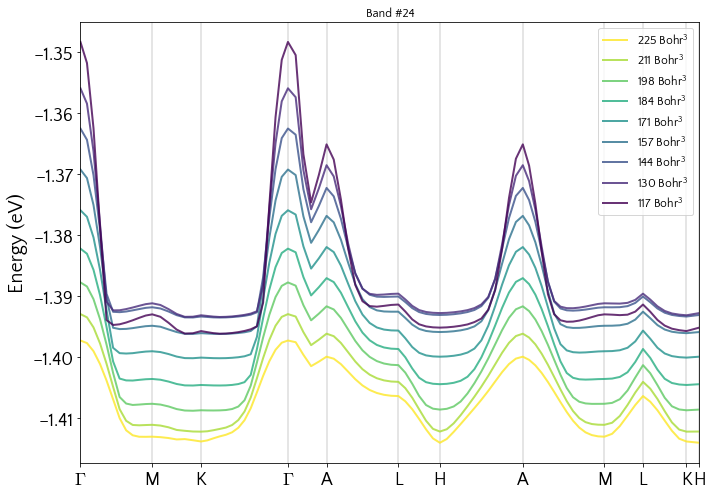

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


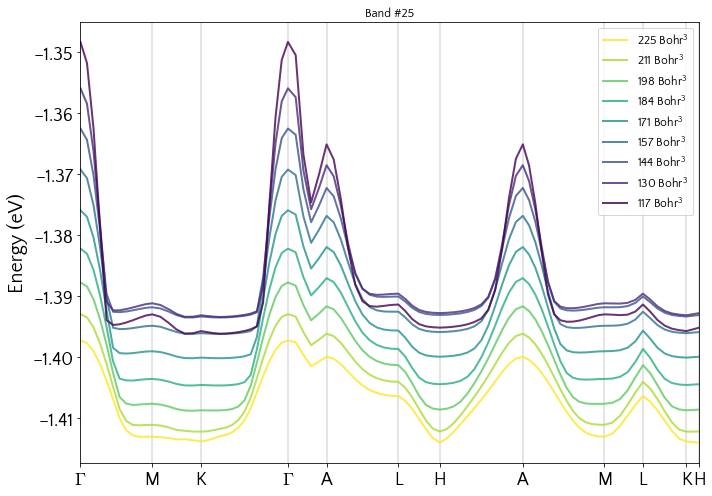

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


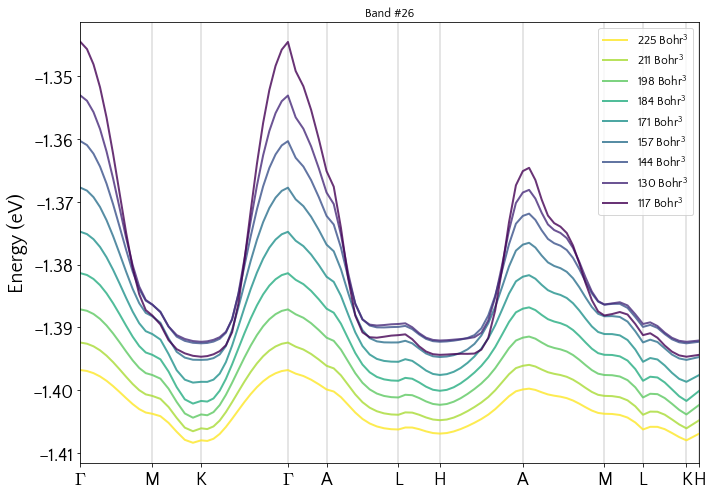

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


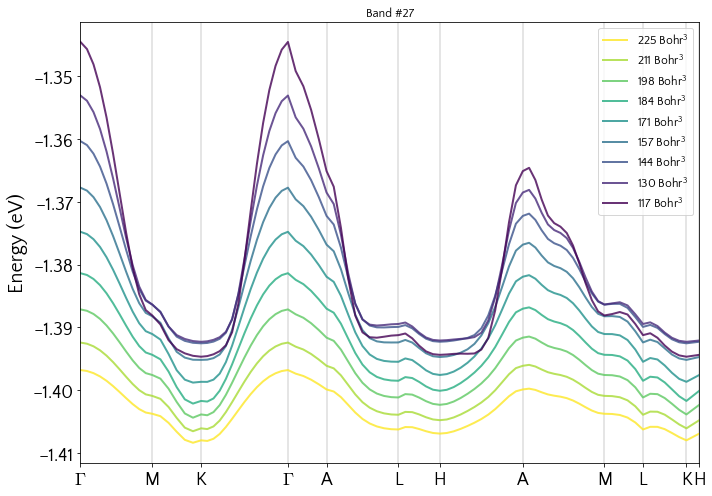

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


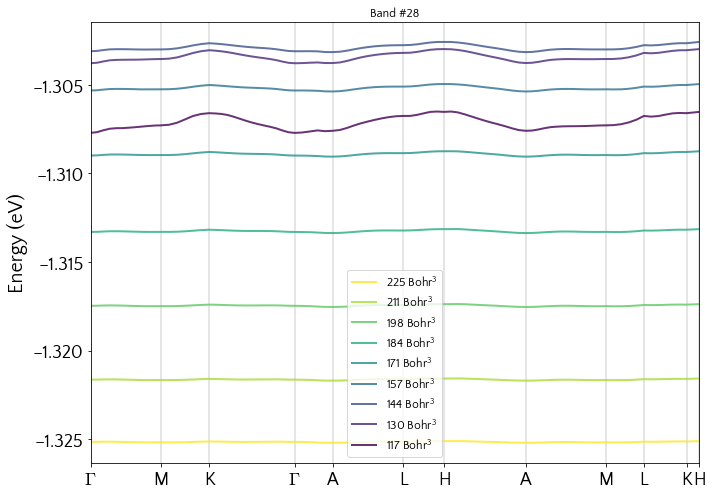

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


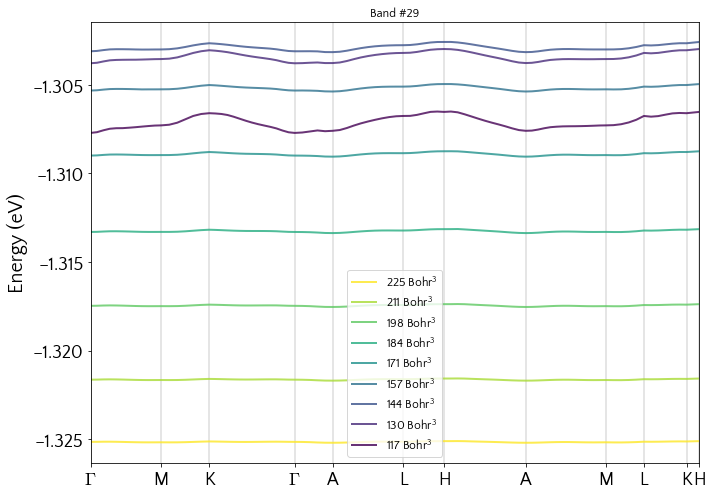

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


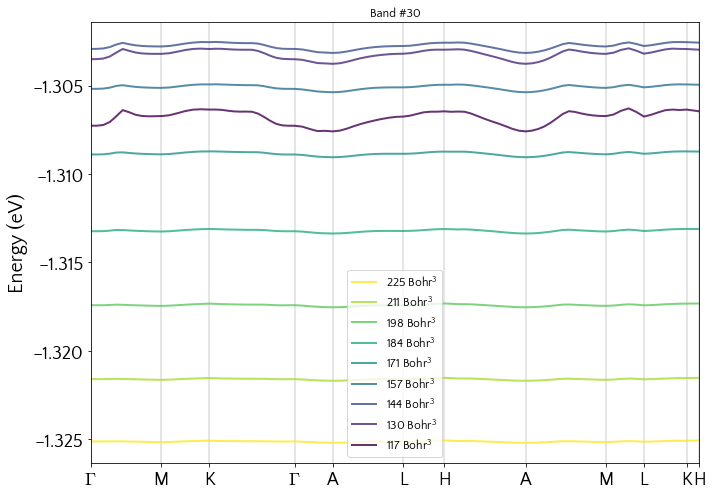

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


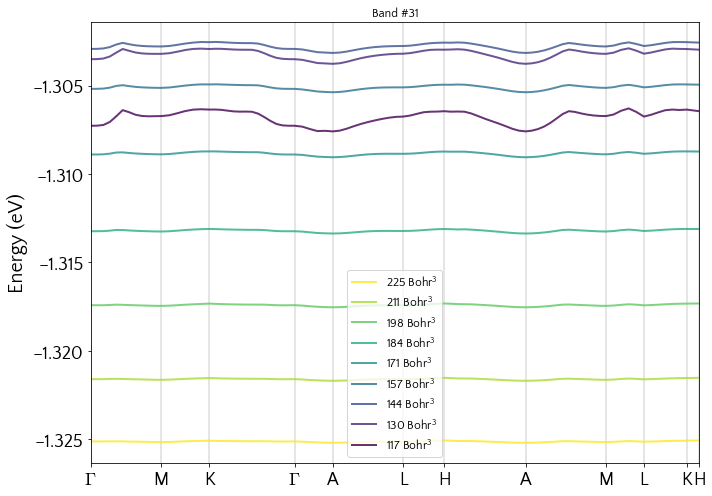

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


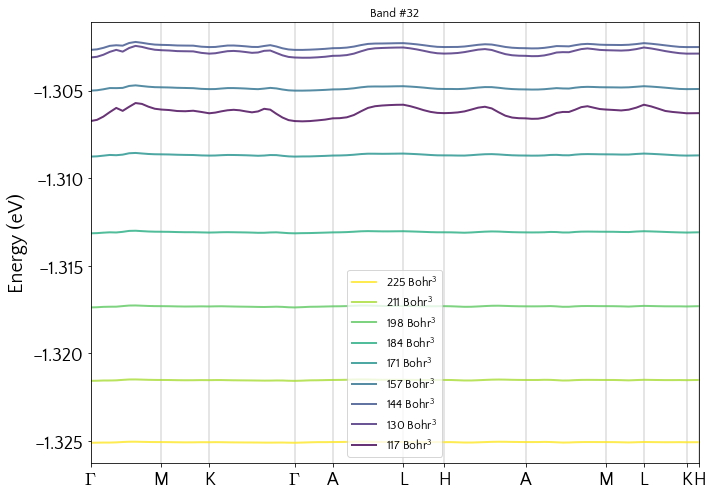

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


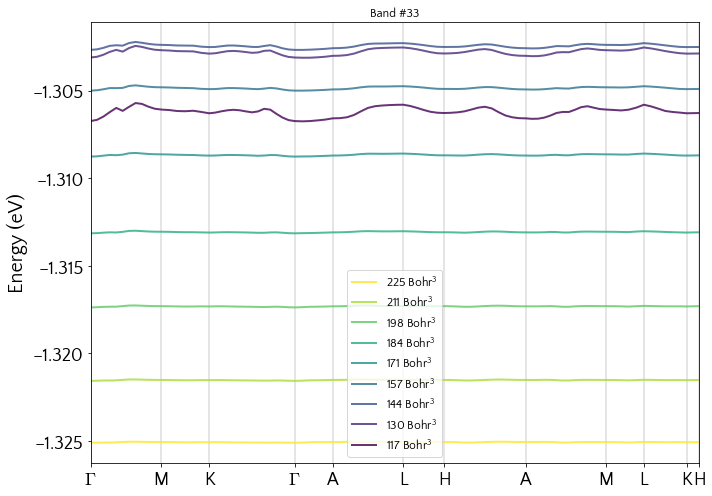

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


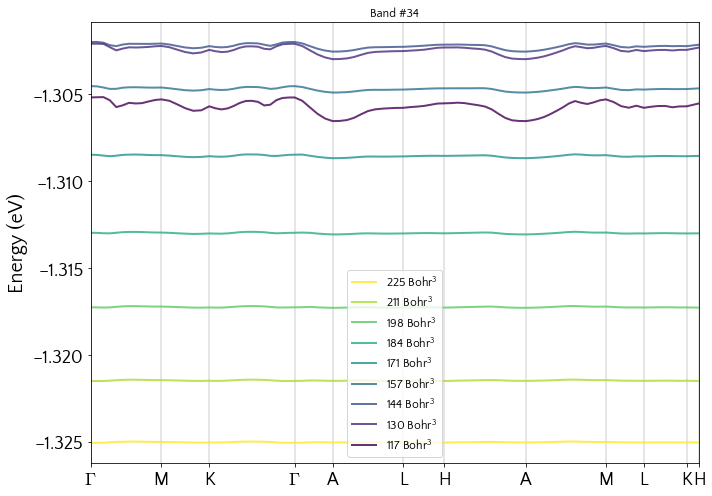

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


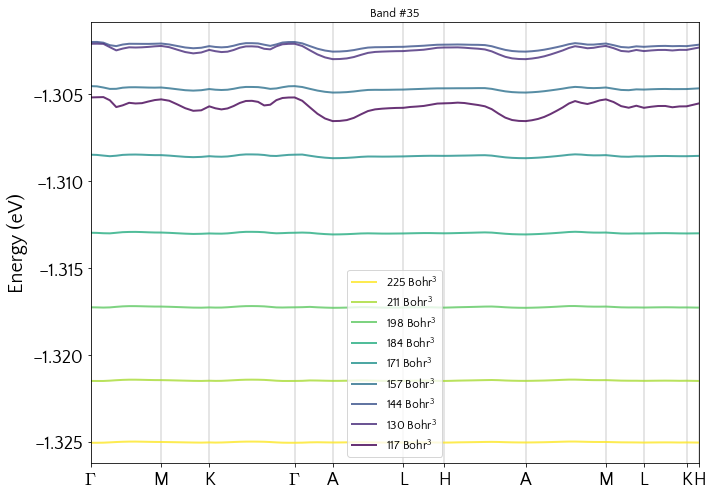

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


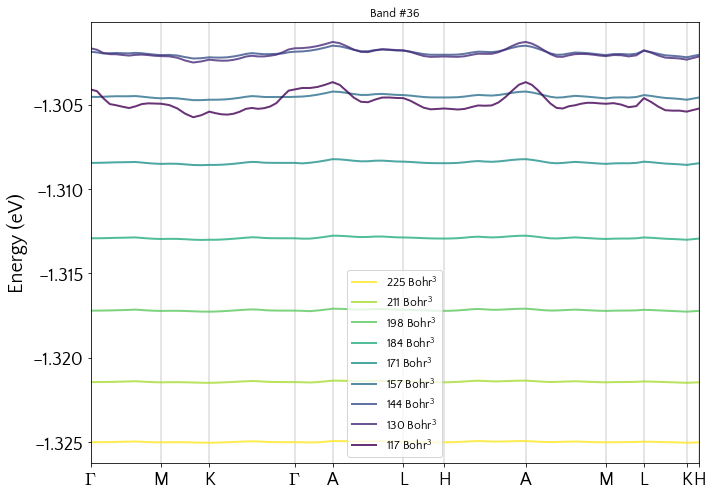

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


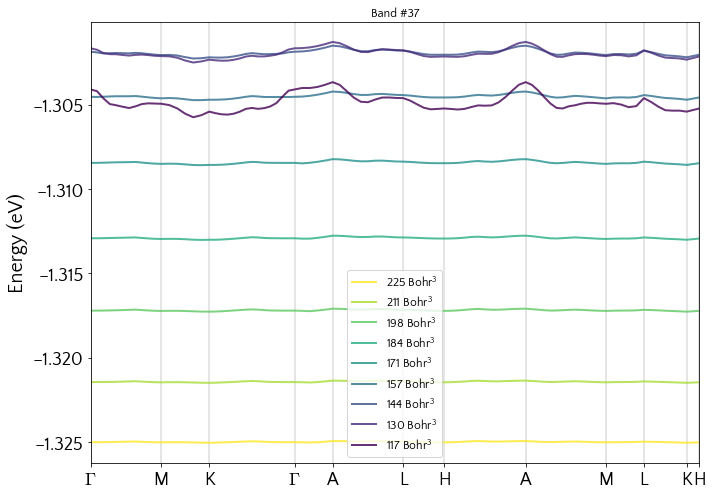

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


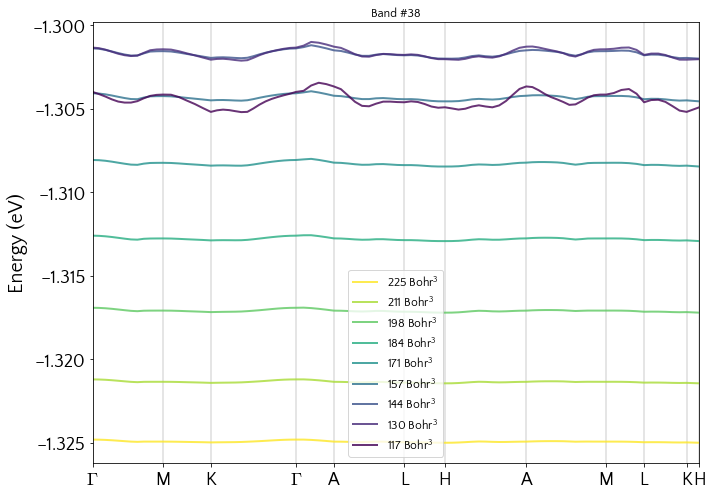

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


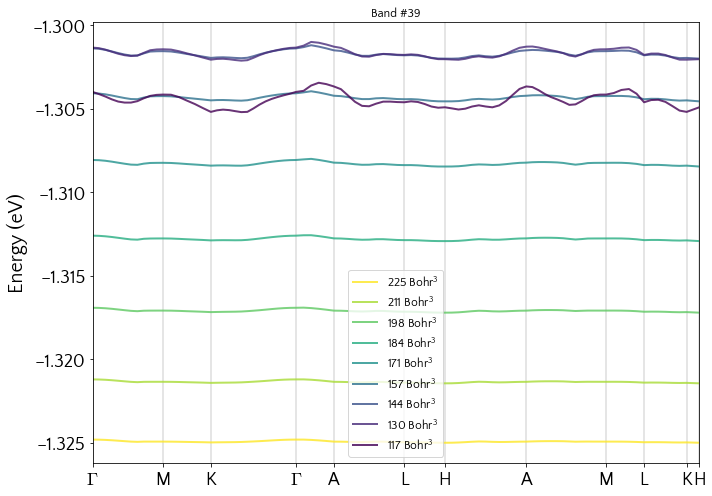

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


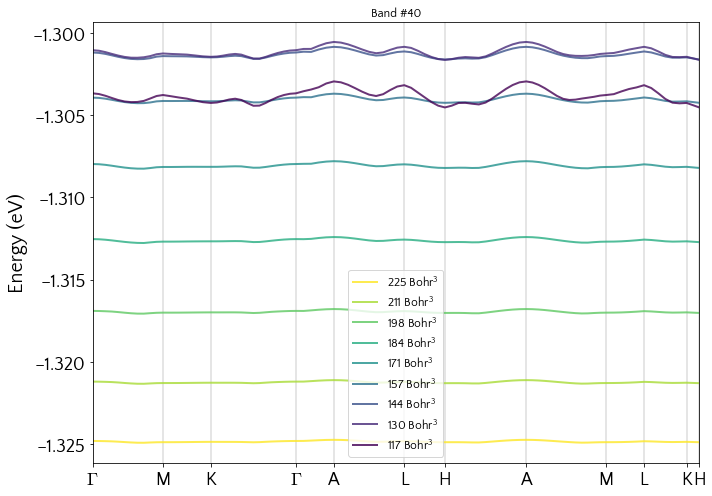

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


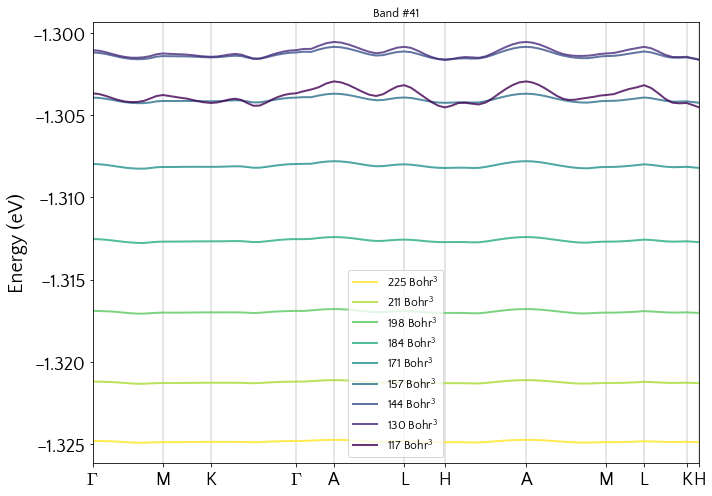

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


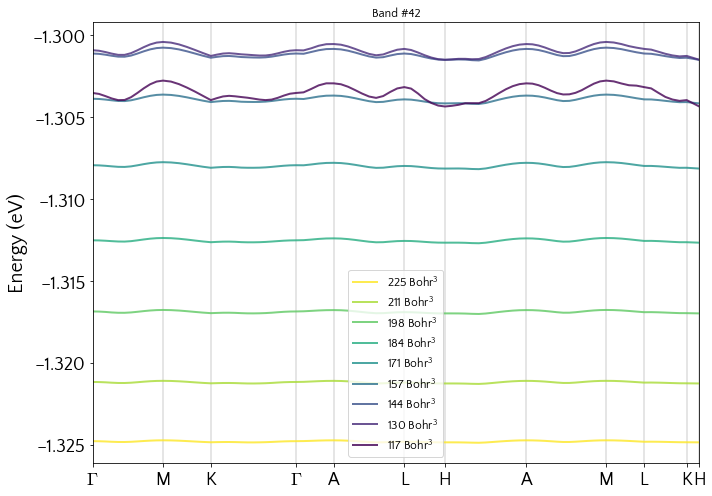

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


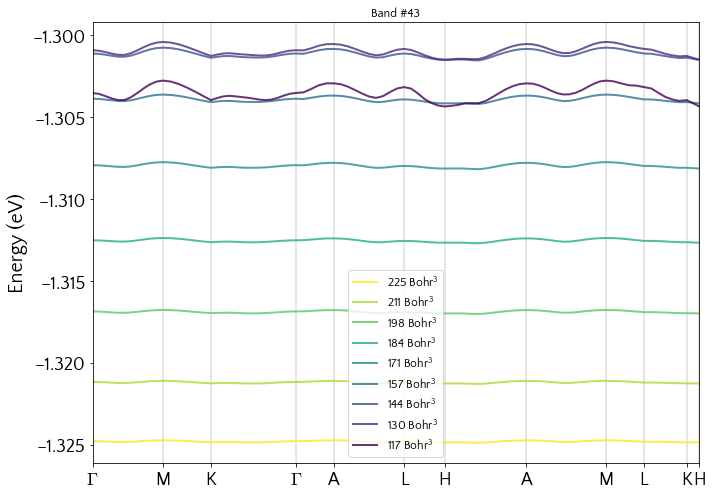

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


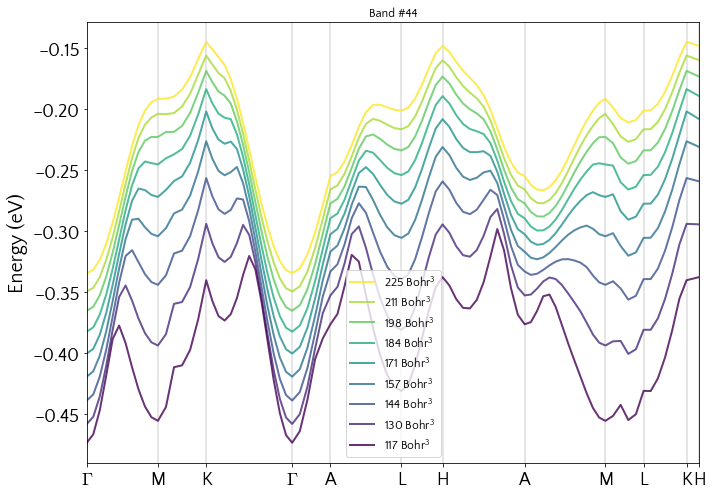

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


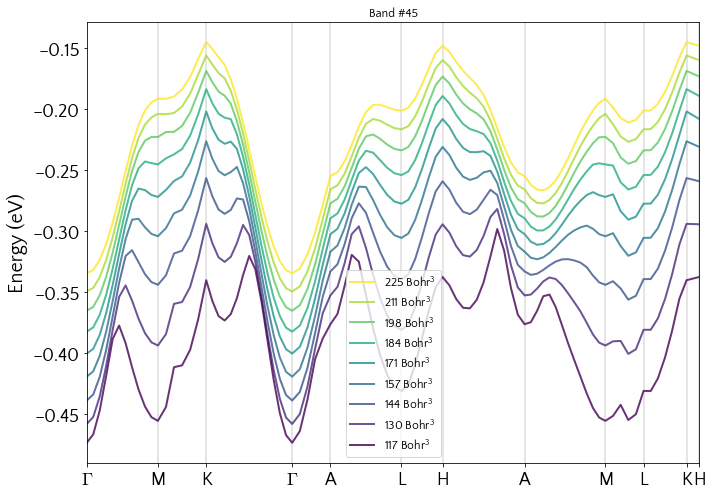

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


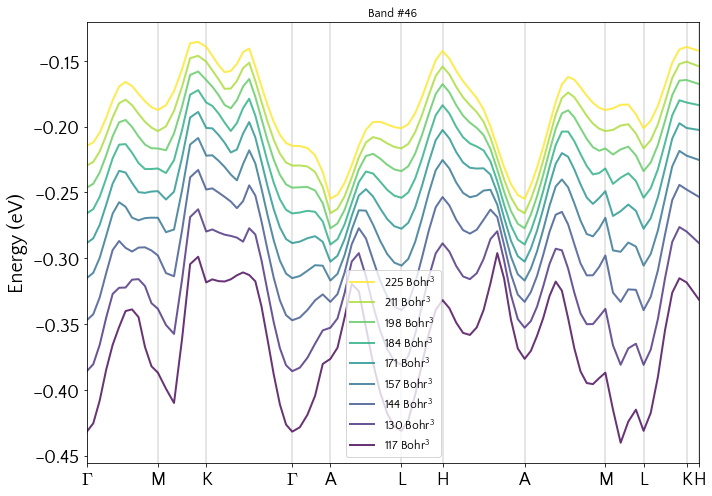

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


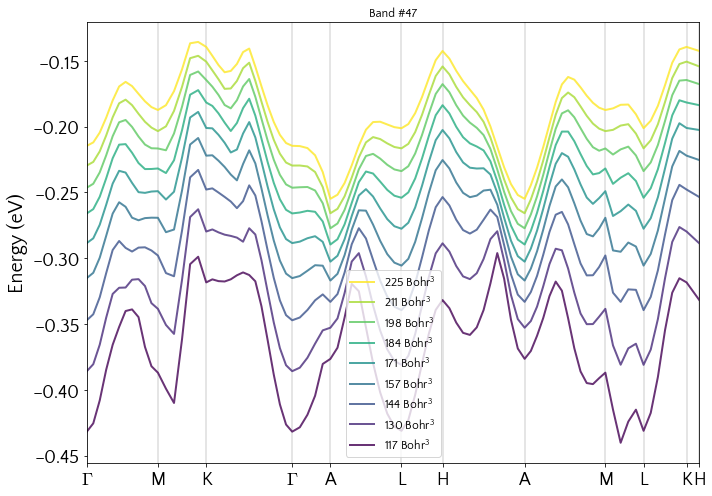

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


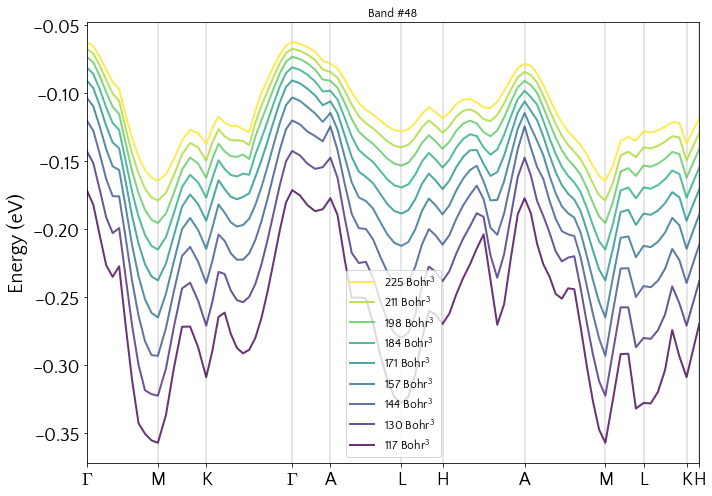

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


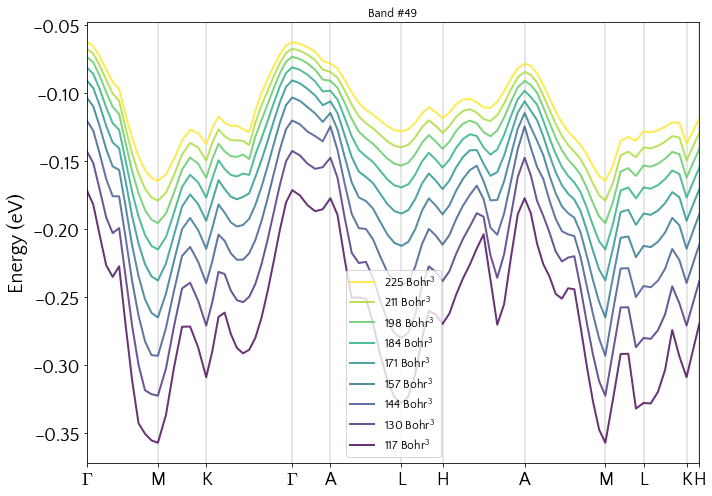

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


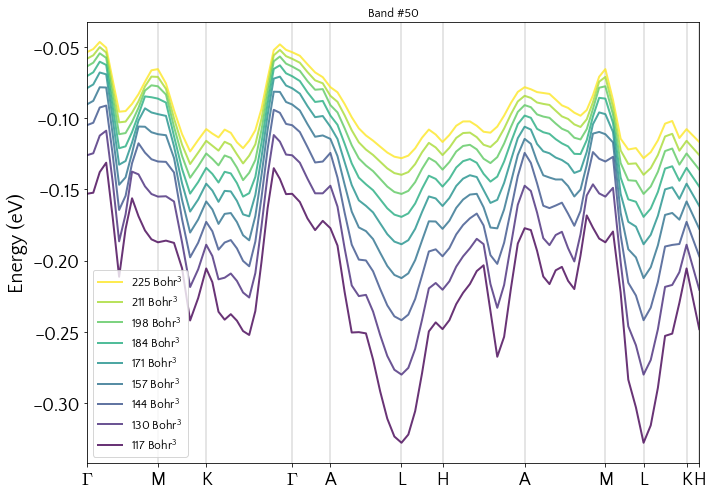

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


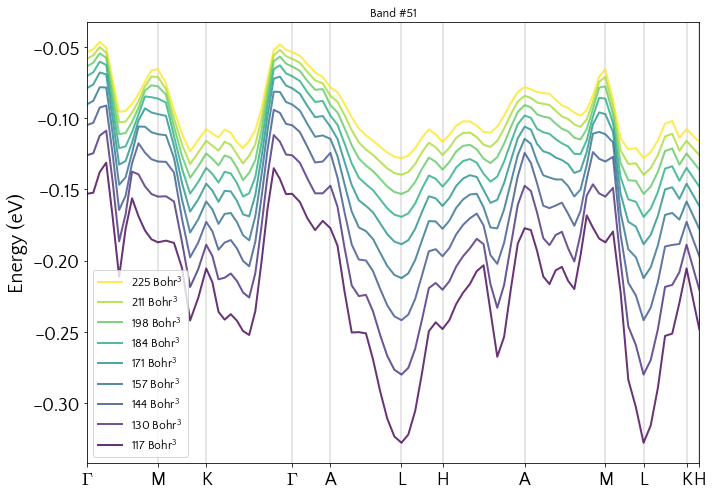

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


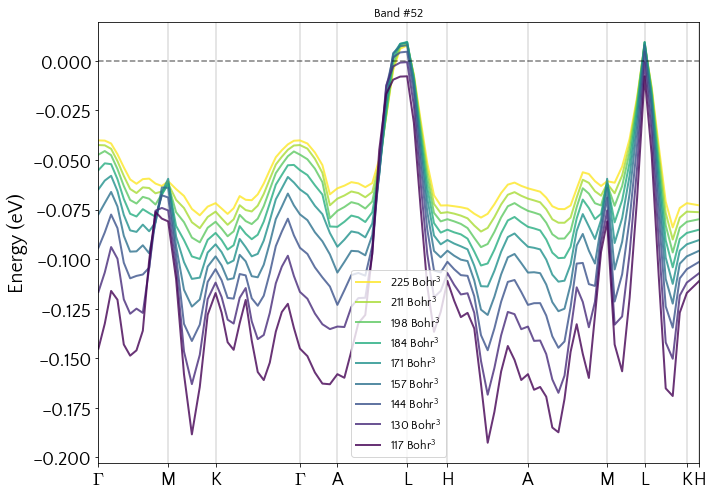

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


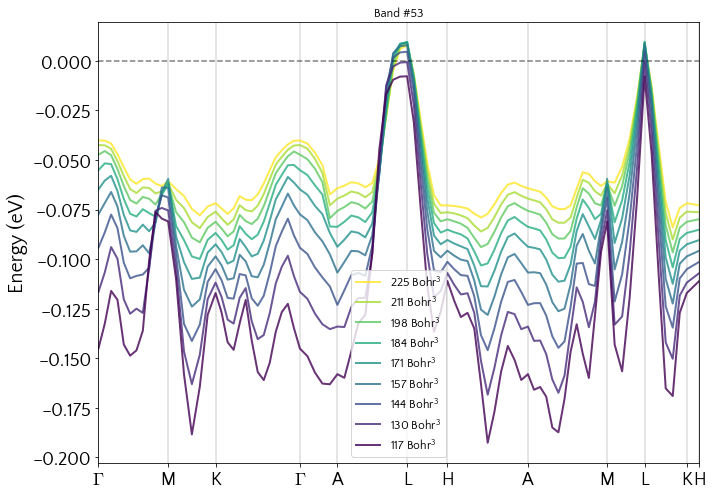

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


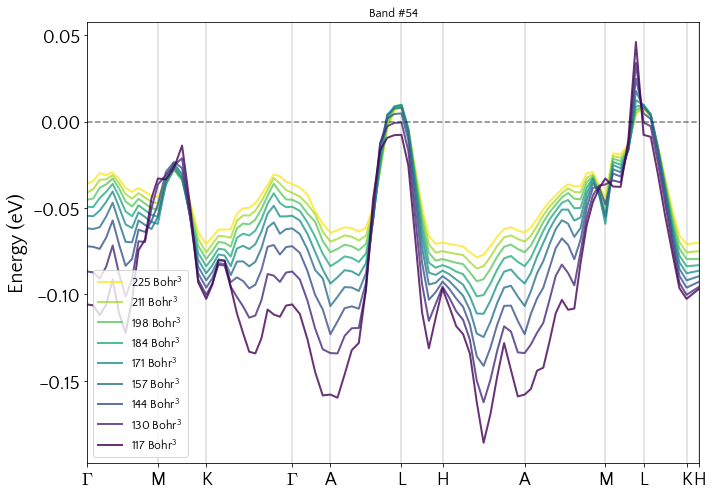

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


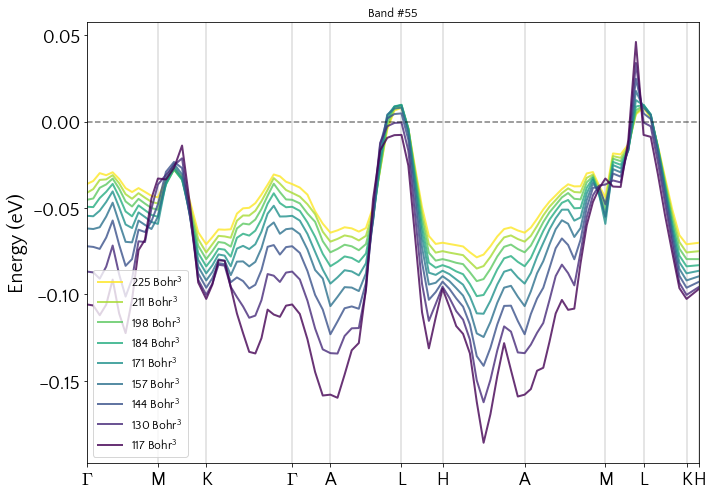

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


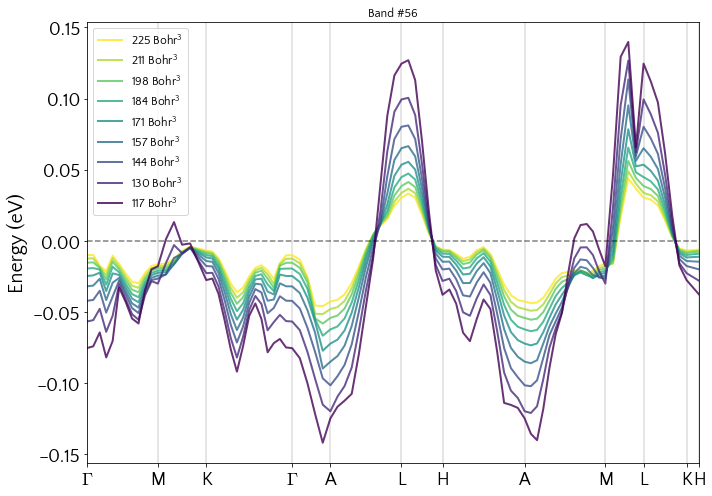

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


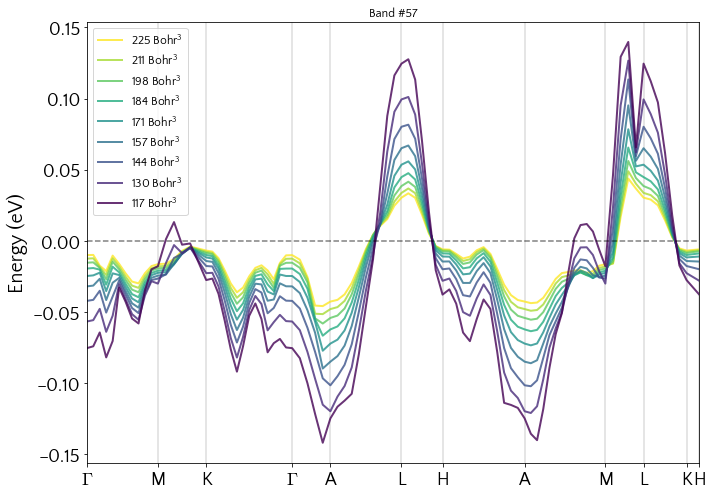

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


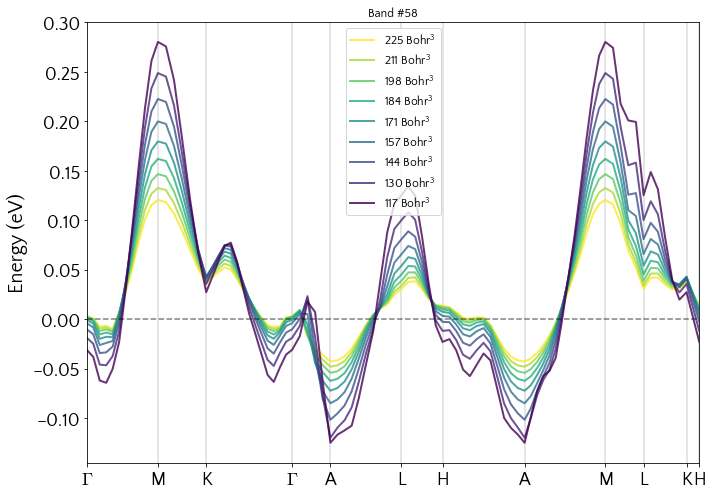

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


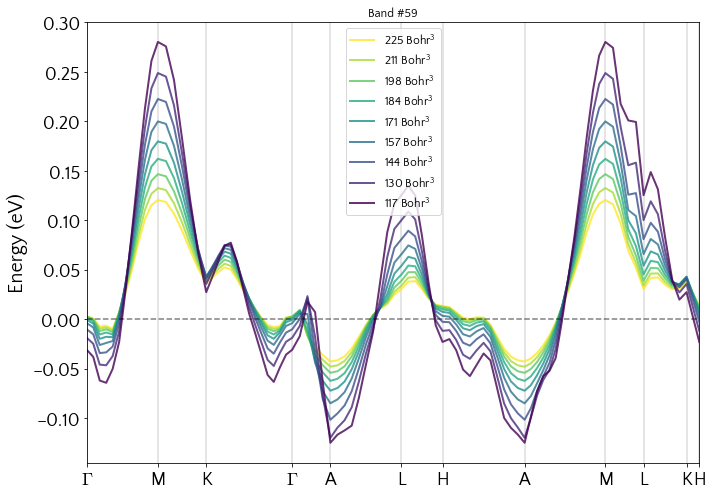

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


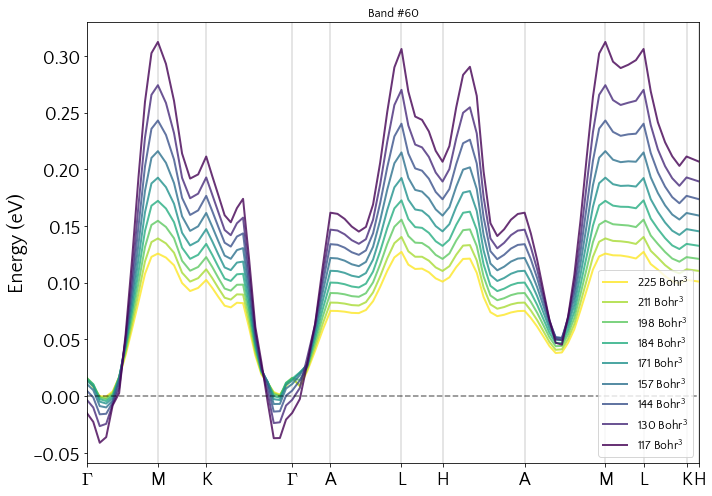

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


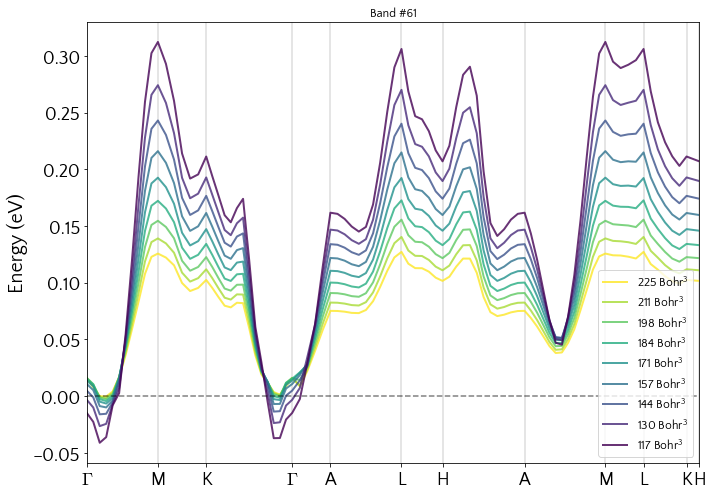

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


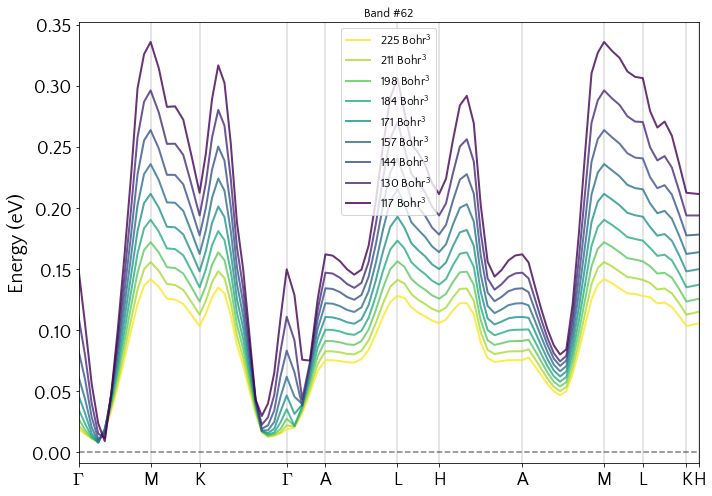

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


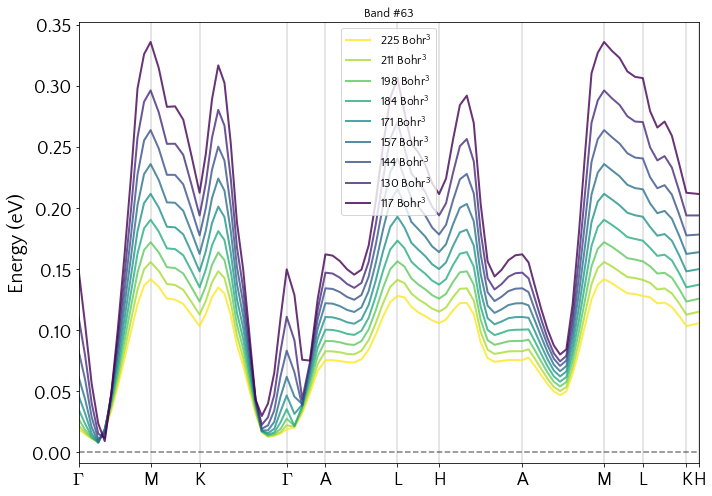

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


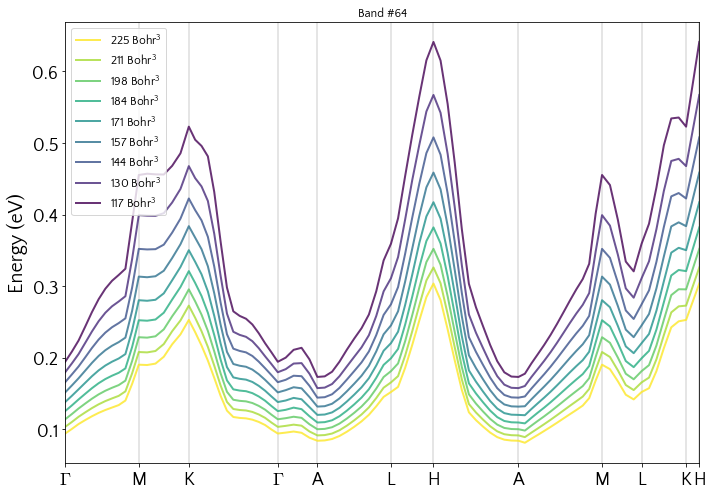

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


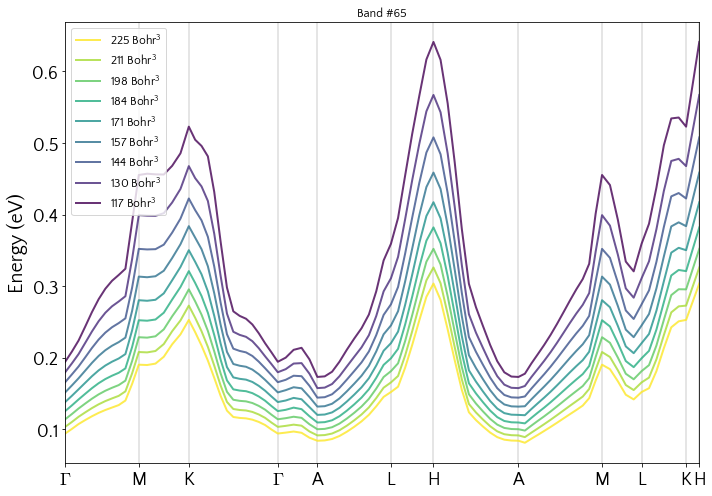

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


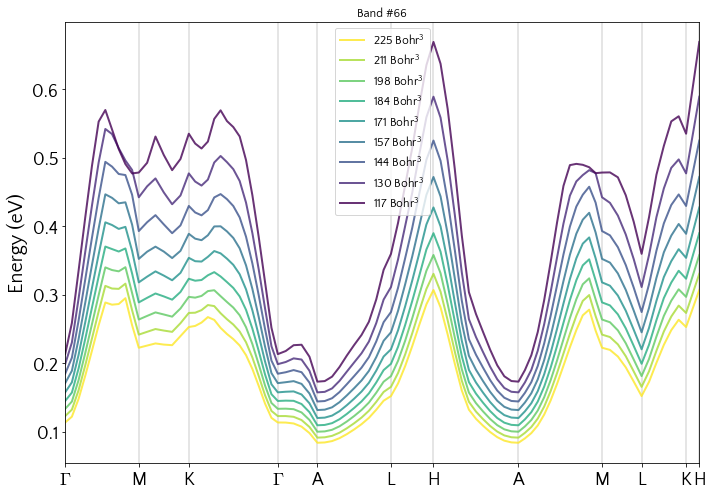

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


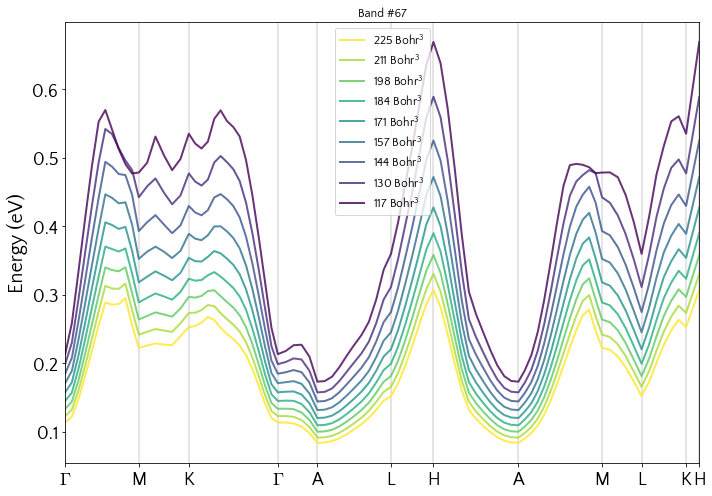

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


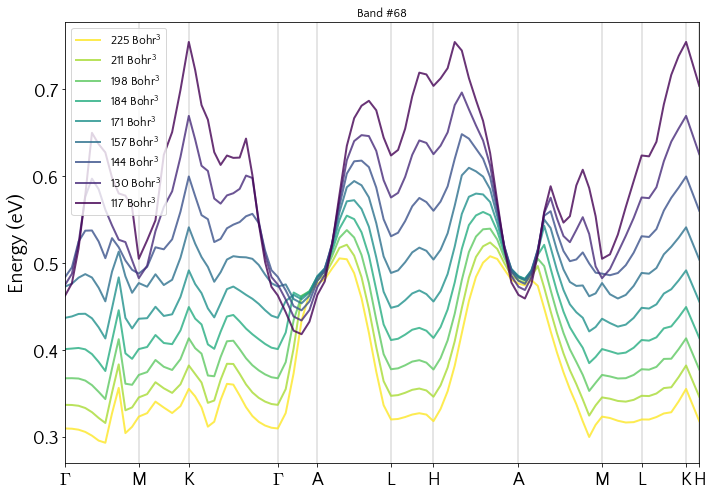

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


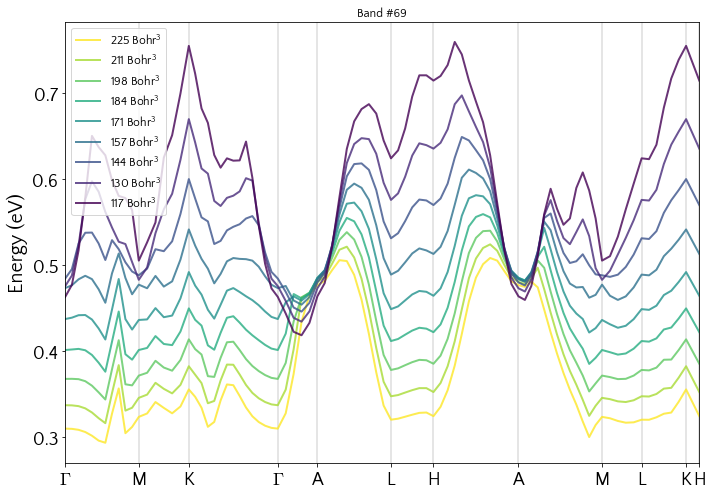

In [109]:
plot_bandstructure_volumes_individuais([225,211, 198, 184, 171, 157, 144, 130, 117])

# Análise para detectar cruzamento de bandas:
## Compara diferentes volumes de uma mesma banda

In [104]:
volumes = [225, 211, 198, 184, 171, 157, 144, 130, 117, 97, 90]
labels  = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J']

print('VOLUME CHANGES:')
for i in range(len(volumes)-1):
    print('{0}: {1} -> {2}'.format(labels[i], volumes[i], volumes[i+1]))
    
    
print('{:->110}'.format('-'))
print('   '+' '.join(['{:>2}'.format(x) for x in range(0,69,2)]))
print('{:->110}'.format('-'))

lista_volumes_bands = []
for i in range(len(volumes)-1):
    lista_bandas1, vertice_coords_dump, vertice_labels_dump = read_bands_Ldiff(volumes[i])
    lista_bandas2, vertice_coords_dump, vertice_labels_dump = read_bands_Ldiff(volumes[i+1])
    crossings = []
    for j in range(0,len(lista_bandas1),2):
        diferenca = np.array(lista_bandas1[j]['energy']-lista_bandas2[j]['energy'])
        zero_crossings = np.where(np.diff(np.sign(diferenca)))[0]
        crossings.append(len(zero_crossings))
    print(labels[i]+': '+' '.join(['{:>2}'.format(x) for x in crossings]))


VOLUME CHANGES:
A: 225 -> 211
B: 211 -> 198
C: 198 -> 184
D: 184 -> 171
E: 171 -> 157
F: 157 -> 144
G: 144 -> 130
H: 130 -> 117
I: 117 -> 97
J: 97 -> 90
--------------------------------------------------------------------------------------------------------------
    0  2  4  6  8 10 12 14 16 18 20 22 24 26 28 30 32 34 36 38 40 42 44 46 48 50 52 54 56 58 60 62 64 66 68
--------------------------------------------------------------------------------------------------------------
A:  0  0  0  0  4  5  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  4  4  4  8  4  2  0  0  0
B:  0  0  0  0  4  5  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  4  4  4  8  4  2  0  0  0
C:  0  0  5  5  4  5  7  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  8  6  6  8  3  4  0  0  2
D:  3  0  4  5  0  5  7  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  6  8  6  8  3  2  0  0  2
E:  5  4  4  5  0  3  7  4  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  4  

# Análise para detectar o cruzamento de bandas:
## Compara diferentes bandas de um mesmo volume

In [17]:
volumes = [225, 211, 198, 184, 171, 157, 144, 130, 117, 97, 90]

for volume in volumes:
    print('{:-^110}'.format('-'))
    print('{:^110}'.format('VOLUME: {0} BOHR^3'.format(volume)))


    print('{:->110}'.format('-'))
    print('   '+' '.join(['{:>2}'.format(x) for x in range(0,69,2)]))
    print('{:->110}'.format('-'))
    
    
    lista_bandas1, vertice_coords_dump, vertice_labels_dump = read_bands_Ldiff(volume)
    
    for i in range(0,len(lista_bandas1),2):
    #    lista_bandas1, vertice_coords_dump, vertice_labels_dump = read_bands_Ldiff(volume)
        crossings = []
        for j in range(0,len(lista_bandas1),2):
            diferenca = np.array(lista_bandas1[i]['energy']-lista_bandas1[j]['energy'])
            zero_crossings = np.where(np.diff(np.sign(diferenca)))[0]
            crossings.append(len(zero_crossings))
        for k in range(len(crossings)):
            if crossings[k]==0:
                crossings[k]='-'
        print('{:>2}:'.format(i)+' '.join(['{:>2}'.format(x) for x in crossings]))
    print('{:-^110}\n'.format('-'))

--------------------------------------------------------------------------------------------------------------
                                              VOLUME: 225 BOHR^3                                              
--------------------------------------------------------------------------------------------------------------
    0  2  4  6  8 10 12 14 16 18 20 22 24 26 28 30 32 34 36 38 40 42 44 46 48 50 52 54 56 58 60 62 64 66 68
--------------------------------------------------------------------------------------------------------------
 0: -  8  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 2: 8  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 4: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 6: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 8: -  -  -  -  

 0: - 12  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 2:12  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 4: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 6: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 8: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
10: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
12: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
14: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
16: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
18: -  -  -  -  -  -  -  -  

 0: - 10  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 2:10  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 4: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 6: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 8: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
10: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
12: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
14: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
16: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
18: -  -  -  -  -  -  -  -  

 0: -  4  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 2: 4  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 4: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 6: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 8: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
10: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
12: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
14: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
16: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
18: -  -  -  -  -  -  -  -  

 0: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 2: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 4: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 6: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 8: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
10: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
12: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
14: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
16: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
18: -  -  -  -  -  -  -  -  

 0: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 2: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 4: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 6: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
 8: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
10: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
12: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
14: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
16: -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -  -
18: -  -  -  -  -  -  -  -  

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


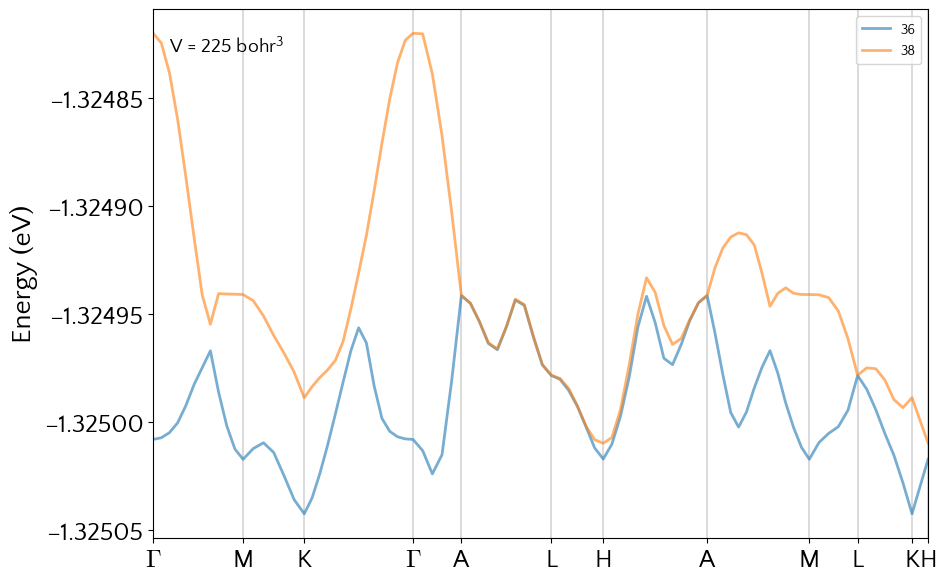

Substituting with a symbol from Computer Modern.


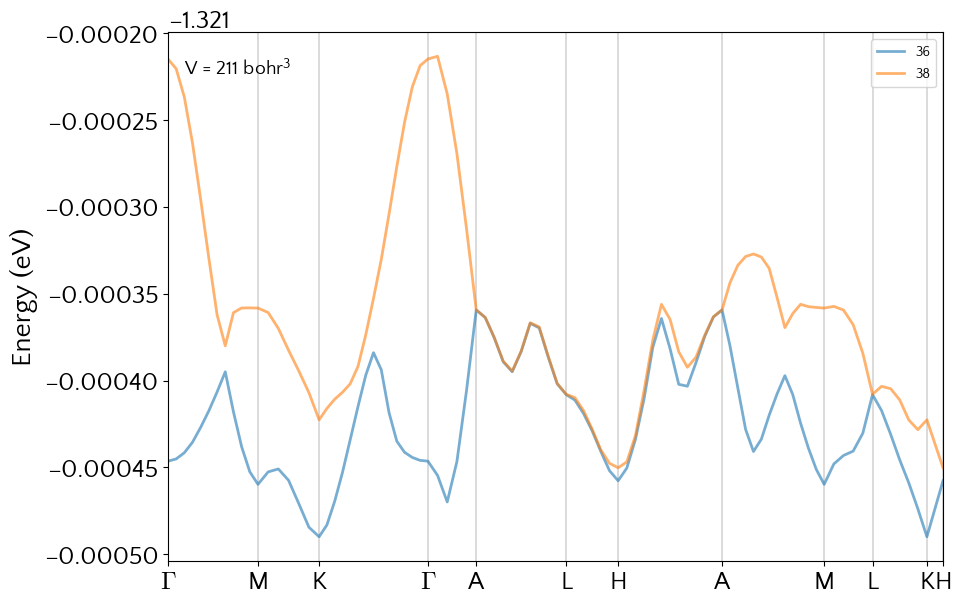

Substituting with a symbol from Computer Modern.


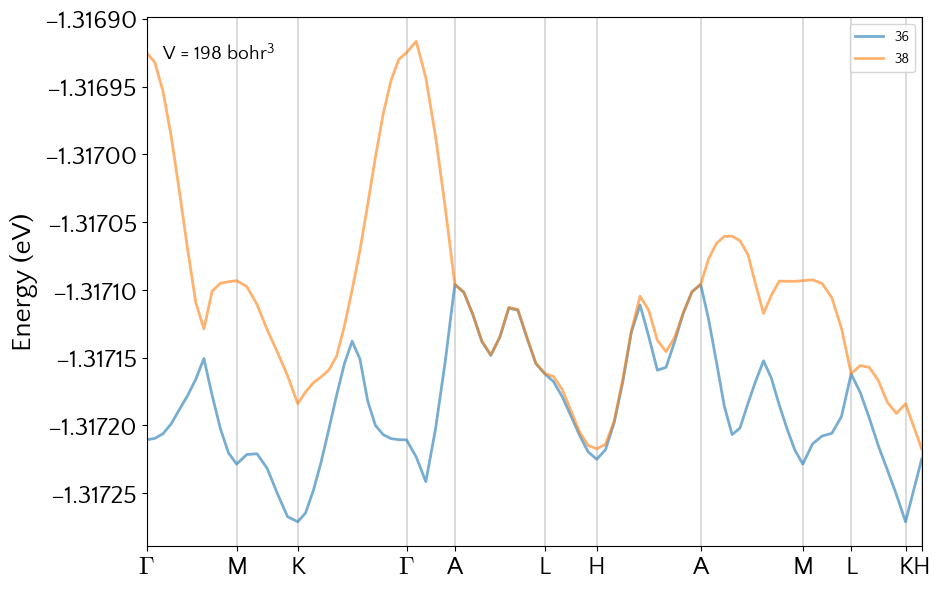

Substituting with a symbol from Computer Modern.


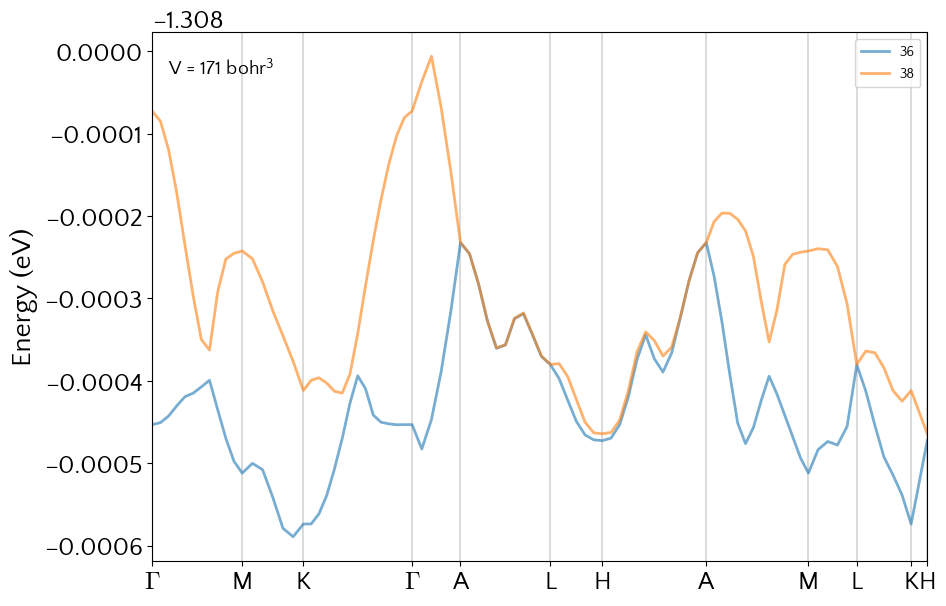

Substituting with a symbol from Computer Modern.


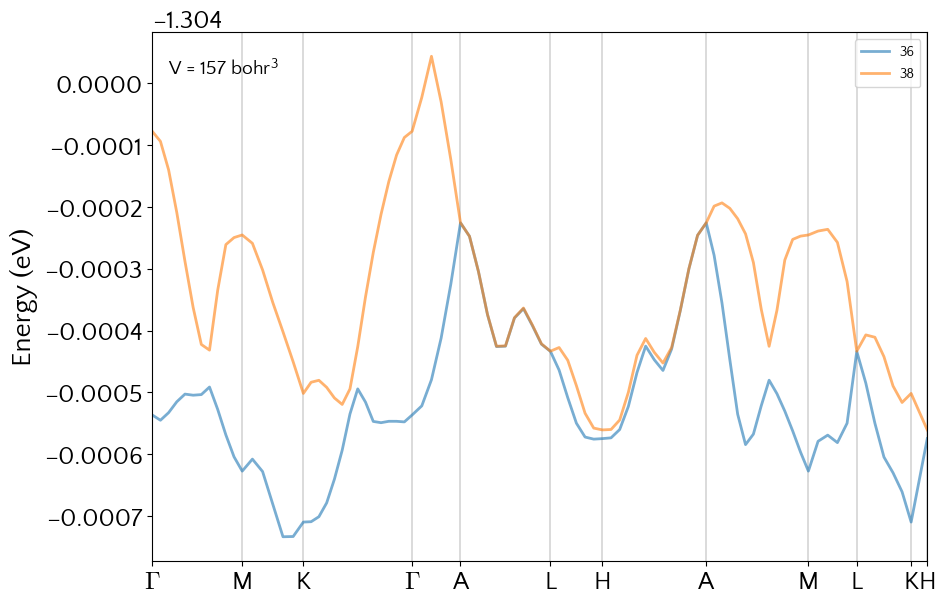

Substituting with a symbol from Computer Modern.


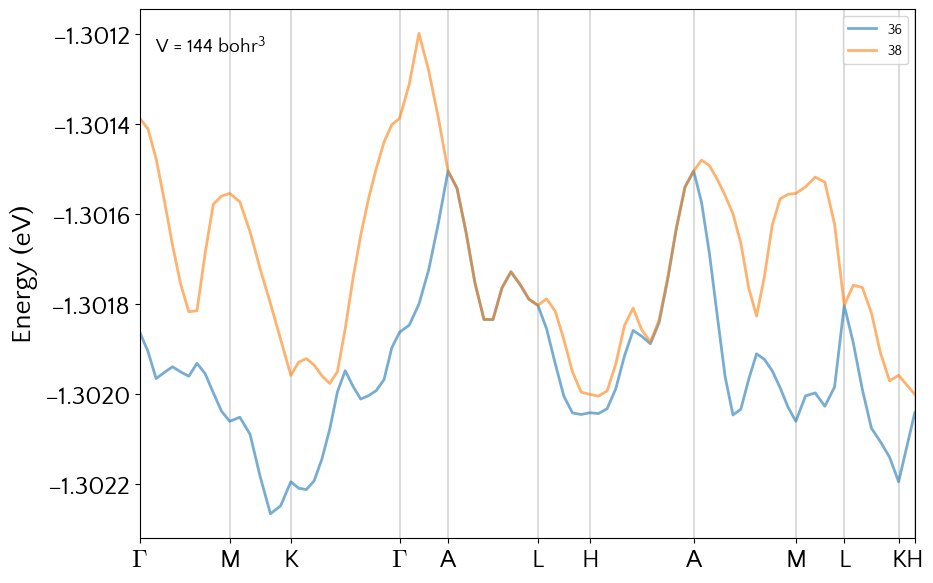

Substituting with a symbol from Computer Modern.


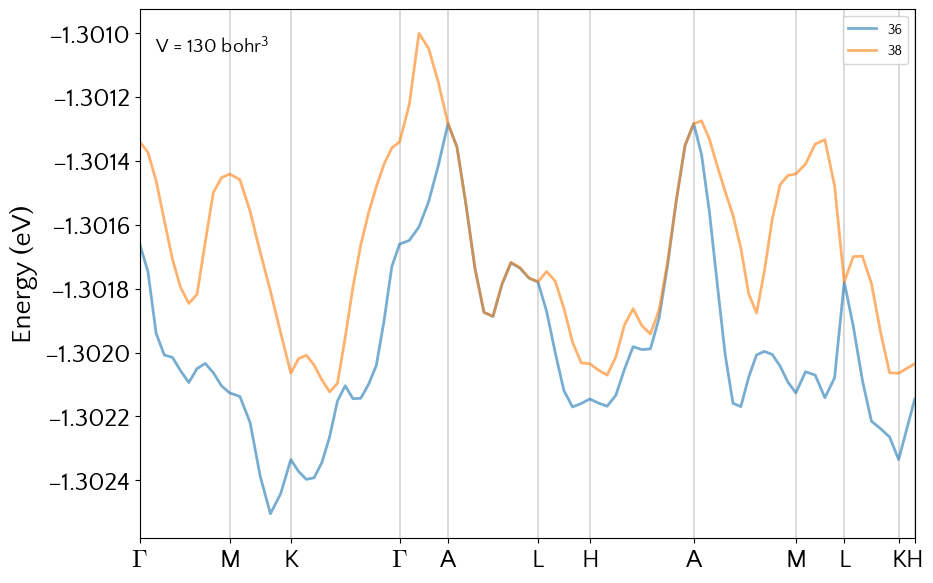

Substituting with a symbol from Computer Modern.


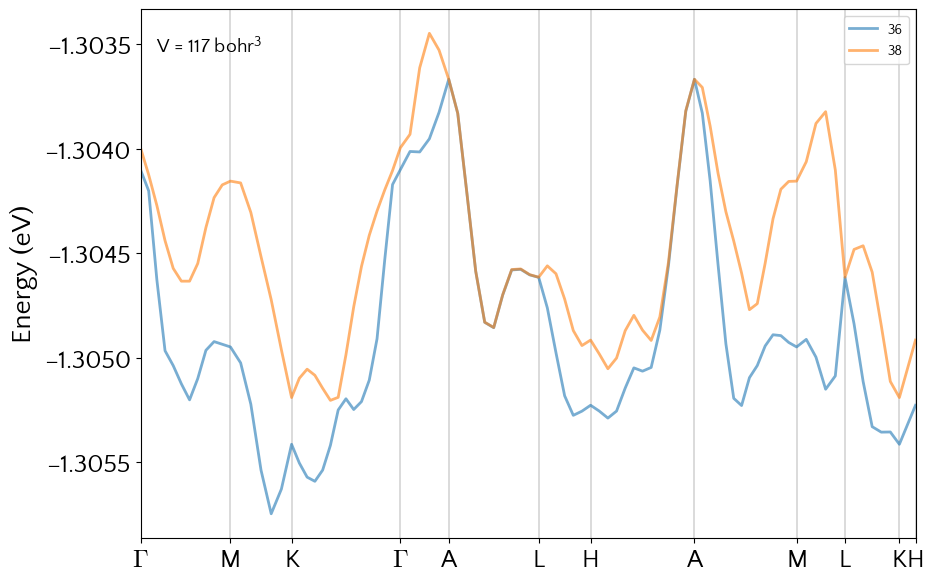

Substituting with a symbol from Computer Modern.


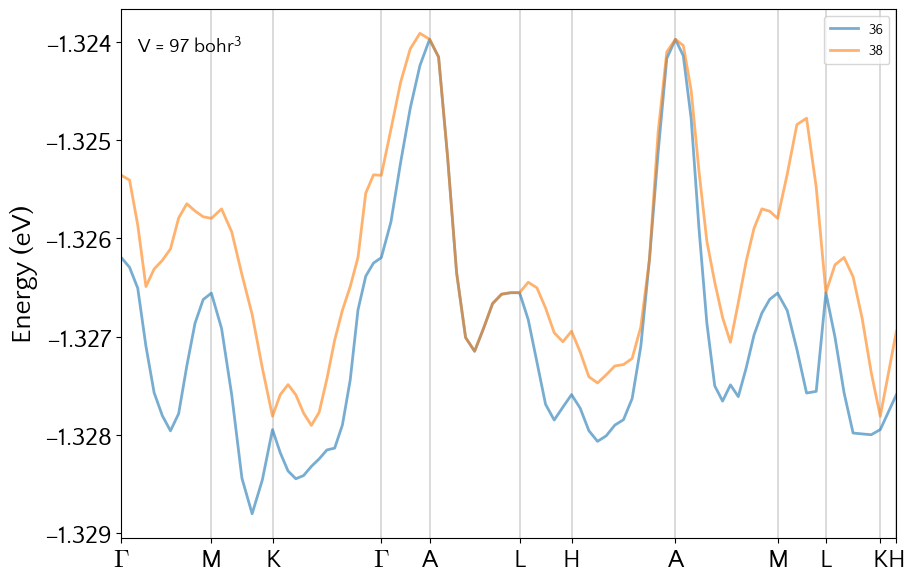

Substituting with a symbol from Computer Modern.


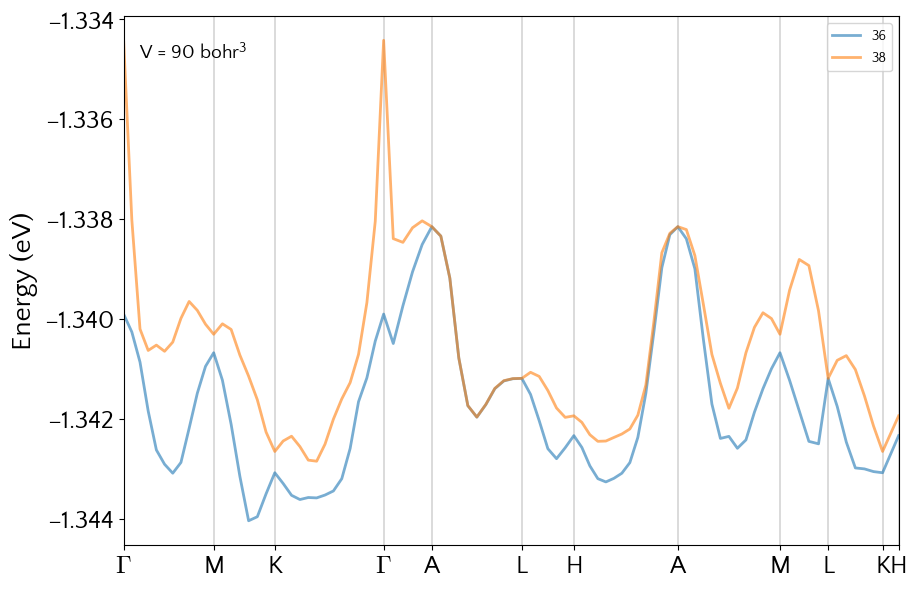

In [23]:
from matplotlib.colors import to_rgba_array, to_rgb
import numpy as np
import matplotlib.pyplot as plt
import imageio

def plot_bands_volume(volume, bands):
    
    lista_bandas_completa, vertice_coords, vertice_labels = read_bands_Ldiff(volume)
    
    
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    efermi = 0.0
    ymin = -3.2
    ymax = 1.4
    
    fig = plt.figure(figsize=(10,7), dpi=100)
    ax1 = fig.add_subplot()
    
    #get x limits from data
    xmin,xmax = lista_bandas_completa[0]['distance'][0],lista_bandas_completa[0]['distance'][-1]
    
    #bandas a serem plotadas
    lista_bandas = []
    for i in bands:
        lista_bandas.append(lista_bandas_completa[i])
    
    ##### Diferenciando L
    #draw curves
    l_resolved=False
    if l_resolved:
        for banda in lista_bandas:
            alpha_geral = 0.1
            multiplier = 0.01
            ax1.plot(banda['distance'], banda['energy'], color='k', lw=0.1, alpha=0.5)
            orbitals = ['s', 'p', 'd', 'f']
            colors = ['C0', 'C1', 'C3', 'C2', 'C4']
            for i in range(len(orbitals)):
                l = ax1.fill_between(banda['distance'],
                                      banda['energy']+multiplier*banda[orbitals[i]],
                                      banda['energy']-multiplier*banda[orbitals[i]],
                                      color=colors[i], alpha = alpha_geral, lw=0.0)
        
        for i in range(len(orbitals)):
                l = ax1.fill_between([-1], [1],[0], color=colors[i], alpha = 0.5, label=orbitals[i])
        ax1.legend(loc='upper right', ncol=2)
        ymin, ymax = ax1.get_ylim()
    else: #SEM DIFERENCA ENTRE L
        for n, banda in enumerate(lista_bandas):
            ax1.plot(banda['distance'], banda['energy'], lw=2.0, alpha=0.6, label = bands[n])
        ymin, ymax = ax1.get_ylim()
        ax1.legend()
    ################################
    #get y limits for later
    #ymin,ymax = plt.ylim()
    #ymin, ymax = -2.95, -2.92
    
    
    #draw fermi level
    ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    ax1.annotate('V = {0} bohr$^3$\n'.format(volume), 
                 xycoords = 'axes fraction', xy=(0.02, 0.95),
                 fontsize=14,
                 horizontalalignment='left',
                 verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (eV)')
    
    #set positions and labels of x axis
    plt.xticks(vertice_coords, labels = vertice_labels)
    #plt.savefig('bandstructure_{0}.pdf'.format(volume))
    #plt.show()
    
    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    return image
    
Volumes = [225, 211, 198, 171, 157, 144, 130, 117, 97, 90]
imageio.mimsave('./cruzamento_de_bandas/bands_crossing_36_38.gif', [plot_bands_volume(i,[36,38]) for i in Volumes], fps=0.7)


# Volume 90, comparação de mais estados vazios

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


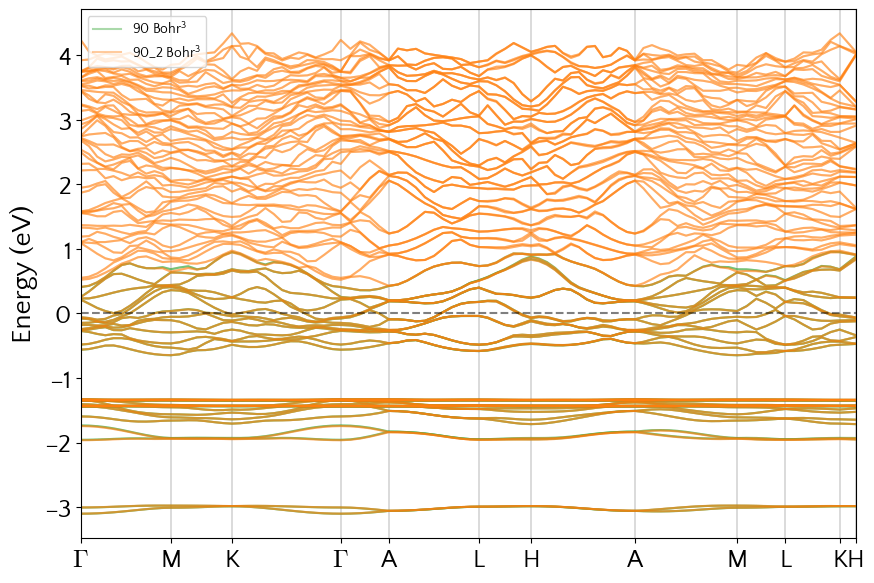

In [24]:
vs = [90,'90_2']

from matplotlib.colors import to_rgba_array, to_rgb

if True:    
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    efermi = 0.0
    
    fig = plt.figure(figsize=(10,7), dpi=100)
    ax1 = fig.add_subplot()
    
    #All the curves have to use the same x vector for us to be able to compare them.
    #The increase in pressure expands the 1rst brillouin and alters the location points, which are 
    #given in reciprocal lenght units. Using the same x vector for all the curves is equivalent to
    #use inverse cristallographic coordinates, which would be iinvariant under the change in volume of 
    #the 1BZ
    colors = ['C2','C1', 'C2', 'C2', 'C4']
    
    lista_bandas, vertice_coords, vertice_labels = read_bands_Ldiff(vs[0])
    common_x_vector = lista_bandas[0]['distance']
    #get x limits from data
    xmin,xmax = lista_bandas[0]['distance'][0],lista_bandas[0]['distance'][-1]
    
    
    for n,volume in enumerate(vs):
        lista_bandas, vertice_coords_dump, vertice_labels_dump = read_bands_Ldiff(volume) #we dont need to store the vertices coordinates
        #draw curves
        for banda in lista_bandas:
            l = ax1.plot(banda['distance'], banda['energy'], color = colors[n], lw=1.5, alpha=0.4)
        l[0].set_label('{0} Bohr$^3$'.format(volume))
                
    ################################
    #get y limits for later
    ymin,ymax = plt.ylim()
    #ymin, ymax = -0.7, 1.0
    
    
    #draw fermi level
    ax1.plot([xmin,xmax],[efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    #ax1.annotate('V = {0} bohr$^3$\n'.format(volume), 
    #             xycoords = 'axes fraction', xy=(0.02, 0.95),
    #             fontsize=14,
    #             horizontalalignment='left',
    #             verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(vertice_coords, ymin, ymax, color='k', linewidth = 0.2)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (eV)')
    ax1.legend()
    
    #set positions and labels of x axis
    plt.xticks(vertice_coords, labels = vertice_labels)
    plt.savefig('bandstructure_nempty.pdf'.format(volume))
    plt.show()

# Função para gráfico de bandas

In [9]:
def plot_bands(volume):
    #import files
    arquivo = './dos/Re_{0}_bandstructure.agr'.format(volume)
    with open(arquivo,'r') as f:
        lines = f.readlines()
    
    with open('./dos/EFERMI_{0}.OUT.1'.format(volume), 'r') as f:
        efermi = float(f.readlines()[0])
    
    # get data from files
    bands = []
    acquiring_curve = False
    labels_points = []
    labels_coords = []
    
    for n, line in enumerate(lines):
        #get symmetry points labels and x coords
        if ('@     xaxis  tick major' in line) and (',' in line):
            labels_coords.append(float(line.split()[-1]))
            string = lines[n+1].split()[-1].strip('"').rstrip('"')
            if string == '\\xG\\f{}':
                string = '$\Gamma$'
            labels_points.append(string)
        
        #get curves
        if '@type xy' in lines[n-1]:
            acquiring_curve = True
            curve = []
            
        if '&'in line:
            acquiring_curve = False
            bands.append(curve)
            
            
        if acquiring_curve:
            curve.append([float(x) for x in line.split()])
    
    npbands = np.array(bands)
    npbands[:,:,1] = npbands[:,:,1]/27.2114
    
    
    #plot
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    fig = plt.figure(figsize=(10,7), dpi=100)
    ax1 = fig.add_subplot()
    
    #get x limits from data
    xmin,xmax = npbands[0,0,0],npbands[0,-1,0]
    
    #draw curves
    for i in range(np.shape(npbands)[0]):
        ax1.plot(npbands[i,:,0], npbands[i,:,1], color='C2')
    
    #get y limits for later
    ymin,ymax = plt.ylim()
    
    #draw fermi level
    ax1.plot([efermi,efermi],[ymin,ymax], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    ax1.annotate('V = {0} bohr$^3$\nE$_F$ = {1}'.format(volume,efermi), 
                 xycoords = 'axes fraction', xy=(0.02, 0.95),
                 fontsize=14,
                 horizontalalignment='left',
                 verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(labels_coords, ymin, ymax, color='k', linewidth = 0.5)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (eV)')
    
    #set positions and labels of x axis
    plt.xticks(labels_coords, labels = labels_points)
    
    #plt.savefig(arquivo.split('.')[0]+'.pdf')
    plt.show()

# GIF

In [10]:
import imageio

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


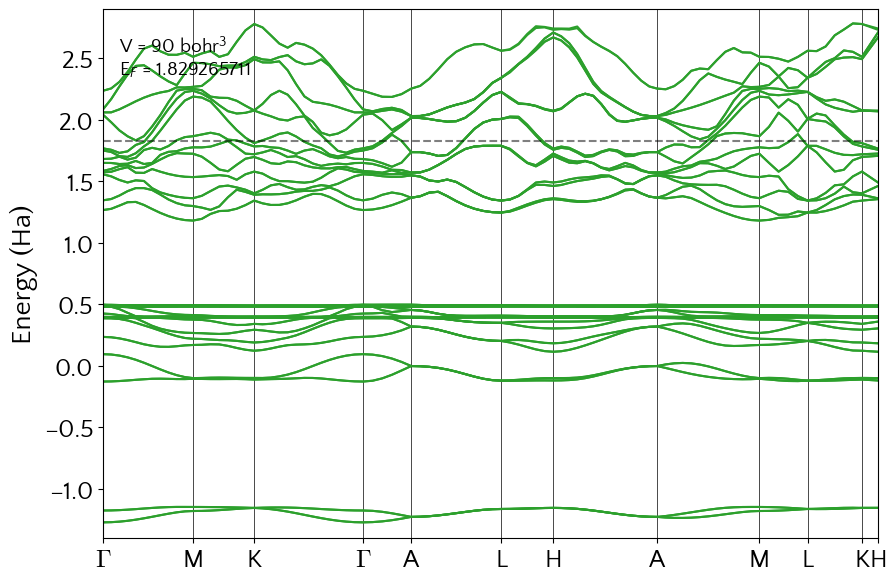

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


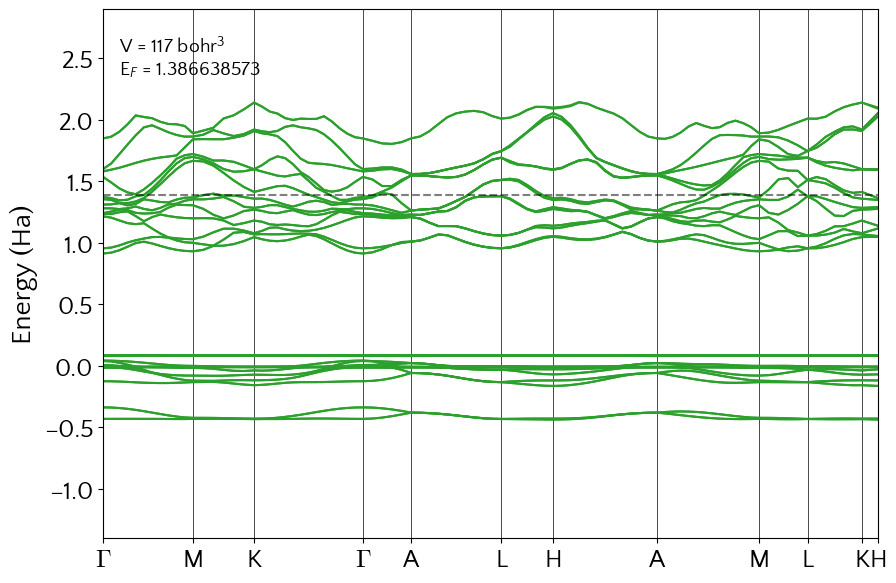

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


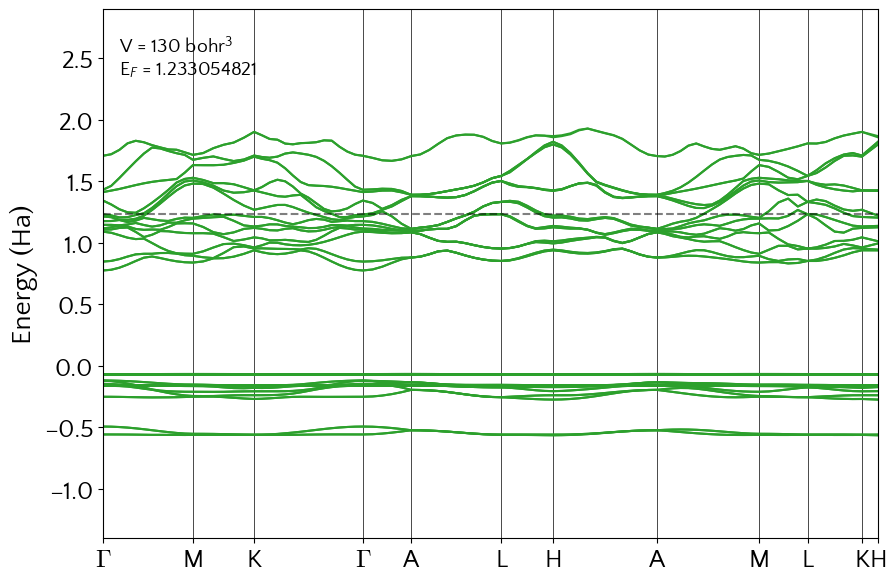

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


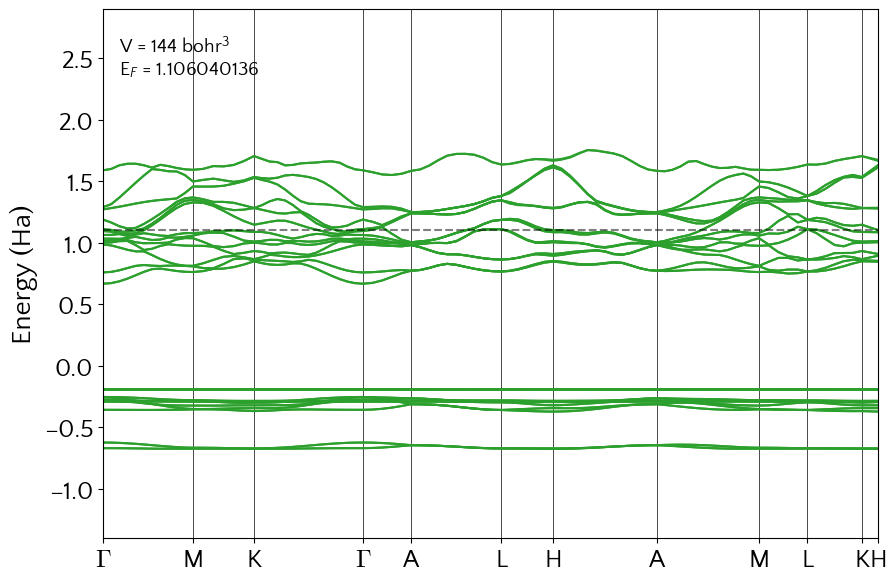

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


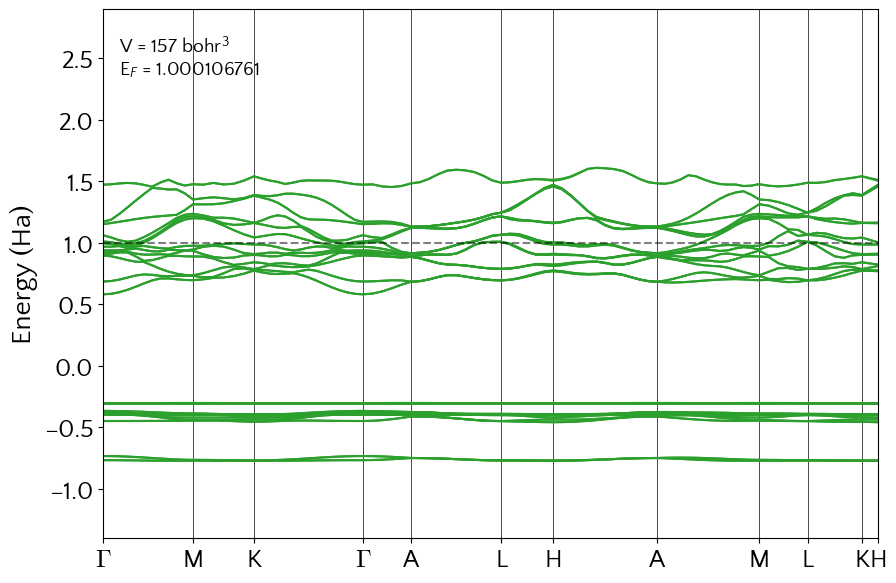

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


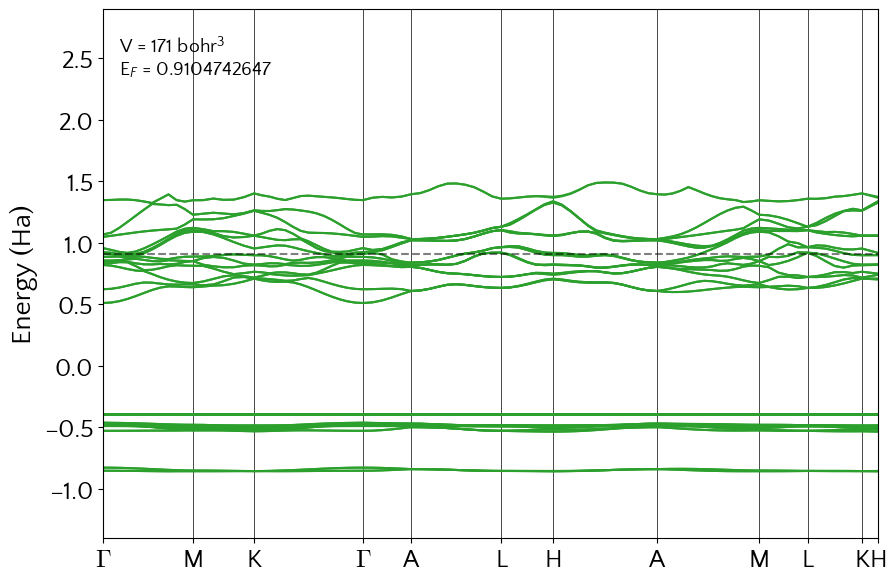

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


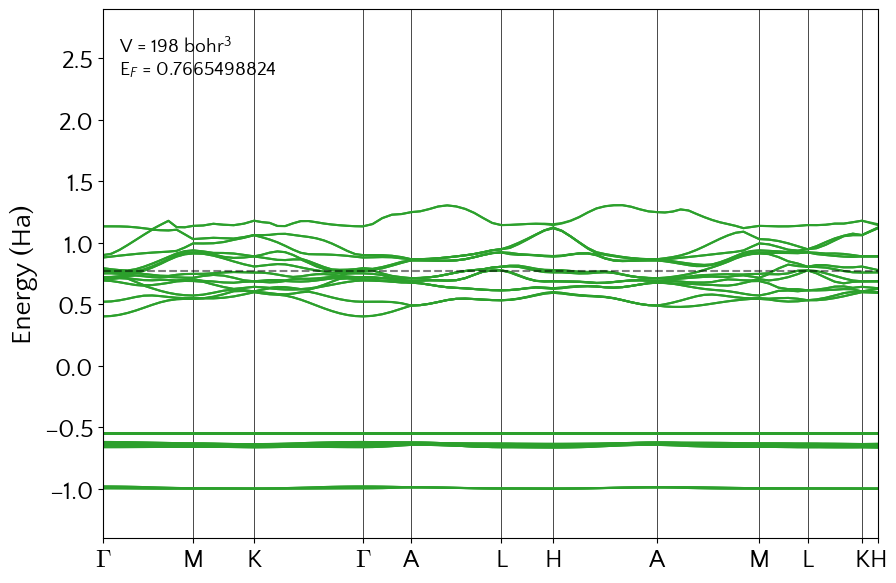

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


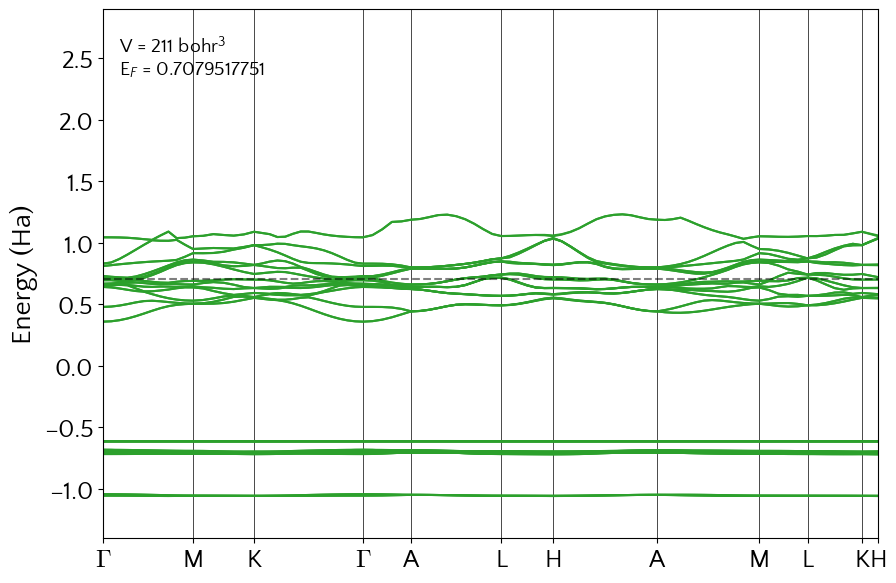

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


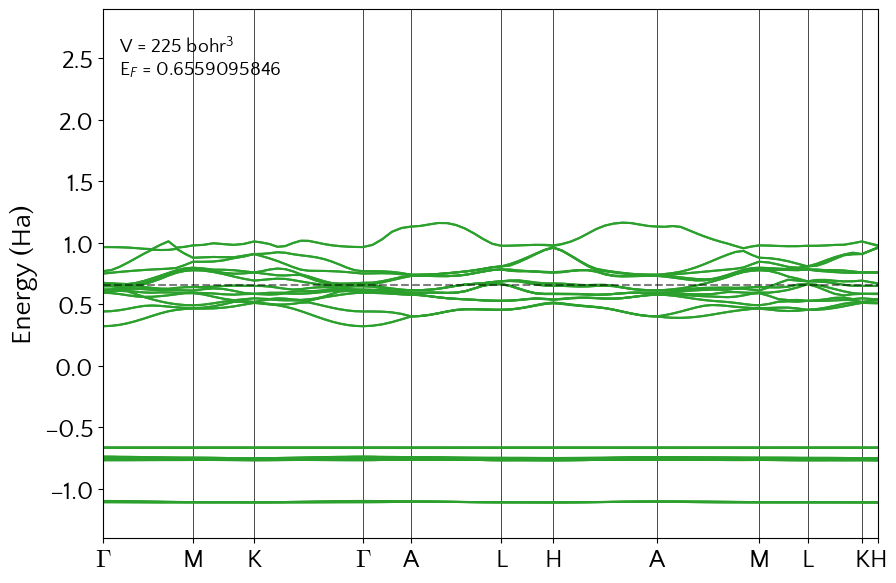

In [70]:
def plot_bands_gif(volume):
    #import files
    arquivo = './dos/Re_{0}_bandstructure.agr'.format(volume)
    with open(arquivo,'r') as f:
        lines = f.readlines()
    
    with open('./dos/EFERMI_{0}.OUT.1'.format(volume), 'r') as f:
        efermi = float(f.readlines()[0])
    
    # get data from files
    bands = []
    acquiring_curve = False
    labels_points = []
    labels_coords = []
    
    for n, line in enumerate(lines):
        #get symmetry points labels and x coords
        if ('@     xaxis  tick major' in line) and (',' in line):
            labels_coords.append(float(line.split()[-1]))
            string = lines[n+1].split()[-1].strip('"').rstrip('"')
            if string == '\\xG\\f{}':
                string = '$\Gamma$'
            labels_points.append(string)
        
        #get curves
        if '@type xy' in lines[n-1]:
            acquiring_curve = True
            curve = []
            
        if '&'in line:
            acquiring_curve = False
            bands.append(curve)
            
            
        if acquiring_curve:
            curve.append([float(x) for x in line.split()])
    
    npbands = np.array(bands)
    npbands[:,:,1] = npbands[:,:,1]/27.2114 #convert eV to Ha
    
    #plot
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    fig = plt.figure(figsize=(10,7), dpi=100)
    ax1 = fig.add_subplot()
    
    #get x limits from data
    xmin,xmax = npbands[0,0,0],npbands[0,-1,0]
    
    #draw curves
    for i in range(np.shape(npbands)[0]):
        ax1.plot(npbands[i,:,0], npbands[i,:,1], color='C2')
    
    #get y limits for later
    #ymin,ymax = plt.ylim()
    ymin, ymax = -1.4,2.9
    
    #draw fermi level
    ax1.plot([xmin,xmax], [efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    ax1.annotate('V = {0} bohr$^3$\nE$_F$ = {1}'.format(volume,efermi), 
                 xycoords = 'axes fraction', xy=(0.02, 0.95),
                 fontsize=14,
                 horizontalalignment='left',
                 verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(labels_coords, ymin, ymax, color='k', linewidth = 0.5)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (Ha)')
    
    #set positions and labels of x axis
    plt.xticks(labels_coords, labels = labels_points)
    
    plt.savefig(arquivo.split('/')[-1].split('.')[0]+'.pdf')
    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    return image
    
kwargs_write = {'fps':1.0, 'quantizer':'nq'}

Volumes = [90,117,130,144,157,171,198,211,225]
imageio.mimsave('./bands.gif', [plot_bands_gif(i) for i in Volumes], fps=1)

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


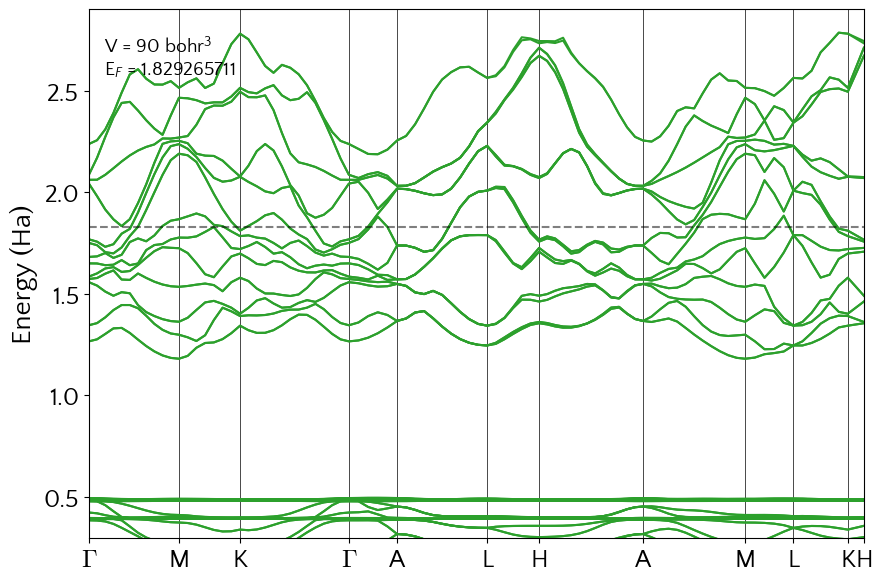

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


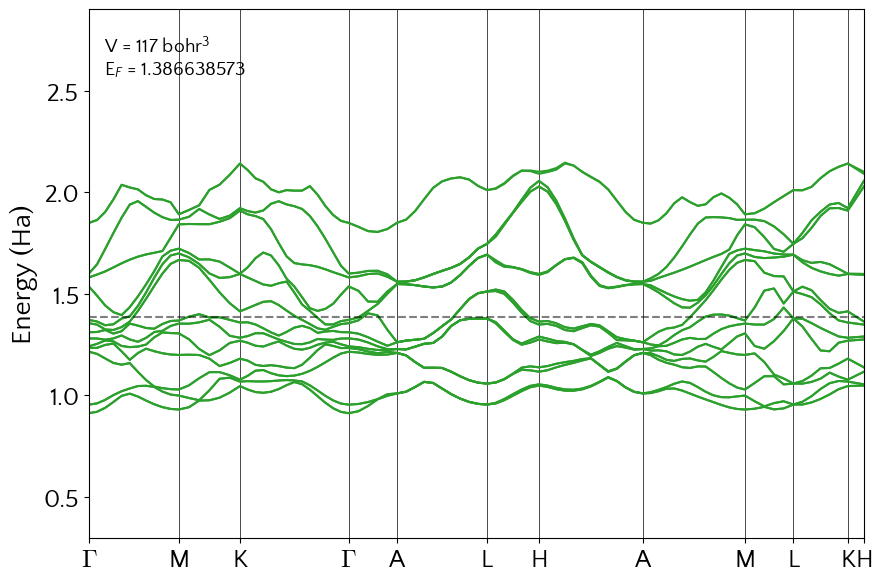

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


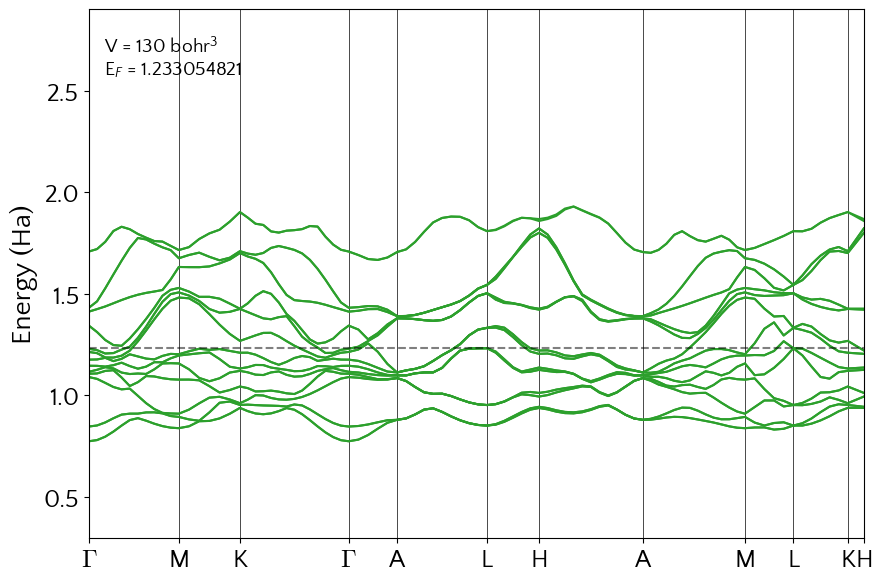

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


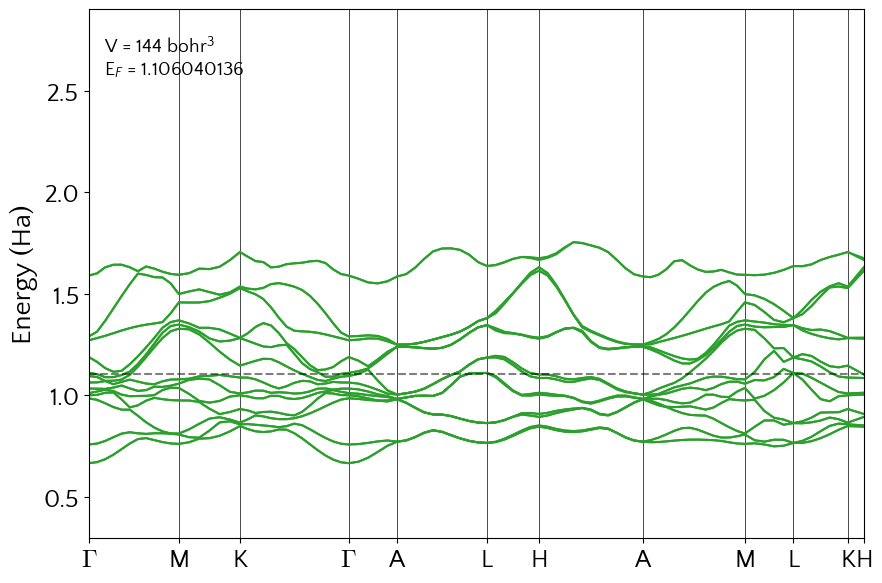

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


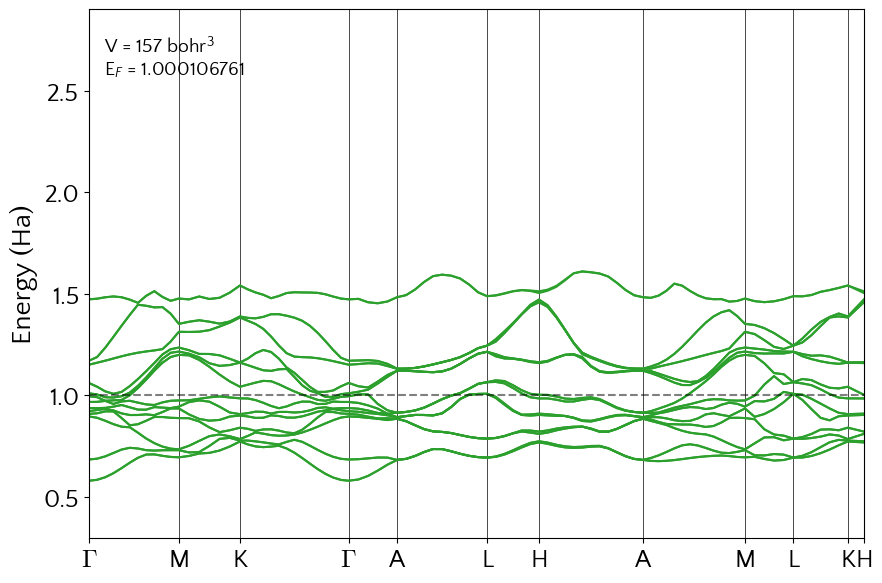

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


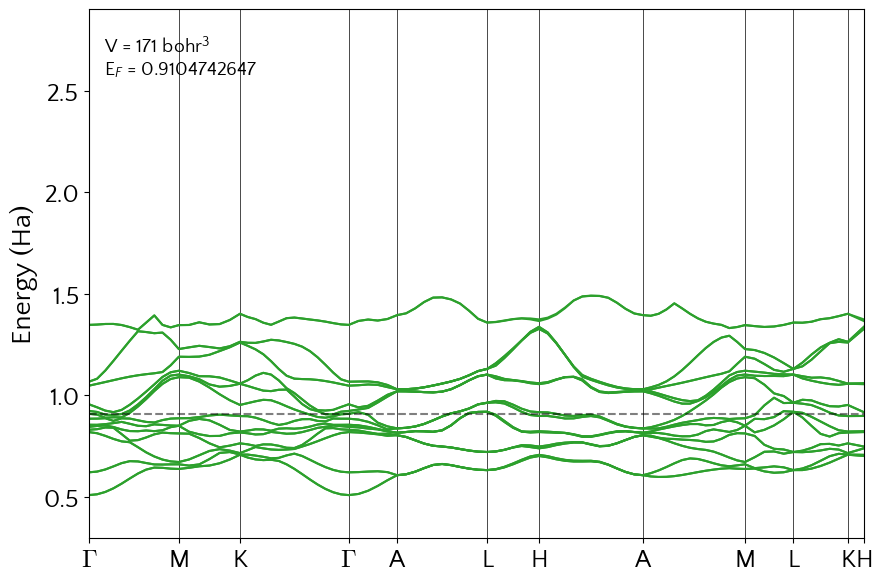

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


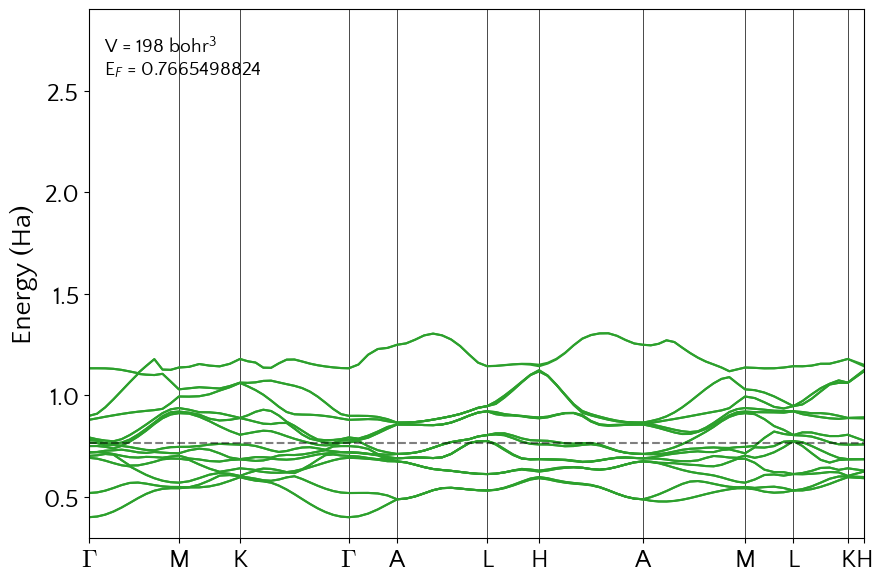

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


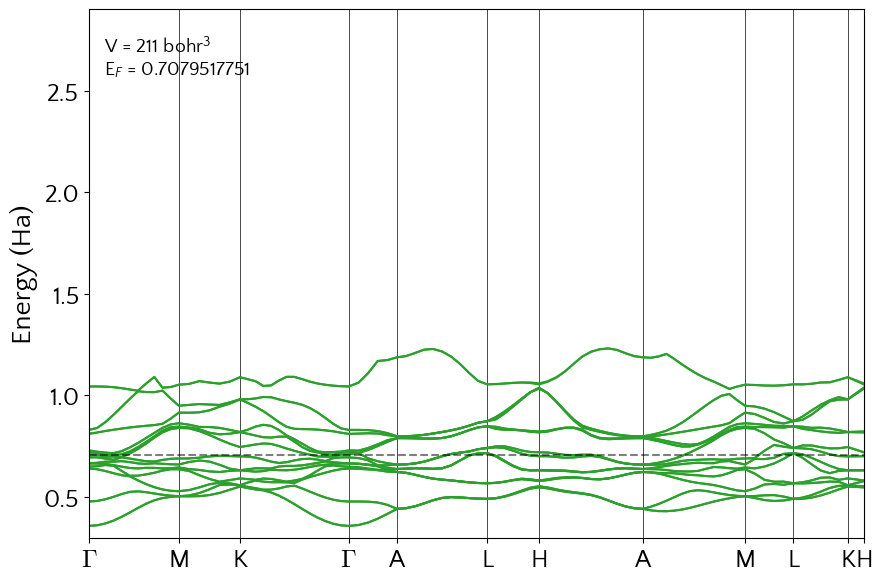

Substituting with a symbol from Computer Modern.
Substituting with a symbol from Computer Modern.


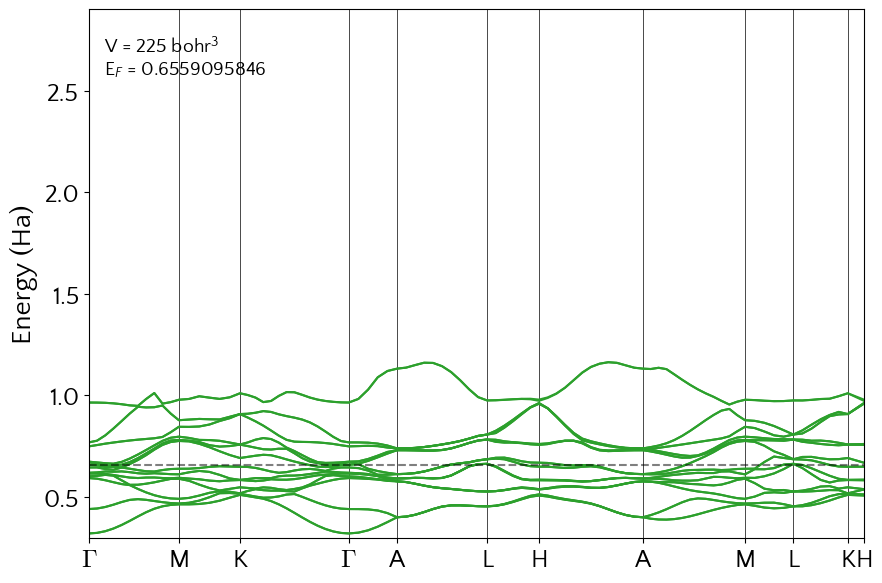

In [68]:
def plot_bands_gif(volume):
    #import files
    arquivo = './dos/Re_{0}_bandstructure.agr'.format(volume)
    with open(arquivo,'r') as f:
        lines = f.readlines()
    
    with open('./dos/EFERMI_{0}.OUT.1'.format(volume), 'r') as f:
        efermi = float(f.readlines()[0])
    
    # get data from files
    bands = []
    acquiring_curve = False
    labels_points = []
    labels_coords = []
    
    for n, line in enumerate(lines):
        #get symmetry points labels and x coords
        if ('@     xaxis  tick major' in line) and (',' in line):
            labels_coords.append(float(line.split()[-1]))
            string = lines[n+1].split()[-1].strip('"').rstrip('"')
            if string == '\\xG\\f{}':
                string = '$\Gamma$'
            labels_points.append(string)
        
        #get curves
        if '@type xy' in lines[n-1]:
            acquiring_curve = True
            curve = []
            
        if '&'in line:
            acquiring_curve = False
            bands.append(curve)
            
            
        if acquiring_curve:
            curve.append([float(x) for x in line.split()])
    
    npbands = np.array(bands)
    npbands[:,:,1] = npbands[:,:,1]/27.2114 #convert eV to Ha
    
    
    #plot
    plt.rc('font', family='QuattroCento Sans')
    plt.rc('xtick', labelsize=18)
    plt.rc('ytick', labelsize=18)
    plt.rc('axes', labelsize=20)
    plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )
    
    fig = plt.figure(figsize=(10,7), dpi=100)
    ax1 = fig.add_subplot()
    
    #get x limits from data
    xmin,xmax = npbands[0,0,0],npbands[0,-1,0]
    
    #draw curves
    for i in range(np.shape(npbands)[0]):
        ax1.plot(npbands[i,:,0], npbands[i,:,1], color='C2')
    
    #get y limits for later
    #ymin,ymax = plt.ylim()
    ymin, ymax = 0.3, 2.9
    
    #draw fermi level
    ax1.plot([xmin,xmax], [efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    ax1.annotate('V = {0} bohr$^3$\nE$_F$ = {1}'.format(volume,efermi), 
                 xycoords = 'axes fraction', xy=(0.02, 0.95),
                 fontsize=14,
                 horizontalalignment='left',
                 verticalalignment='top')
    
    #draw high symmetry lines
    ax1.vlines(labels_coords, ymin, ymax, color='k', linewidth = 0.5)
    
    #adjust limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    ax1.set_ylabel('Energy (Ha)')
    
    #set positions and labels of x axis
    plt.xticks(labels_coords, labels = labels_points)
    
    plt.savefig(arquivo.split('/')[-1].split('.')[0]+'_f.pdf')
    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    return image
    
kwargs_write = {'fps':1.0, 'quantizer':'nq'}

Volumes = [90,117,130,144,157,171,198,211,225]
imageio.mimsave('./bands_f.gif', [plot_bands_gif(i) for i in Volumes], fps=1)

# Sobrepostos

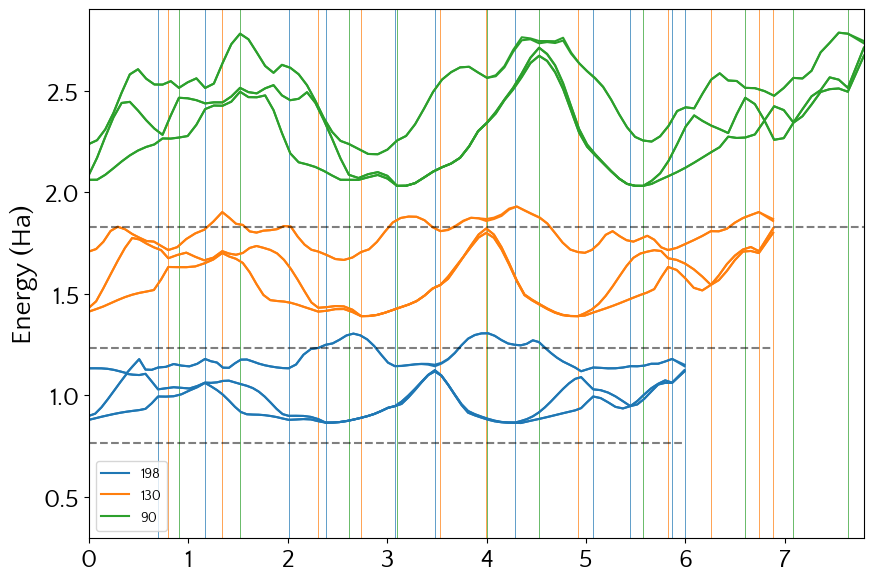

In [65]:
plt.rc('font', family='QuattroCento Sans')
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)
plt.rc('axes', labelsize=20)
plt.rc('mathtext', rm='Quattrocento Sans',it='Quattrocento Sans:italic', bf='Quattrocento Sans:bold', fontset='custom' )

fig = plt.figure(figsize=(10,7), dpi=100)
ax1 = fig.add_subplot()

V = [198, 130, 90]
line_handles = []
for j in range(len(V)):
    volume = V[j]
    #import files
    arquivo = './dos/Re_{0}_bandstructure.agr'.format(volume)
    with open(arquivo,'r') as f:
        lines = f.readlines()
    
    with open('./dos/EFERMI_{0}.OUT.1'.format(volume), 'r') as f:
        efermi = float(f.readlines()[0])
    
    # get data from files
    bands = []
    acquiring_curve = False
    labels_points = []
    labels_coords = []
    
    for n, line in enumerate(lines):
        #get symmetry points labels and x coords
        if ('@     xaxis  tick major' in line) and (',' in line):
            labels_coords.append(float(line.split()[-1]))
            string = lines[n+1].split()[-1].strip('"').rstrip('"')
            if string == '\\xG\\f{}':
                string = '$\Gamma$'
            labels_points.append(string)
        
        #get curves
        if '@type xy' in lines[n-1]:
            acquiring_curve = True
            curve = []
            
        if '&'in line:
            acquiring_curve = False
            bands.append(curve)
            
            
        if acquiring_curve:
            curve.append([float(x) for x in line.split()])
    
    npbands = np.array(bands)
    npbands[:,:,1] = npbands[:,:,1]/27.2114 #convert eV to Ha
    
    
    #plot
    
    #get x limits from data
    xmin,xmax = npbands[0,0,0],npbands[0,-1,0]
    
    #draw curves
    #for i in range(np.shape(npbands)[0]):
    for i in [-1, -2, -3, -4, -5, -6]:
        l, = ax1.plot(npbands[i,:,0], npbands[i,:,1], color='C'+str(j))
    line_handles.append(l)
    
    #get y limits for later
    #ymin,ymax = plt.ylim()
    ymin, ymax = 0.3, 2.9
    
    #draw fermi level
    ax1.plot([xmin,xmax], [efermi,efermi], color='k', alpha = 0.5, linestyle = '--')
    #ax1.annotate('E$_\mathrm{F}$', xy = (0,ymax-4), fontsize=20)
    #ax1.annotate('V = {0} bohr$^3$\nE$_F$ = {1}'.format(volume,efermi), 
    #             xycoords = 'axes fraction', xy=(0.02, 0.95),
    #             fontsize=14,
    #             horizontalalignment='left',
    #             verticalalignment='top')
    #draw high symmetry lines
    ax1.vlines(labels_coords, ymin, ymax, color='C'+str(j), linewidth = 0.5)


#adjust limits
ax1.set_xlim(xx[0], xx[-1])
ax1.set_ylim(ymin, ymax)
ax1.set_ylabel('Energy (Ha)')

#set positions and labels of x axis
#plt.xticks(labels_coords, labels = labels_points)
plt.legend(line_handles, ['198', '130', '90'])
plt.savefig('bandas_shrinkage.pdf')
plt.show()

    

In [61]:
line_handles

In [51]:
xx = npbands[-1,:,0]
print(xx)

[0.         0.08235635 0.16471269 0.24706904 0.32942539 0.41178174
 0.49413808 0.57649443 0.65885078 0.74120712 0.82356347 0.90591982
 0.90591982 0.99374969 1.08157956 1.16940943 1.25723931 1.34506918
 1.43289905 1.52072892 1.52072892 1.60494761 1.68916629 1.77338497
 1.85760366 1.94182234 2.02604103 2.11025971 2.19447839 2.27869708
 2.36291576 2.44713444 2.53135313 2.61557181 2.61557181 2.71251715
 2.8094625  2.90640784 3.00335318 3.10029853 3.10029853 3.19089051
 3.28148249 3.37207447 3.46266645 3.55325844 3.64385042 3.7344424
 3.82503438 3.91562636 4.00621834 4.00621834 4.09339052 4.18056269
 4.26773487 4.35490705 4.44207922 4.5292514  4.5292514  4.60971802
 4.69018464 4.77065126 4.85111789 4.93158451 5.01205114 5.09251776
 5.17298438 5.253451   5.33391763 5.41438425 5.49485087 5.5753175
 5.5753175  5.66093822 5.74655894 5.83217966 5.91780038 6.0034211
 6.08904182 6.17466254 6.26028326 6.34590398 6.4315247  6.51714542
 6.60276614 6.60276614 6.69971148 6.79665682 6.89360216 6.9905475